In [9]:
import os

from dtscalibration import read_silixa_files
import matplotlib.pyplot as plt
import warnings

from dtscalibration import read_silixa_files

from dtscalibration.datastore_utils import suggest_cable_shift_double_ended, shift_double_ended
import numpy as np
import scipy.stats as st 
from scipy import signal
import scipy

import glob
%matplotlib notebook


warnings.simplefilter("ignore")  # Hide warnings to avoid clutter in the notebook

In [12]:
### List of the file paths to process ###
filepaths = glob.glob('files_sorted/*')
print(filepaths)

['files_sorted/ALHIC1901_23_5min', 'files_sorted/ALHIC1903_23_5min', 'files_sorted/ALHIC1902_23_5min', 'files_sorted/ALHIC2301_23_5min', 'files_sorted/ALHIC2201_23_5min', 'files_sorted/ALHIC1901_23_30min', 'files_sorted/ALHIC1902_23_30min', 'files_sorted/ALHIC1902_23_10sec', 'files_sorted/ALHIC1901_22_30min']


In [4]:
def data_processing(filepath):
    
    ds = read_silixa_files(
        directory=filepath,
        timezone_netcdf='UTC',
        file_ext='*.xml')

    suggested_shift = suggest_cable_shift_double_ended(
        ds,
        np.arange(-10, 10),
        plot_result=True,
        figsize=(12,8))

    ds_restored = shift_double_ended(ds, suggested_shift[0])
    ds = ds_restored

    sections = {
    "referenceTemperature": [slice(-23, -3)], 
    }
    ds.sections = sections
    
#     matching_sections = [
#     (slice(74.8, 104.62), slice(518.95, 548.77), True)
#     ]
    
    st_var, resid = ds.variance_stokes(st_label='st')
    ast_var, _ = ds.variance_stokes(st_label='ast')
    rst_var, _ = ds.variance_stokes(st_label='rst')
    rast_var, _ = ds.variance_stokes(st_label='rast')

    ds.calibration_double_ended(
        st_var=st_var,
        ast_var=ast_var,
        rst_var=rst_var,
        rast_var=rast_var,
        #matching_sections=matching_sections,
        store_tmpw='tmpw',
        method='wls',
        solver='sparse')
    
    return ds

11 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


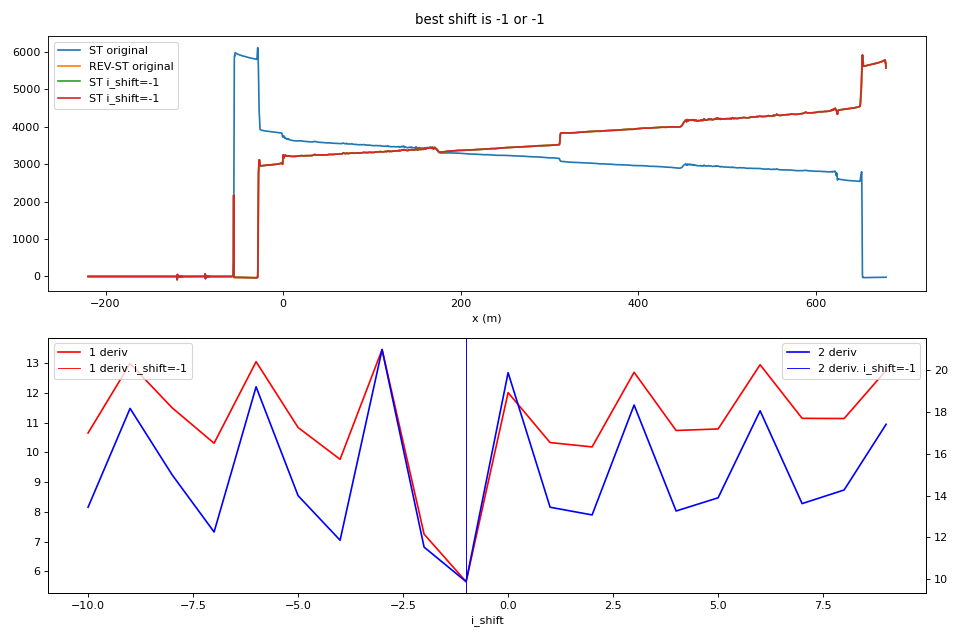

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
31 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


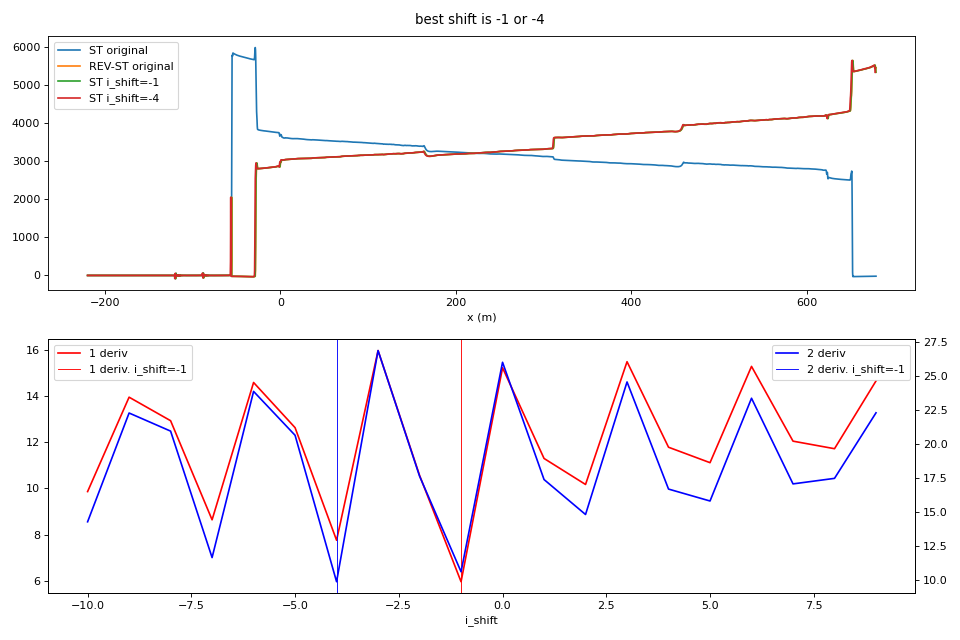

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


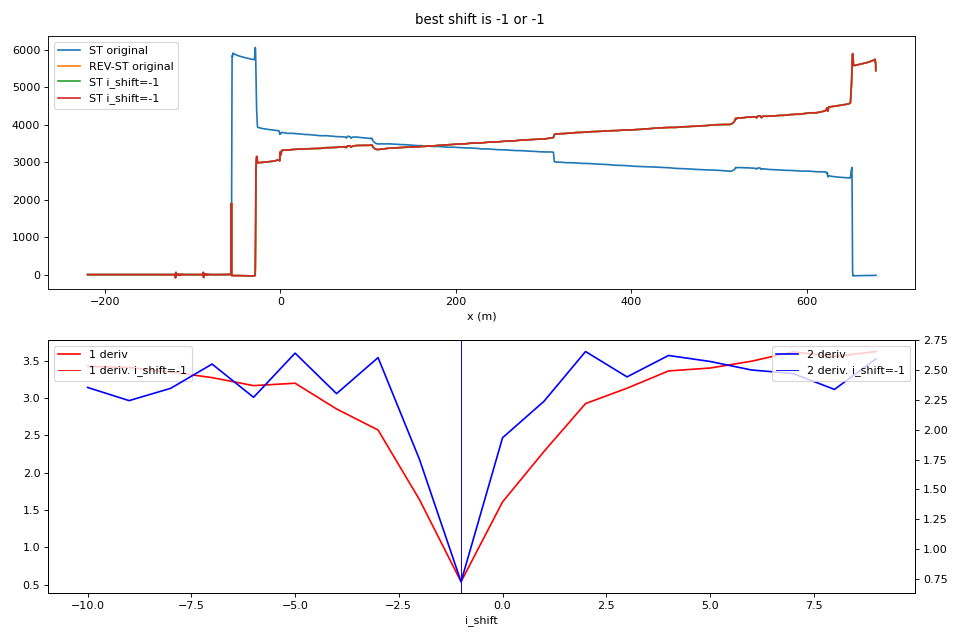

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
13 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


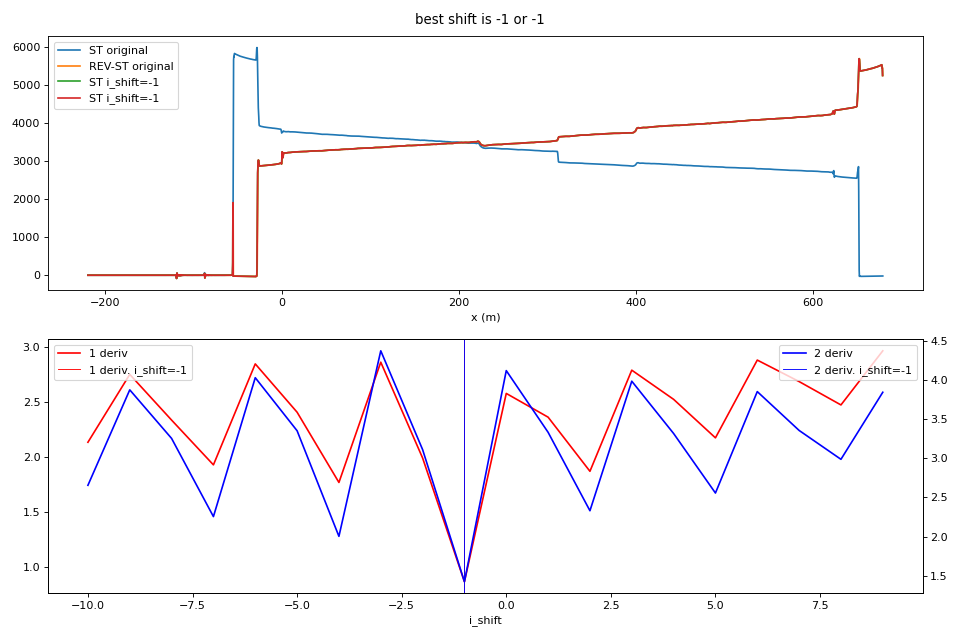

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
2 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


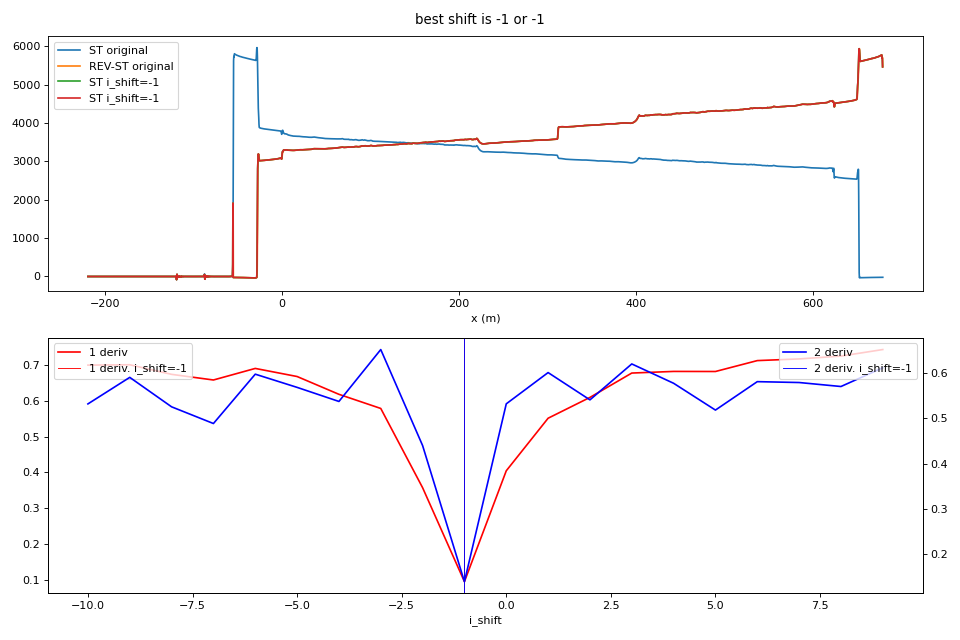

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
1 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


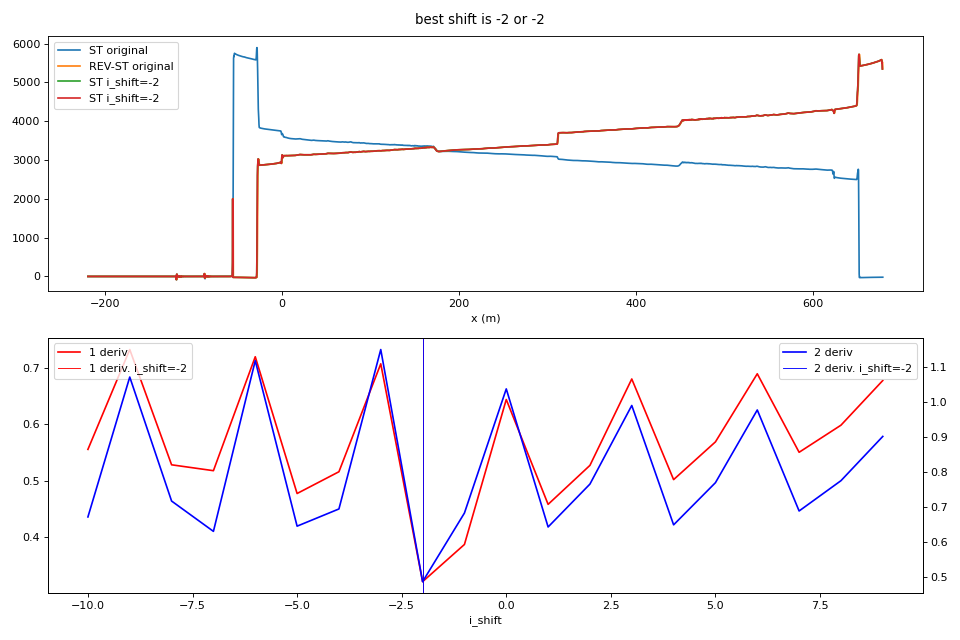

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


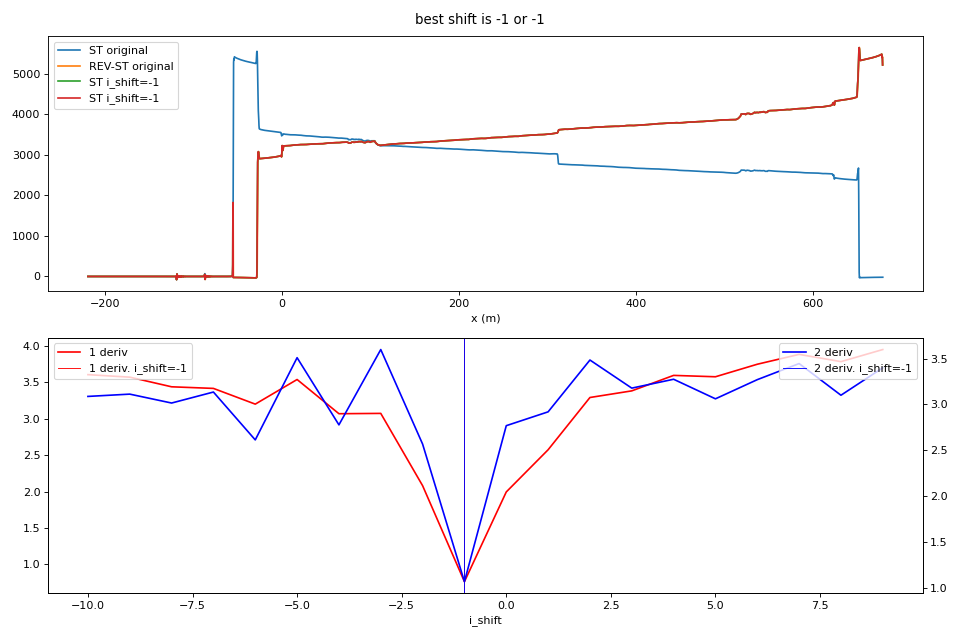

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
78 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


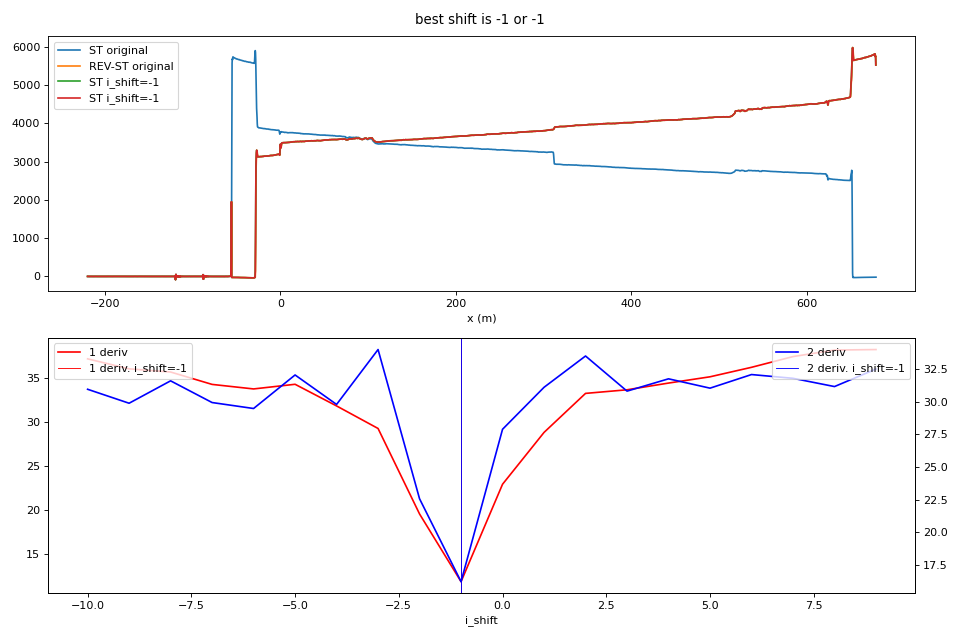

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
3 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3553 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


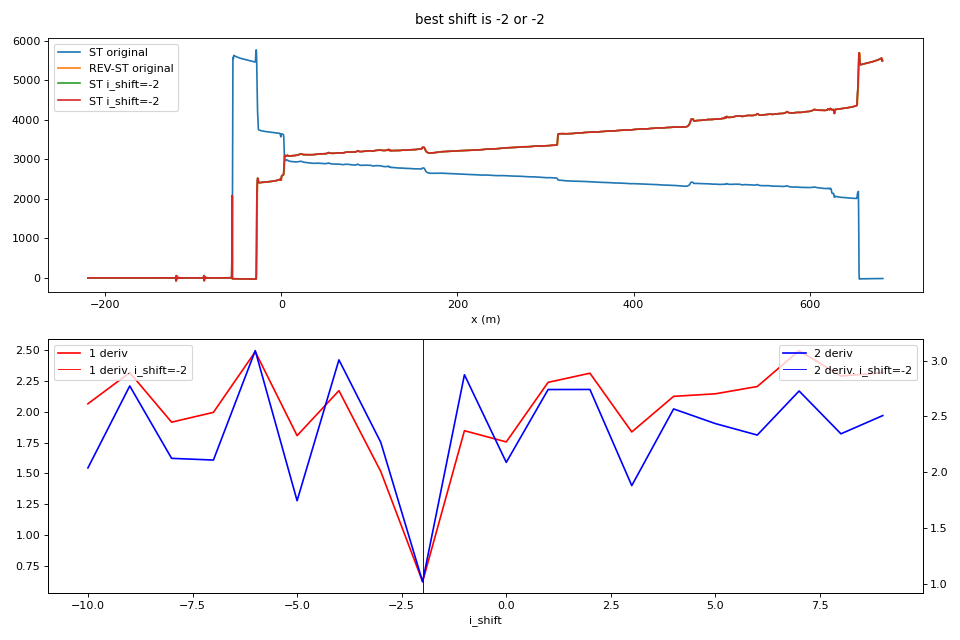

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']


In [16]:
data = {}
for i in filepaths:
    ds = data_processing(i)
    data[i[13:]] = ds



<IPython.core.display.Javascript object>


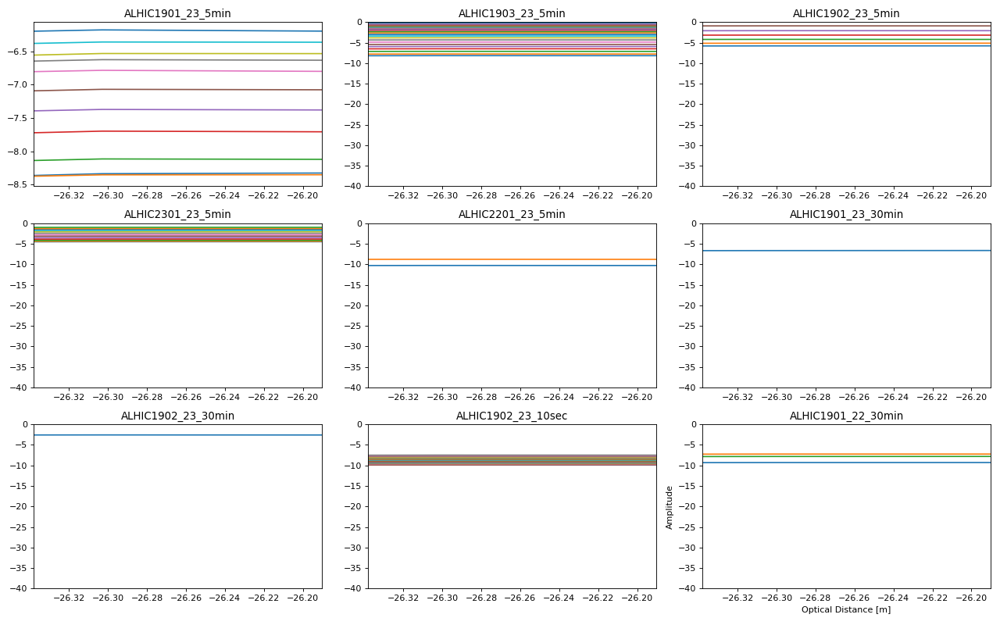

In [248]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data[i].x, data[i].tmpw)
    ax.set_ylim([-40,0])
    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()


In [136]:
borehole_geometries = {
    ## top of borehole, bottom of borehole
    'ALHIC1901_22_30min': [162.05, 313.05],
    'ALHIC1901_23_5min': [170.43, 311.04],
    'ALHIC1903_23_5min': [163.82, 311.04],
    'ALHIC1902_23_5min': [104.07, 311.04],
    'ALHIC2301_23_5min': [220.75, 311.04],
    'ALHIC2201_23_5min': [220.0, 311.04],
    'ALHIC1901_23_30min': [170.93, 311.04], 
    'ALHIC1902_23_30min': [104.30, 311.04], 
    'ALHIC1902_23_10sec': [104.30, 311.04]
}

<IPython.core.display.Javascript object>


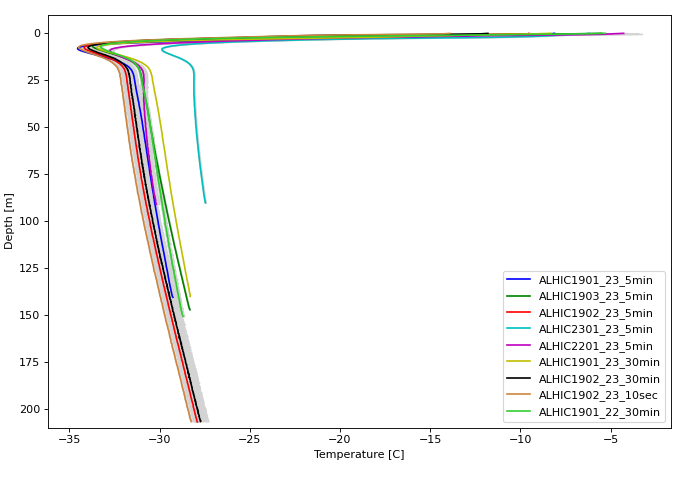

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [58]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = y

        ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


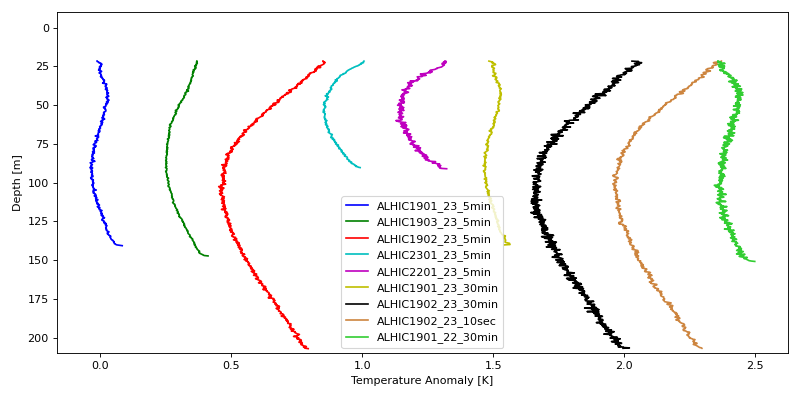

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [57]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .3
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

<IPython.core.display.Javascript object>


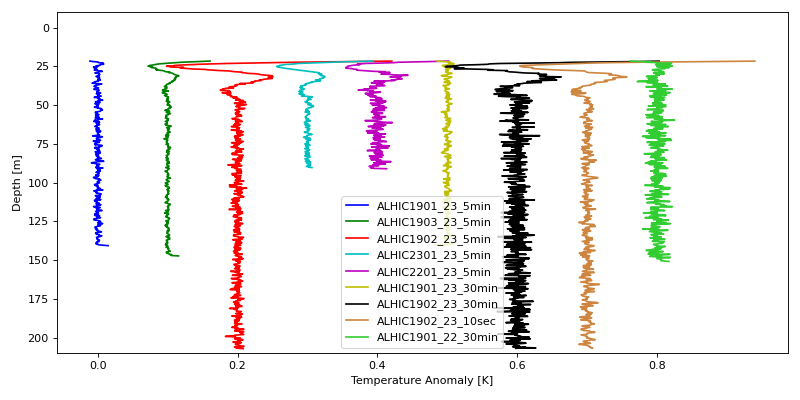

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [56]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered = signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

<IPython.core.display.Javascript object>


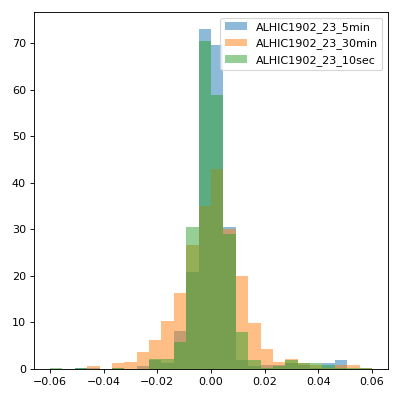

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [66]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(5,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i.startswith('ALHIC1902'):
        mean = np.mean(y, axis=1)

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
#         ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        ax.hist(filtered[20:], 
                density=True, 
                alpha=0.5, 
                label=i,
               bins = np.linspace(-.06,.06, 27))
        

    else:
        continue
plt.legend()
plt.tight_layout()

### Adjust the surface to a reference elevation.

In [71]:
# Surface elevation from Eads QGIS map
reference_elevation = { 

    'ALHIC1901_22_30min': [1936],
    'ALHIC1901_23_5min': [1936],
    'ALHIC1903_23_5min': [1885],
    'ALHIC1902_23_5min': [1941],
    'ALHIC2301_23_5min': [1875],
    'ALHIC2201_23_5min': [1931],
    'ALHIC1901_23_30min': [1936], 
    'ALHIC1902_23_30min': [1941], 
    'ALHIC1902_23_10sec': [1941]
}

<IPython.core.display.Javascript object>


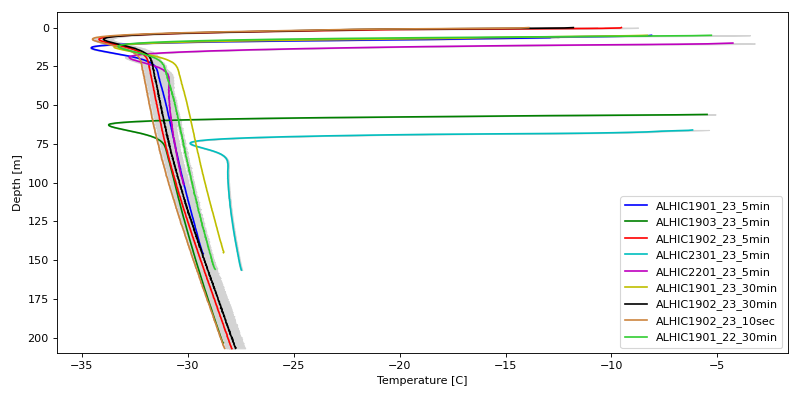

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [73]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0] + (1*(1941 - reference_elevation[i][0]))
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = y

        ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


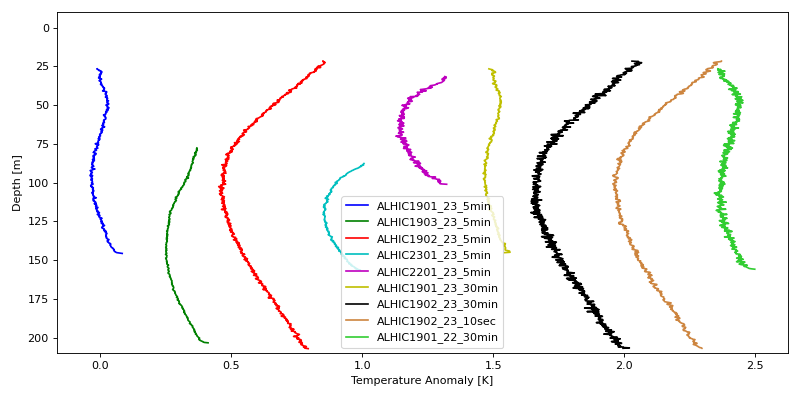

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [74]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .3
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0] + (1*(1941 - reference_elevation[i][0]))
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

<IPython.core.display.Javascript object>


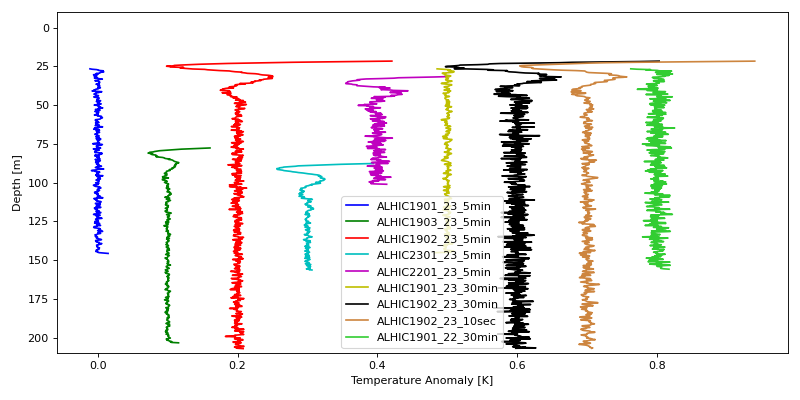

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [75]:
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0] + (1*(1941 - reference_elevation[i][0]))
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered = signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

### How long have we measured each borehole? Maybe the noise is correlated to this.

In [93]:
duration_dict = {}
for i in filepaths:
    files = glob.glob(i+'/*')
    if i[26:] == '5min':
        time = 300 #seconds,, recording time per measurement
    elif i[26:] == '30min':
        time = 1800 #seconds,, recording time per measurement
    elif i[26:] == '10sec':
        time = 10 #seconds,, recording time per measurement
    duration = time * len(files)
    duration_dict[i[13:]] = duration
sorted_dur = sorted(duration_dict.items(), key=lambda item: item[1])
print(sorted_dur)

[('ALHIC2201_23_5min', 600), ('ALHIC1902_23_10sec', 780), ('ALHIC1901_23_30min', 1800), ('ALHIC1902_23_5min', 2100), ('ALHIC1901_23_5min', 3300), ('ALHIC2301_23_5min', 3900), ('ALHIC1901_22_30min', 5400), ('ALHIC1903_23_5min', 9300), ('ALHIC1902_23_30min', 12600)]


In [106]:
for i in sorted_dur:
    print(i[0])

ALHIC2201_23_5min
ALHIC1902_23_10sec
ALHIC1901_23_30min
ALHIC1902_23_5min
ALHIC1901_23_5min
ALHIC2301_23_5min
ALHIC1901_22_30min
ALHIC1903_23_5min
ALHIC1902_23_30min


<IPython.core.display.Javascript object>


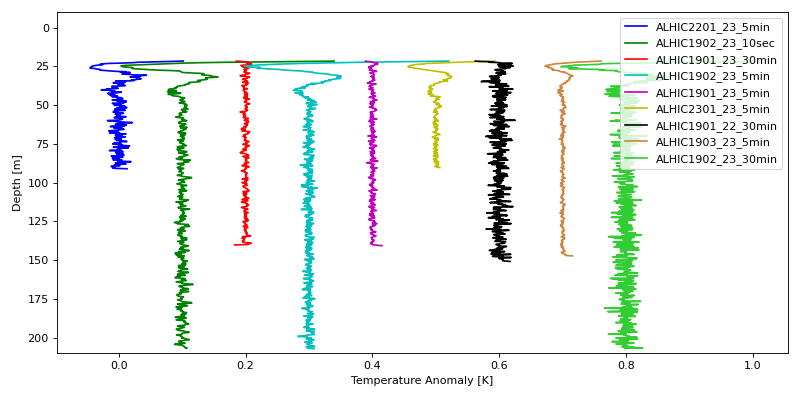

ALHIC2201_23_5min
ALHIC1902_23_10sec
ALHIC1901_23_30min
ALHIC1902_23_5min
ALHIC1901_23_5min
ALHIC2301_23_5min
ALHIC1901_22_30min
ALHIC1903_23_5min
ALHIC1902_23_30min


In [109]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(sorted_dur, colors)):
    print(i[0])
    x = data[i[0]].sel(x=slice(borehole_geometries[i[0]][0],borehole_geometries[i[0]][1])).x - borehole_geometries[i[0]][0]
    y = data[i[0]].sel(x=slice(borehole_geometries[i[0]][0],borehole_geometries[i[0]][1])).tmpw
    if i[0] == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i[0], color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i[0]])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered = signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i[0], color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

### When were these boreholes drilled? Let's sort by this.

In [122]:
sorted(data)

['ALHIC1901_22_30min',
 'ALHIC1901_23_30min',
 'ALHIC1901_23_5min',
 'ALHIC1902_23_10sec',
 'ALHIC1902_23_30min',
 'ALHIC1902_23_5min',
 'ALHIC1903_23_5min',
 'ALHIC2201_23_5min',
 'ALHIC2301_23_5min']

<IPython.core.display.Javascript object>


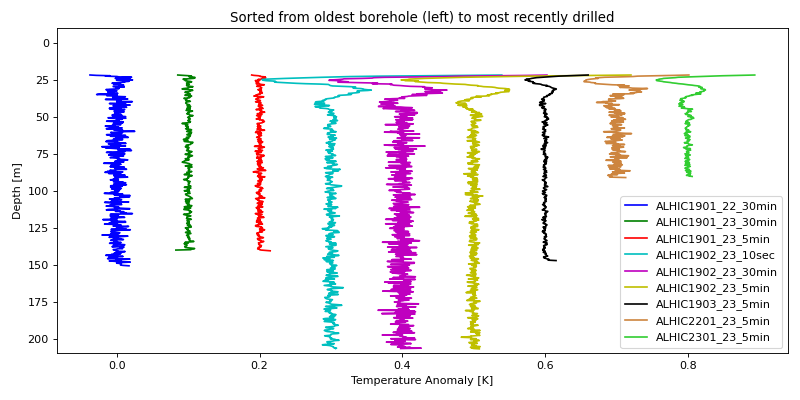

ALHIC1901_22_30min
ALHIC1901_23_30min
ALHIC1901_23_5min
ALHIC1902_23_10sec
ALHIC1902_23_30min
ALHIC1902_23_5min
ALHIC1903_23_5min
ALHIC2201_23_5min
ALHIC2301_23_5min


In [124]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(sorted(data), colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered = signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.title('Sorted from oldest borehole (left) to most recently drilled')
plt.tight_layout()

### What if there is cabling issues? Align by the botton of the u-bend.

In [126]:
## EStimate of the bottom of the cable
bottom_of_cable = {
    'ALHIC1901_22_30min': [313.05],
    'ALHIC1901_23_5min': [311.04],
    'ALHIC1903_23_5min': [311.04],
    'ALHIC1902_23_5min': [311.04],
    'ALHIC2301_23_5min': [311.04],
    'ALHIC2201_23_5min': [311.04],
    'ALHIC1901_23_30min': [311.04], 
    'ALHIC1902_23_30min': [311.04], 
    'ALHIC1902_23_10sec': [311.04]
}

<IPython.core.display.Javascript object>


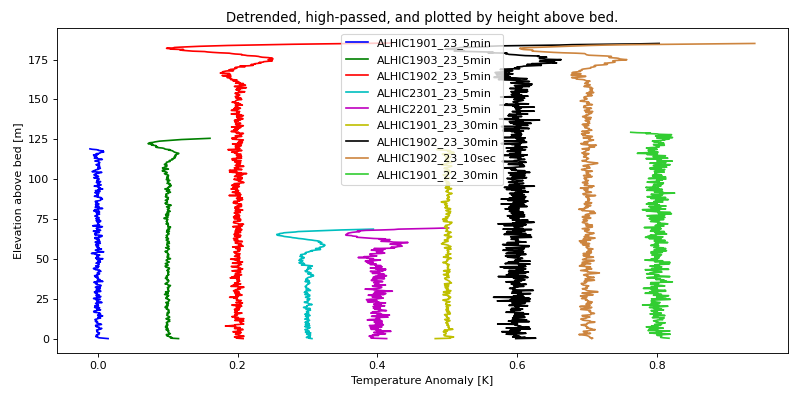

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [131]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .1
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']

sos = signal.butter(4, .06, 'hp', fs=4, output='sos')

fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - bottom_of_cable[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    x = x*-1
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered= signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        filtered = signal.sosfilt(sos, detrend[bp:])
        ax.plot(filtered + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

#plt.ylim([-10,210])
plt.legend()
#plt.gca().invert_yaxis()
plt.ylabel('Elevation above bed [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.title('Detrended, high-passed, and plotted by height above bed.')
plt.tight_layout()

<IPython.core.display.Javascript object>


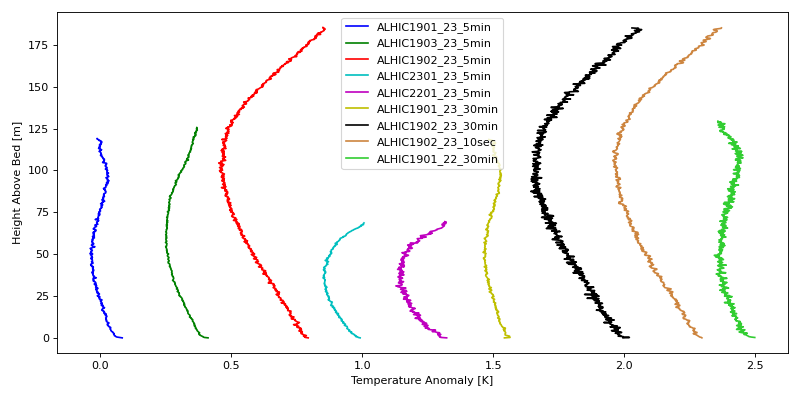

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [135]:
# fig, ax = plt.subplots(figsize=[4,5])
scale_offset = .3
bp=85
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - bottom_of_cable[i][0]
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    x = x*-1
    if i == 'ALHIC1901_23_30min':
        mean = np.asarray(y)
        mean = np.reshape(mean, (1,len(mean)))
        mean = mean[0]

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)

    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        detrend = scipy.signal.detrend(mean, type='linear', bp=bp, overwrite_data=False)
        ax.plot(detrend[bp:] + (off *scale_offset),x[bp:], label=i, color=c)
        #ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        #ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

plt.legend()
plt.ylabel('Height Above Bed [m]')
plt.xlabel('Temperature Anomaly [K]')
plt.tight_layout()

# Can we detrend this in a more intelligent way? Maybe do it like we did last year? What did we do last year?

In [141]:
## EStimate of the bottom of the cable
below_seasonal = {
    ## optical distance below season
    'ALHIC1901_22_30min': [185.05],
    'ALHIC1901_23_5min': [193.43],
    'ALHIC1903_23_5min': [186.82],
    'ALHIC1902_23_5min': [127.07],
    'ALHIC2301_23_5min': [243.75],
    'ALHIC2201_23_5min': [243.0],
    'ALHIC1901_23_30min': [193.93], 
    'ALHIC1902_23_30min': [127.30], 
    'ALHIC1902_23_10sec': [127.30]
}

<IPython.core.display.Javascript object>


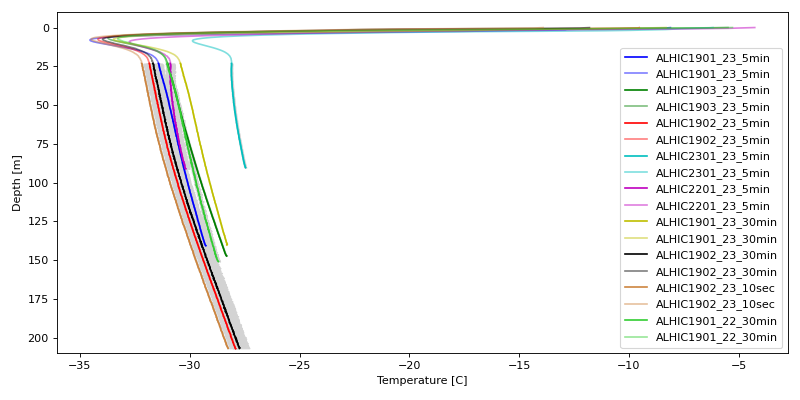

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [143]:
### Plot to visualize the selection process for below seasons ###


scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=(10,5))
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    x_all = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    y_all = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = y
        mean_all = y_all
        ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        ax.plot(mean_all + (off *scale_offset),x_all, label=i, color=c, alpha=0.5)
    else:
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        mean_all = np.mean(y_all, axis=1)
        ax.plot(mean + (off *scale_offset),x, label=i, color=c)
        ax.plot(mean_all + (off *scale_offset),x_all, label=i, color=c, alpha=0.5)
        ax.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
plt.ylim([-10,210])
plt.legend()
plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [144]:
### Now doing the work to only look at the below season high frequency data ###

<IPython.core.display.Javascript object>


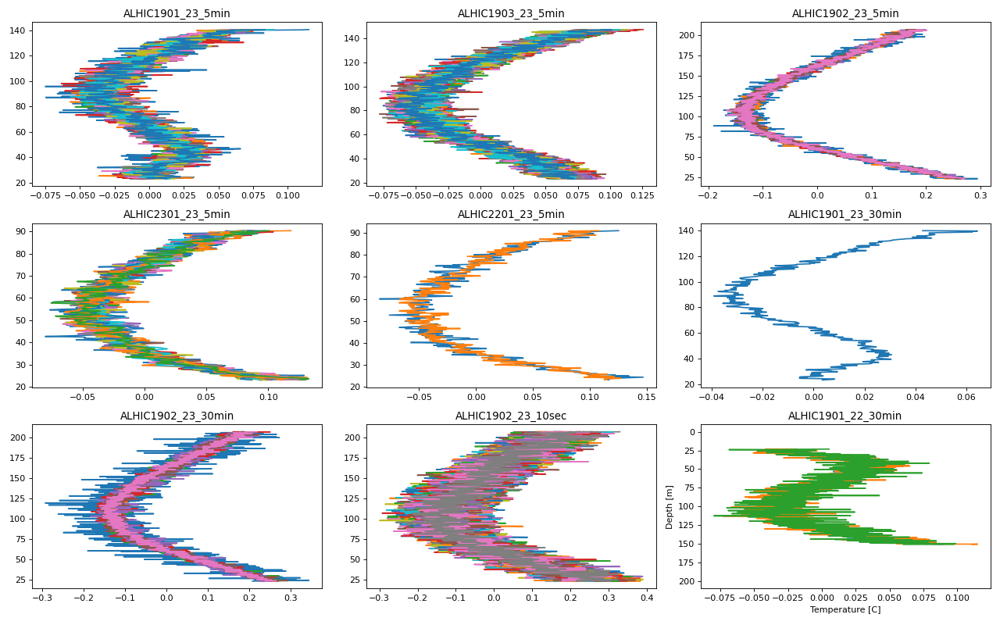

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [158]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            ax.plot(detrend,x, label=i)
#             ax.plot(y,x)
        ax.set_title(i)
    else:

        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            ax.plot(detrend,x, label=i)
#             ax.plot(y,x)
        ax.set_title(i)

        
plt.ylim([-10,210])

plt.gca().invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [159]:
### Mean of the detrended signal ###

<IPython.core.display.Javascript object>


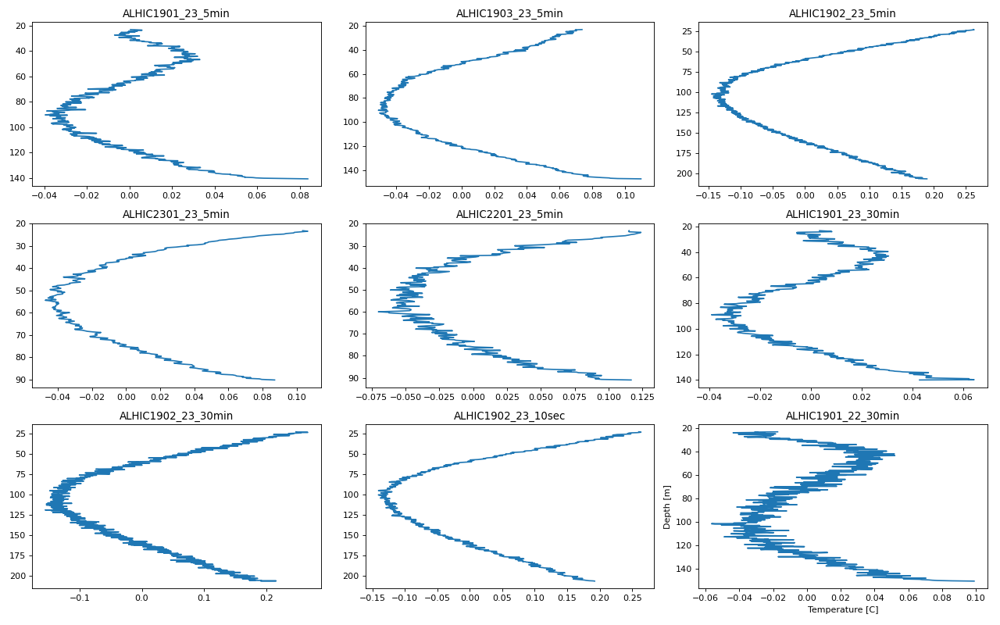

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [201]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            ax.plot(detrend,x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax.plot(detrend_mean.T,x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

## Gradient of the temperature profiles

<IPython.core.display.Javascript object>


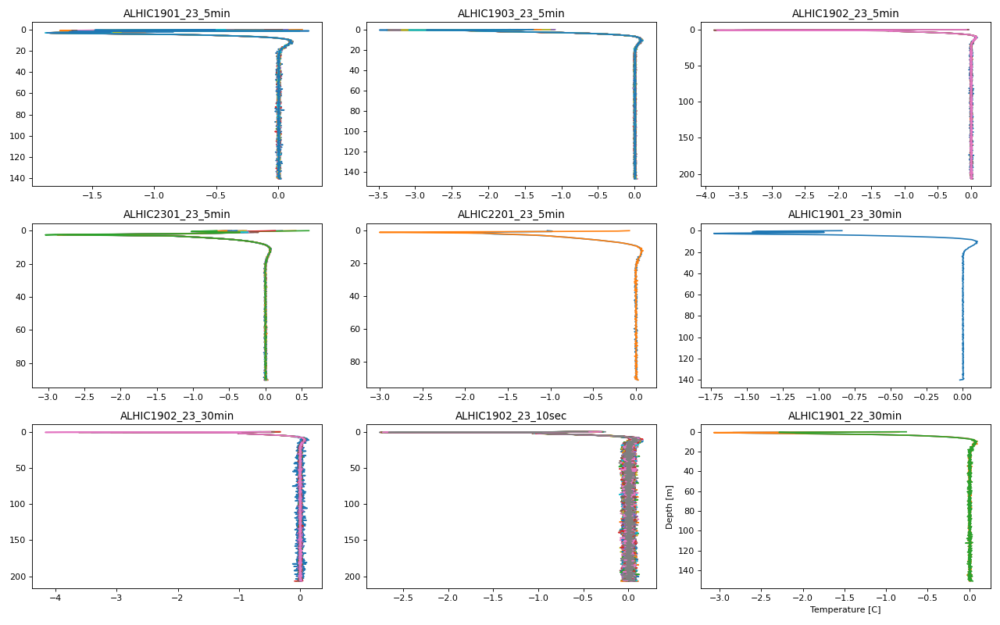

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [196]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        
        gradient = np.gradient(y,axis=0)
        ax.plot(gradient,x, label=i)

        ax.invert_yaxis()
        ax.set_title(i)
    else:

        for profile in y.T:
            gradient = np.gradient(profile)
            ax.plot(gradient,x, label=i)
        
        ax.invert_yaxis()
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


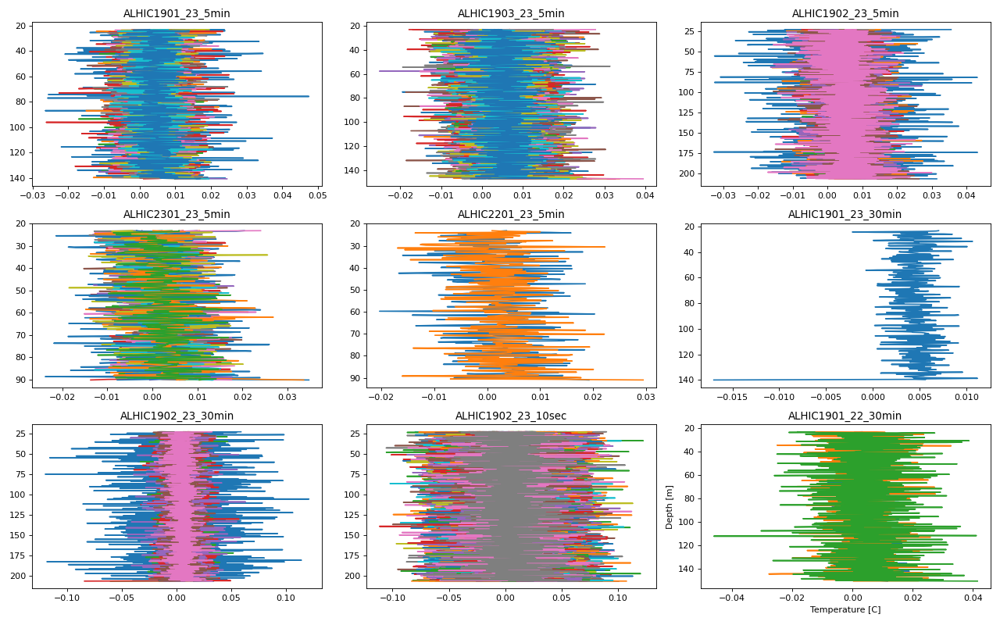

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [198]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        
        gradient = np.gradient(y,axis=0)
        ax.plot(gradient,x, label=i)

        ax.invert_yaxis()
        ax.set_title(i)
    else:

        for profile in y.T:
            gradient = np.gradient(profile)
            ax.plot(gradient,x, label=i)
        
        ax.invert_yaxis()
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


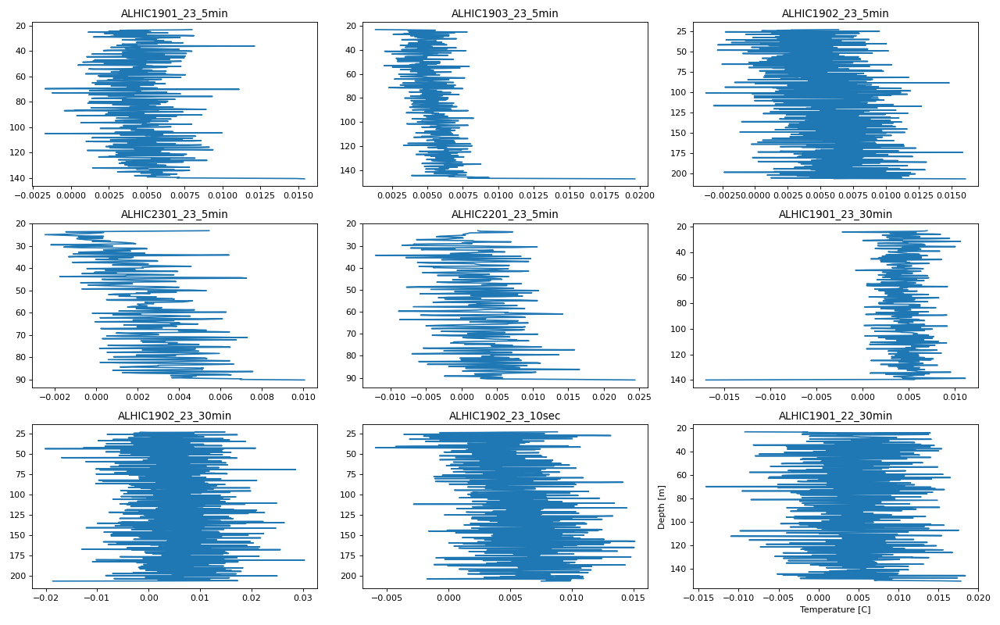

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [199]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        
        gradient = np.gradient(y,axis=0)
        ax.plot(gradient,x, label=i)

        ax.invert_yaxis()
        ax.set_title(i)
    else:
        grads = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            gradient = np.gradient(profile)
            grads[num] = gradient
        mean_grad = np.mean(grads,axis=0)
        ax.plot(mean_grad.T,x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

## Ok, now can we highpass the detrended data?

In [204]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score






<IPython.core.display.Javascript object>


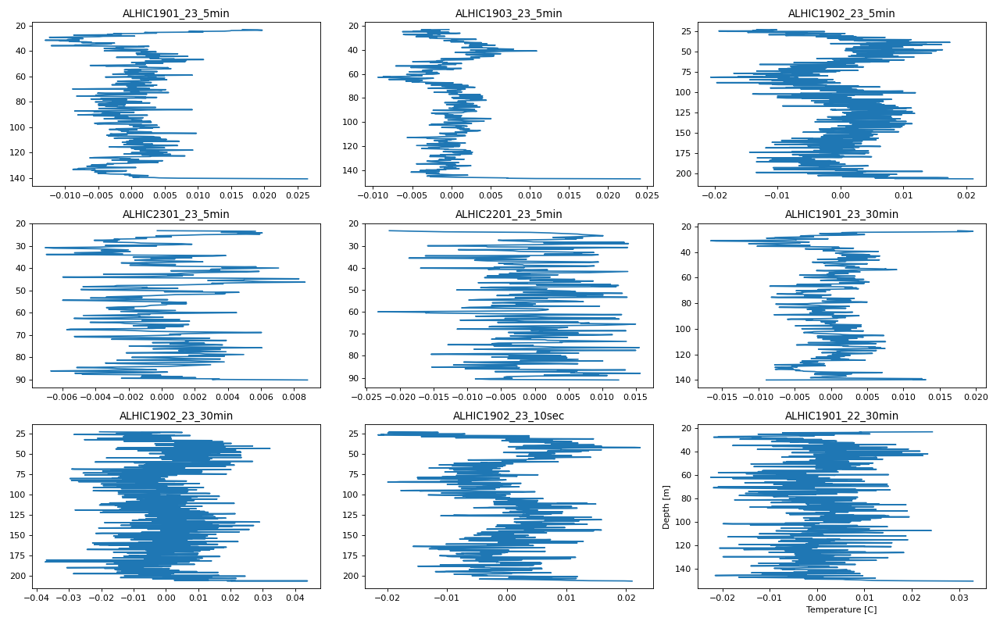

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [205]:
scale_offset = 0

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp,x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp,x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [206]:
### Can we plot this on top of each other?

<IPython.core.display.Javascript object>


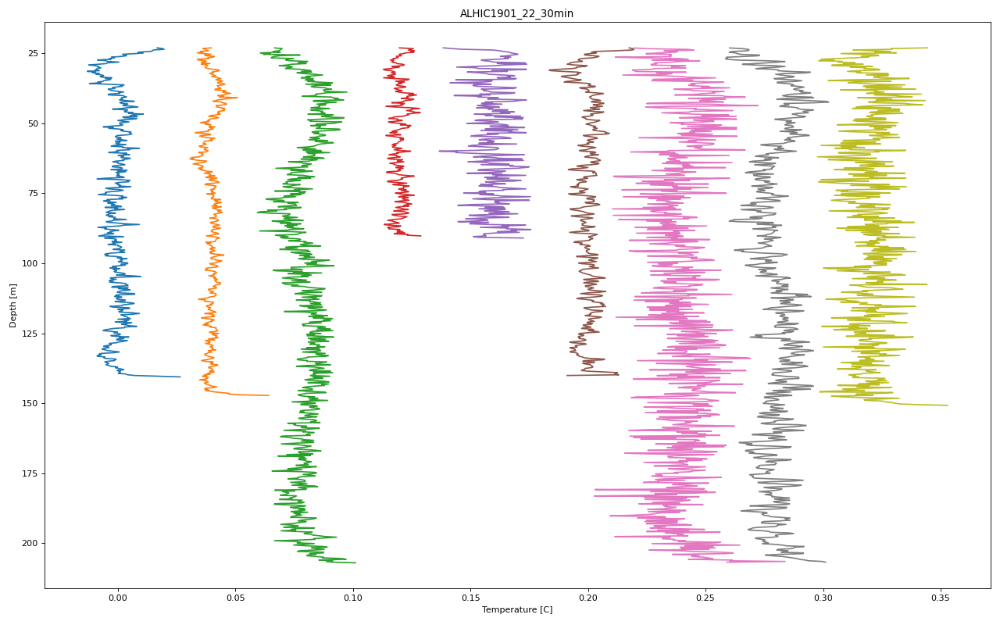

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [210]:
scale_offset = 0.04

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

## Can we do some sort of wavelet denoising?

In [224]:
from skimage.restoration import denoise_wavelet
 


<IPython.core.display.Javascript object>


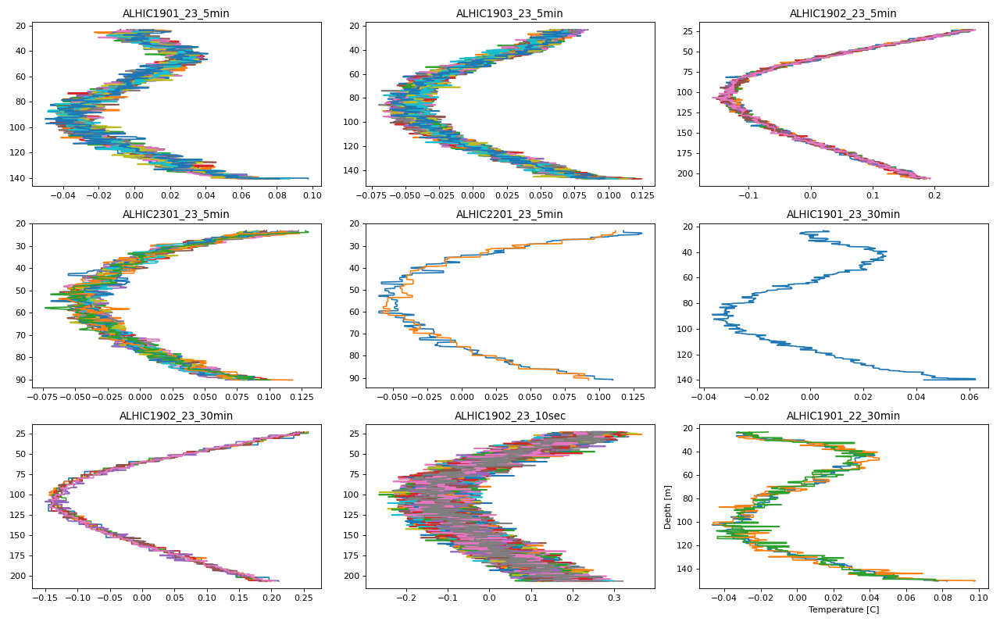

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [227]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            denoised = denoise_wavelet(detrend, wavelet='db1', mode='soft', wavelet_levels=6)
            ax.plot(denoised,x, label=i)
#             ax.plot(y,x)
        ax.invert_yaxis()    
        ax.set_title(i)
    else:
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            denoised = denoise_wavelet(detrend, wavelet='db1', mode='soft', wavelet_levels=6)
            ax.plot(denoised,x, label=i)
#             ax.plot(y,x)
        ax.invert_yaxis()
        ax.set_title(i)
    


plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [229]:
### OK now we'll do the detrend and then mean first and then denoise ###

<IPython.core.display.Javascript object>


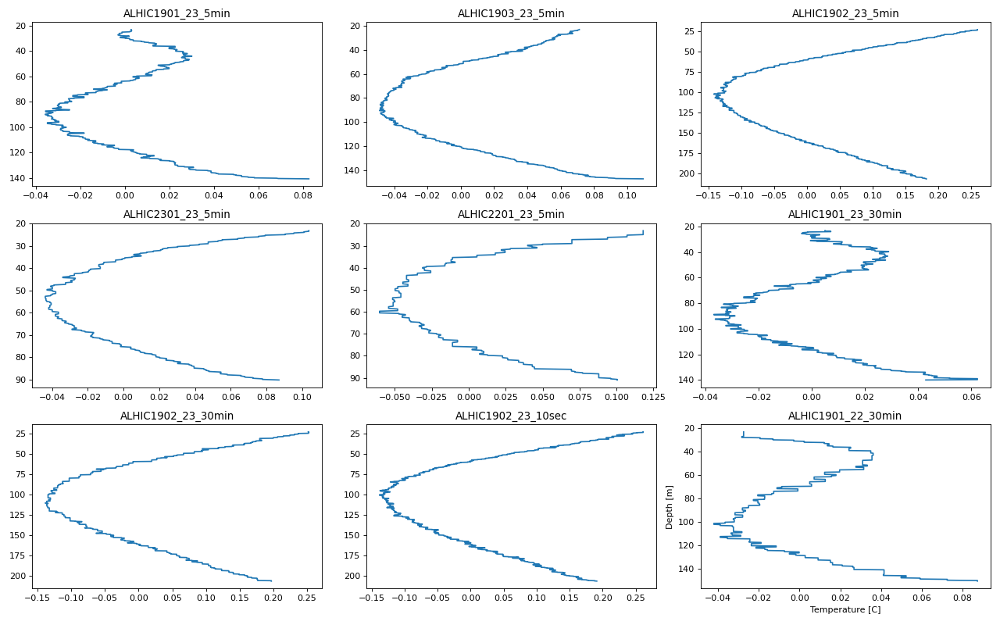

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [230]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            denoised = denoise_wavelet(detrend, wavelet='db1', mode='soft', wavelet_levels=6)
            ax.plot(denoised,x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        denoised = denoise_wavelet(detrend_mean, wavelet='db1', mode='soft', wavelet_levels=6)
        ax.plot(denoised.T,x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [231]:
### Ok, denoise on the highpass filtered stuff with the climate trend removed ###

<IPython.core.display.Javascript object>


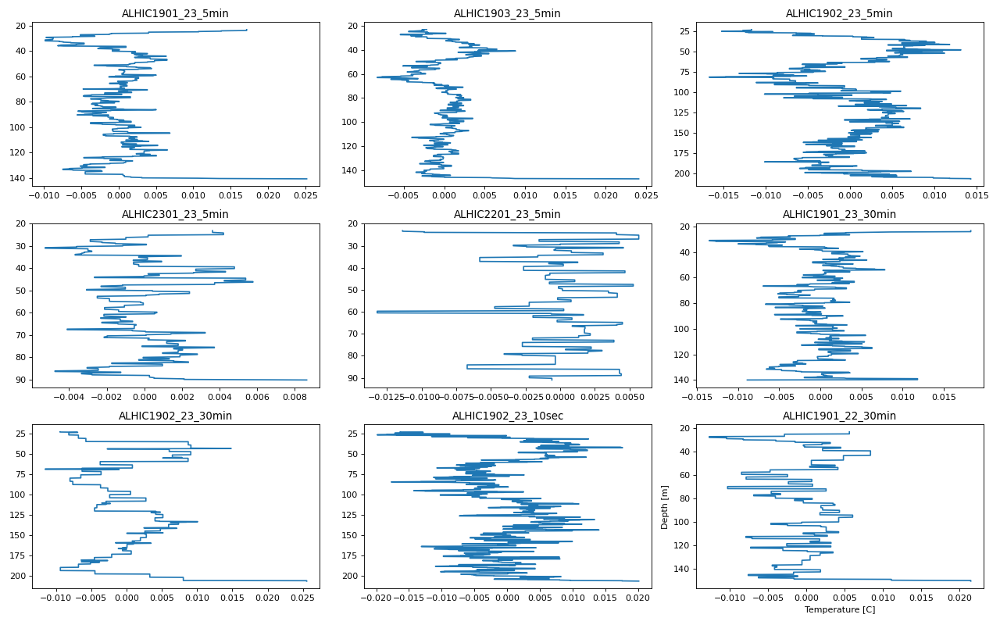

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [233]:
scale_offset = 0

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data, colors, ax_list)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            climate_removed = detrend - trendp
            denoised = denoise_wavelet(climate_removed, wavelet='db1', mode='soft', wavelet_levels=4)
            ax.plot(denoised,x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        climate_removed = detrend_mean.T - trendp
        denoised = denoise_wavelet(climate_removed, wavelet='db1', mode='soft', wavelet_levels=4)
        ax.plot(denoised,x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_title(i)

        



plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# Can we start to plot the same boreholes on the same plot?

<IPython.core.display.Javascript object>


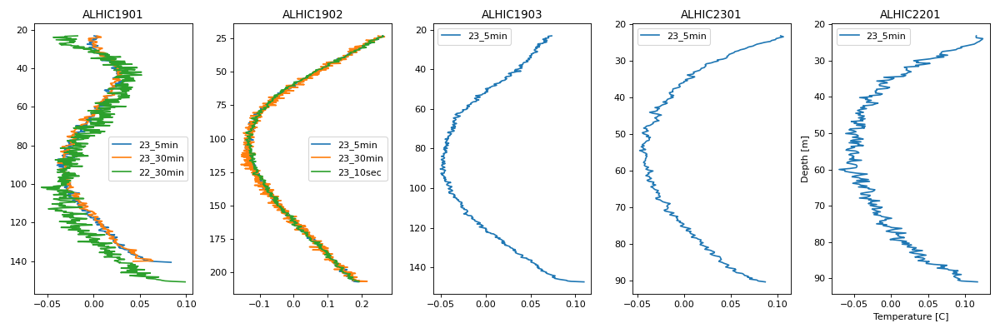

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [244]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[15,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            ax1.plot(detrend,x, label=i[10:])
#             ax.plot(y,x)
        ax1.set_title('ALHIC1901')
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num, profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax1.plot(detrend_mean,x, label=i[10:])

#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num, profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax2.plot(detrend_mean,x, label=i[10:])
        ax2.set_title('ALHIC1902')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num, profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax3.plot(detrend_mean,x, label=i[10:])
        ax3.set_title('ALHIC1903')
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num, profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax4.plot(detrend_mean,x, label=i[10:])
        ax4.set_title('ALHIC2301')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num, profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        ax5.plot(detrend_mean,x, label=i[10:])
        ax5.set_title('ALHIC2201')
            #             ax.plot(y,x)

for k in ax_list:
    k.legend()
    k.invert_yaxis()
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


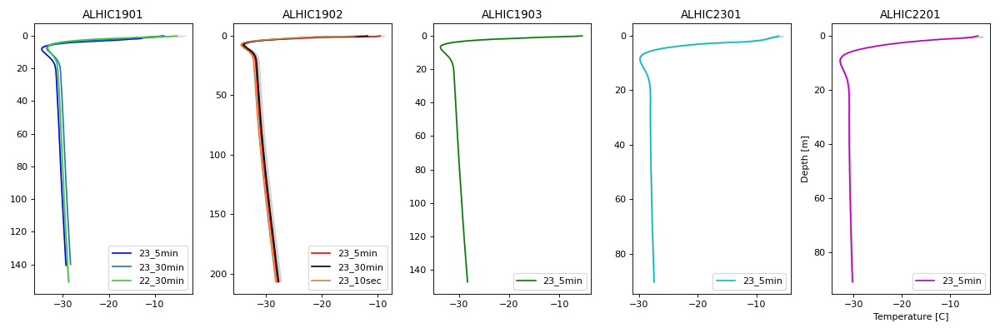

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [247]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[15,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])

    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')


#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# OK, I want to play around with the processing steps a bit now.

### Like how does doing matching sections change things?
### And adding trans_att (transient attenuation)?

<IPython.core.display.Javascript object>


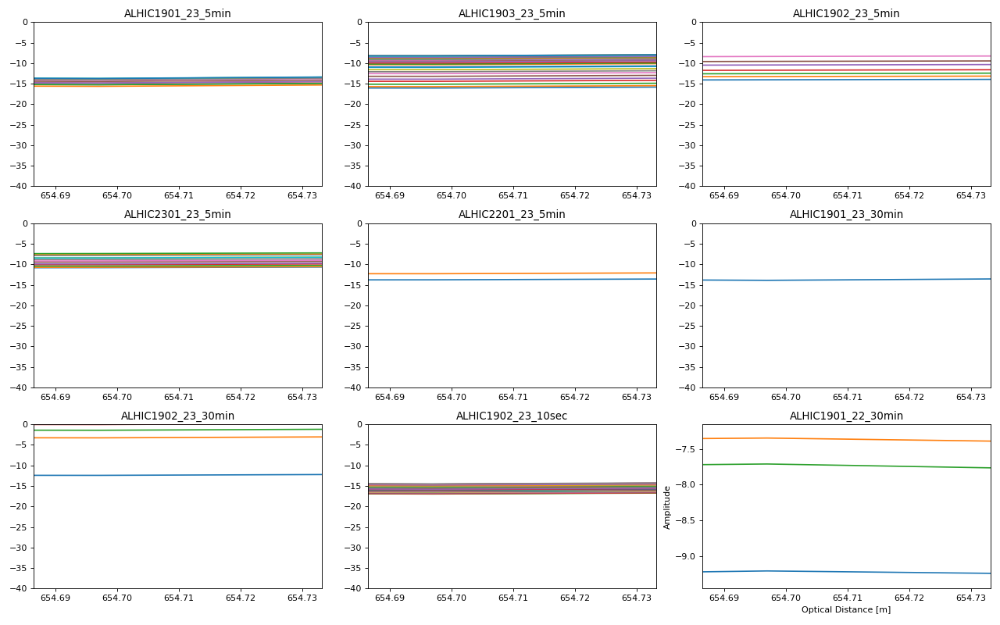

In [249]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data[i].x, data[i].tmpw)
    ax.set_ylim([-40,0])
    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

<IPython.core.display.Javascript object>


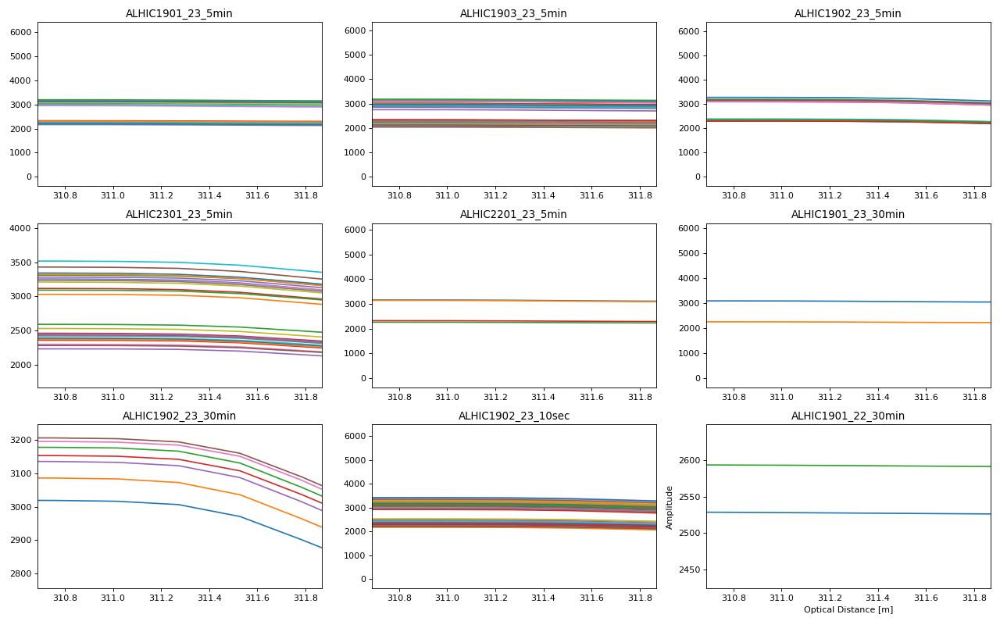

In [251]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data[i].x, data[i].st)
    ax.plot(data[i].x, data[i].ast)
#     ax.set_ylim([-40,0])
    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

In [295]:
## matching sections of the cable
matching_sections_dict = {
    ## (downgoing side) (upgoing side) and True because this has a forward and reverse part
    'ALHIC1901_22_30min': [(slice(-27.08, 312.815), slice(314.815, 654.71), True), [313.3]],
    'ALHIC1901_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]],
    'ALHIC1903_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]],
    'ALHIC1902_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]],
    'ALHIC2301_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]],
    'ALHIC2201_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]],
    'ALHIC1901_23_30min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]], 
    'ALHIC1902_23_30min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]], 
    'ALHIC1902_23_10sec': [(slice(-26.3, 311.2), slice(313, 650.14), True), [311.2]]
}

In [387]:
def data_processing_matching_sections(filepath):
    
    ds = read_silixa_files(
        directory=filepath,
        timezone_netcdf='UTC',
        file_ext='*.xml')

    suggested_shift = suggest_cable_shift_double_ended(
        ds,
        np.arange(-10, 10),
        plot_result=True,
        figsize=(12,8))

    ds_restored = shift_double_ended(ds, suggested_shift[0])
    ds = ds_restored

    sections = {
    "referenceTemperature": [slice(-23, -3)], 
    }
    ds.sections = sections
    matching_sections = matching_sections_dict[filepath[13:]][0]
    print(matching_sections)
#     matching_sections = [
#     (slice(74.8, 104.62), slice(518.95, 548.77), True)
#     ]
    
    st_var, resid = ds.variance_stokes(st_label='st')
    ast_var, _ = ds.variance_stokes(st_label='ast')
    rst_var, _ = ds.variance_stokes(st_label='rst')
    rast_var, _ = ds.variance_stokes(st_label='rast')

    ds.calibration_double_ended(
        st_var=st_var,
        ast_var=ast_var,
        rst_var=rst_var,
        rast_var=rast_var,
        trans_att=matching_sections_dict[filepath[13:]][1],
        matching_sections=[matching_sections],
        store_tmpw='tmpw',
        method='wls',
        solver='sparse'),
    
    resid.plot(figsize=(12, 4))
    return ds

11 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


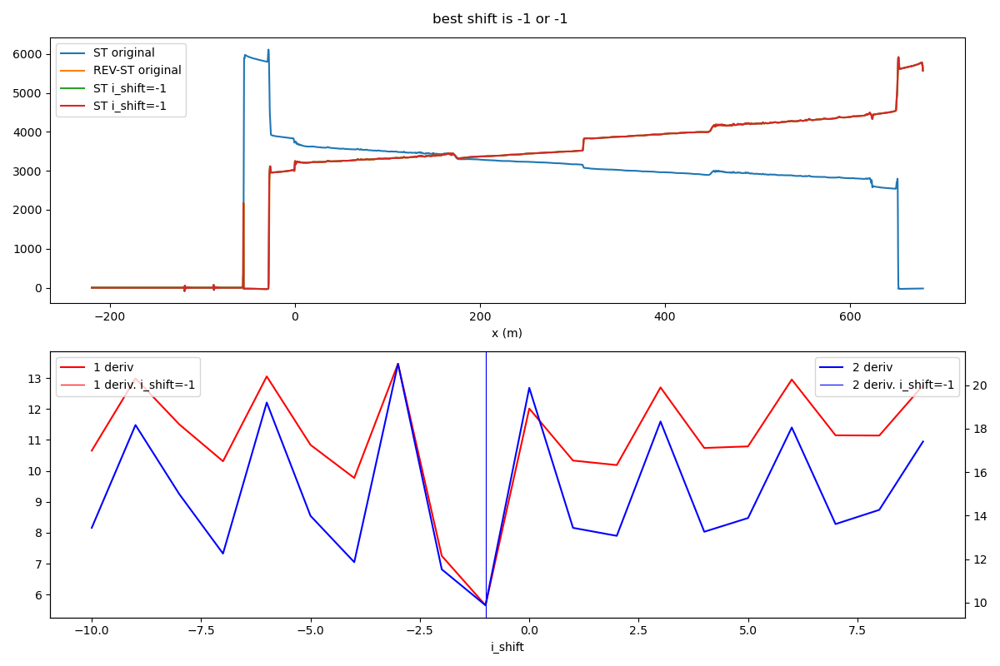

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


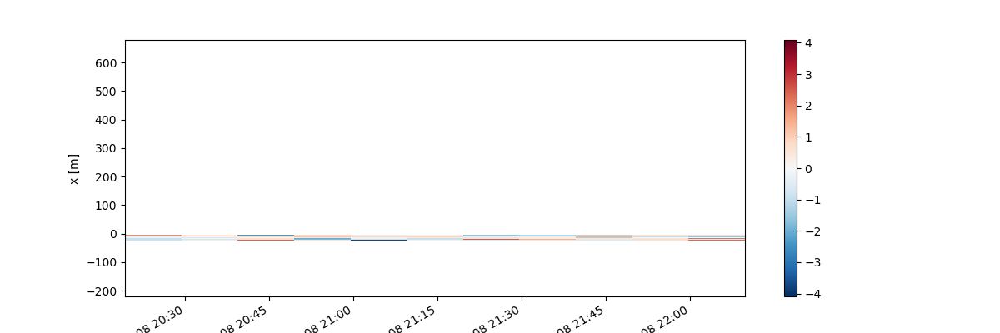

31 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


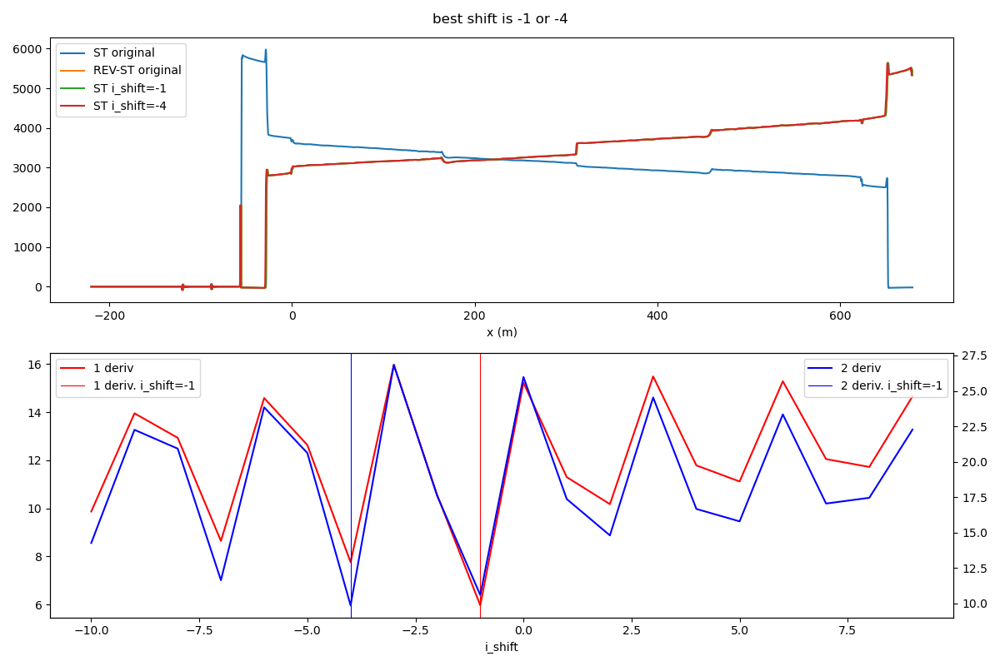

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


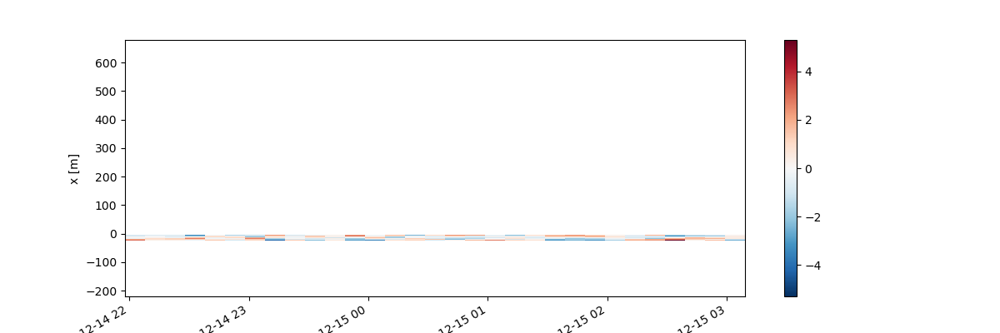

7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


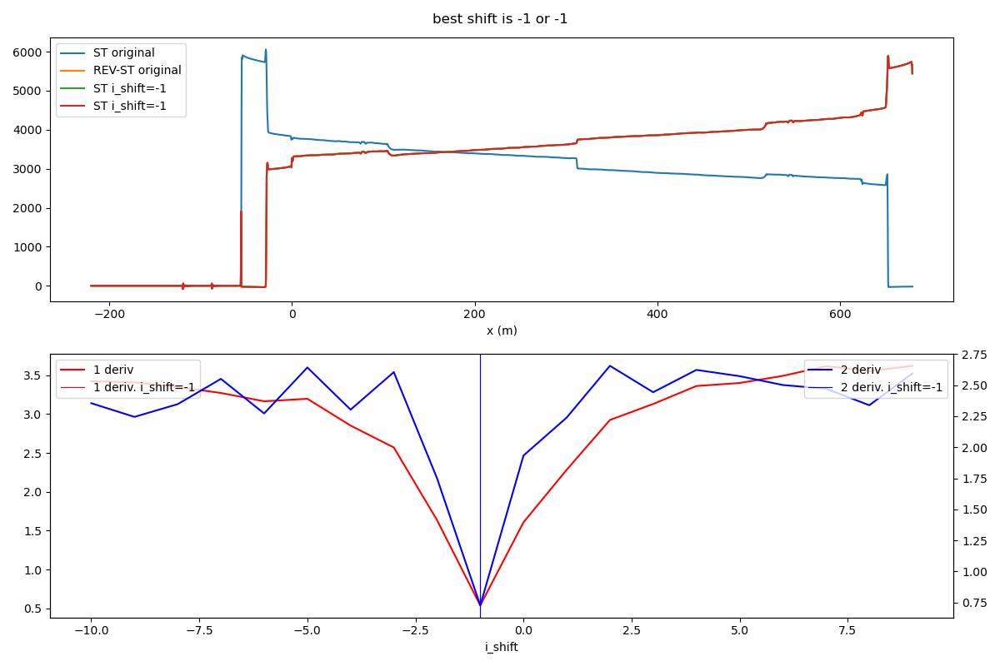

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


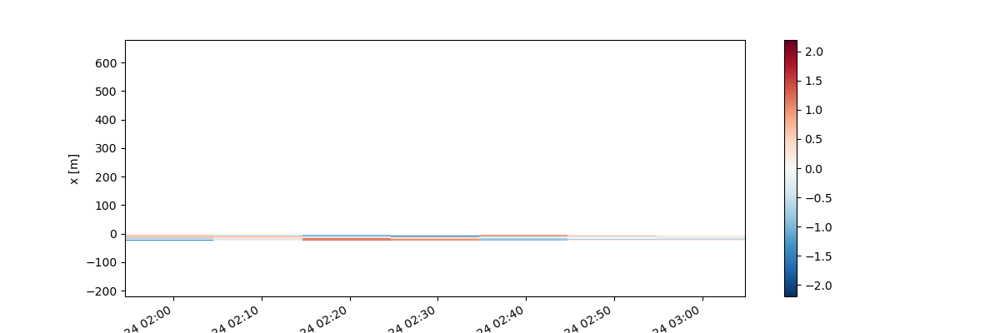

13 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


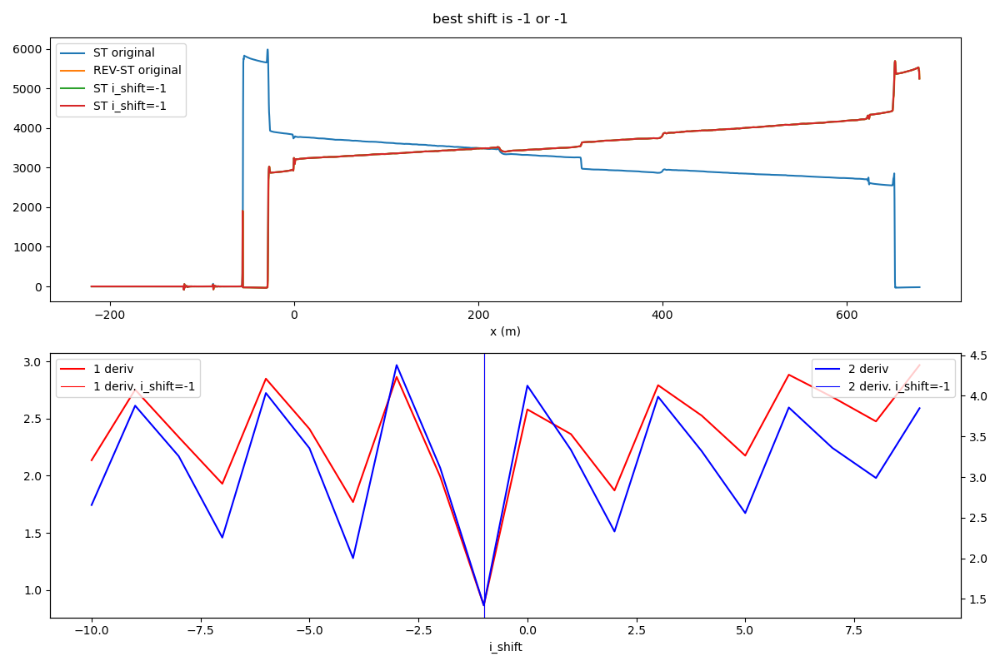

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


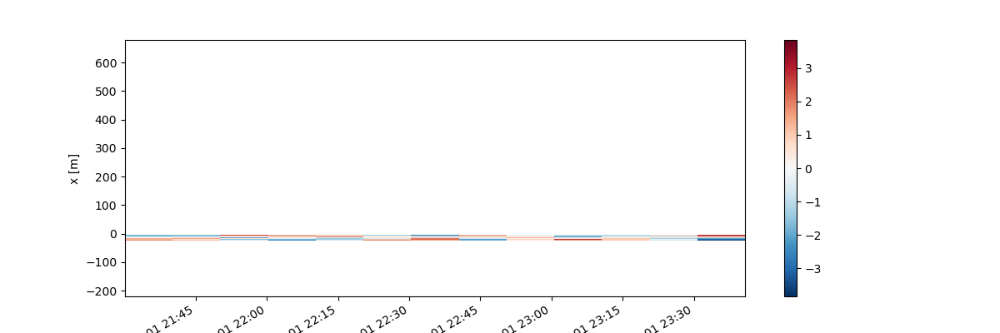

2 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


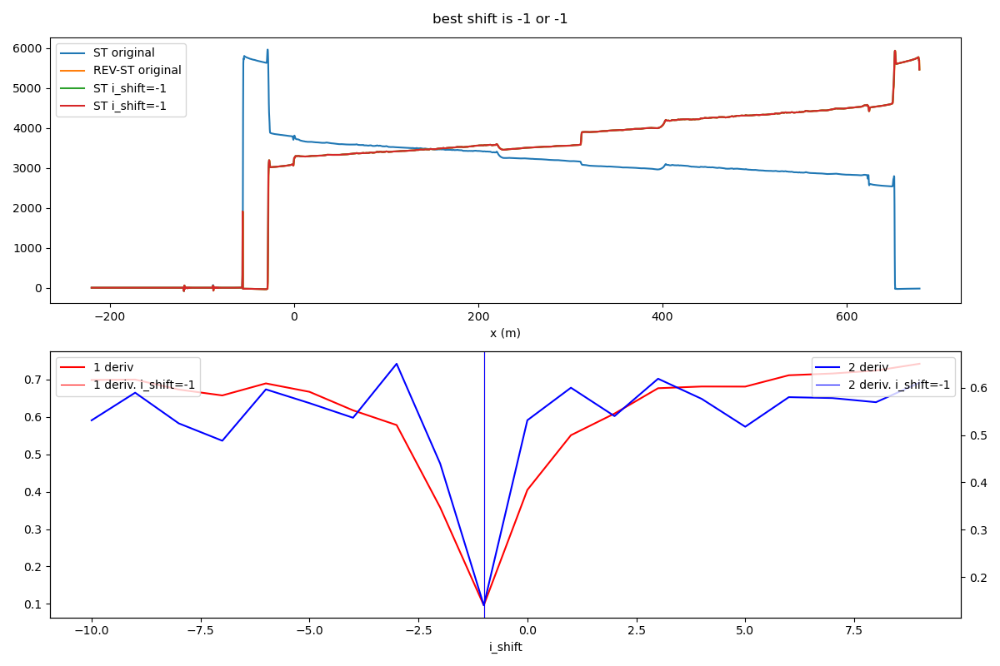

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


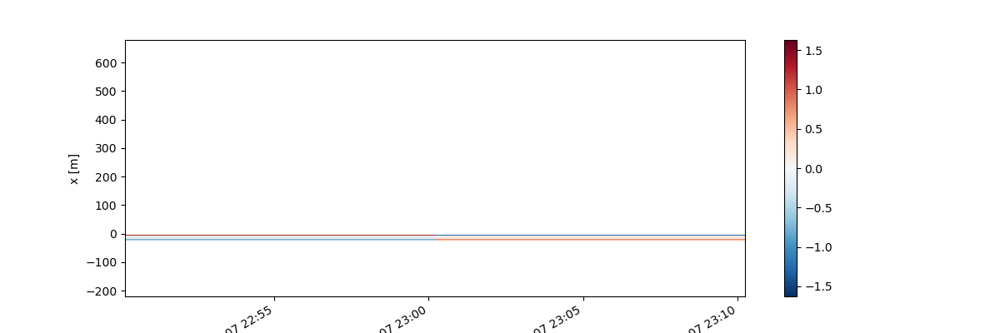

1 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


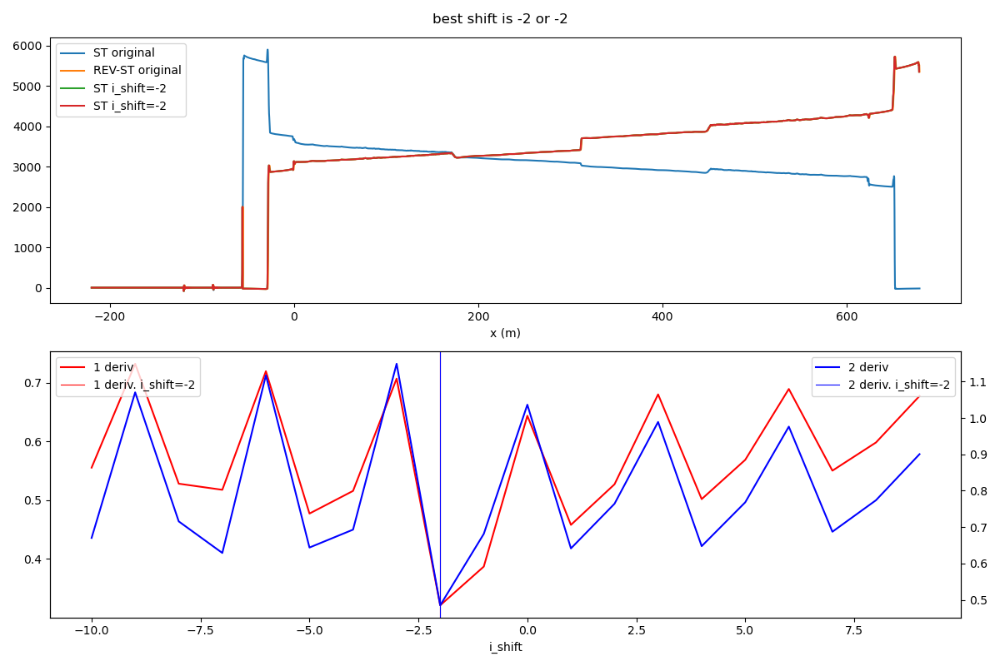

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


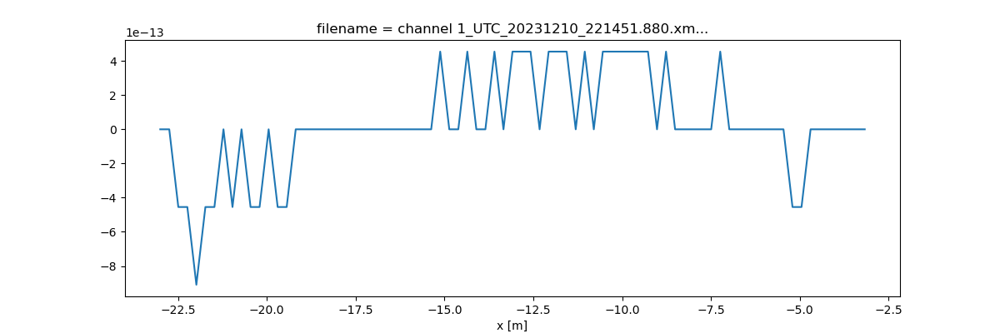

7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


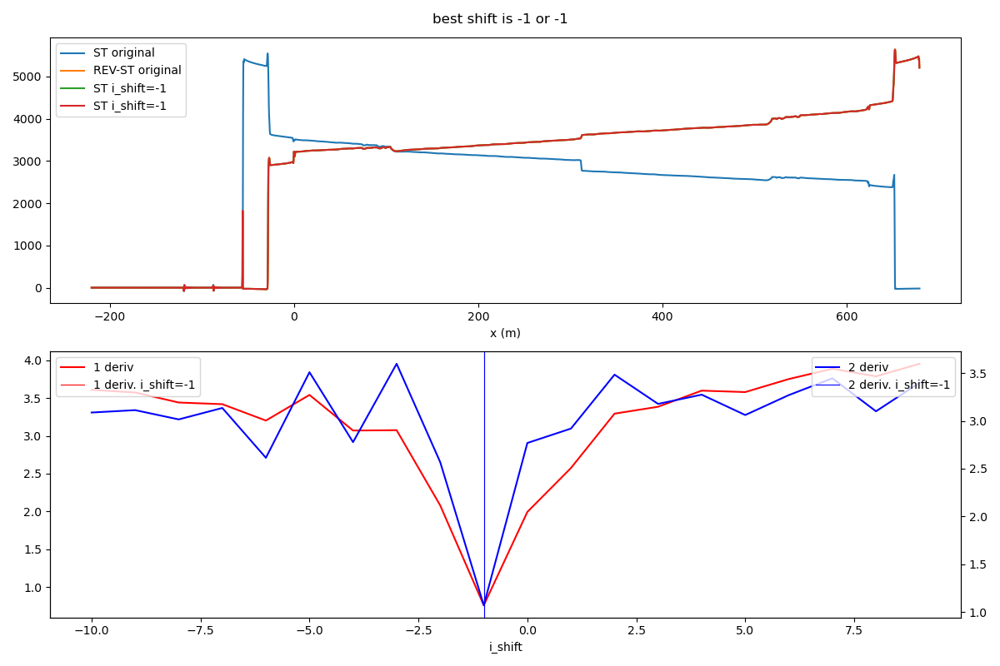

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


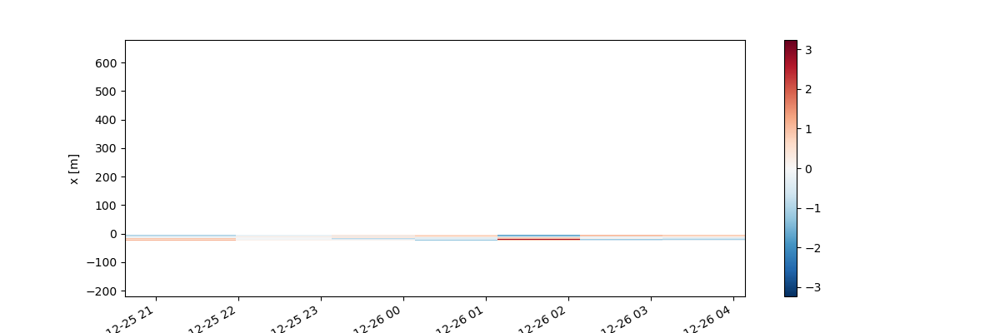

78 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


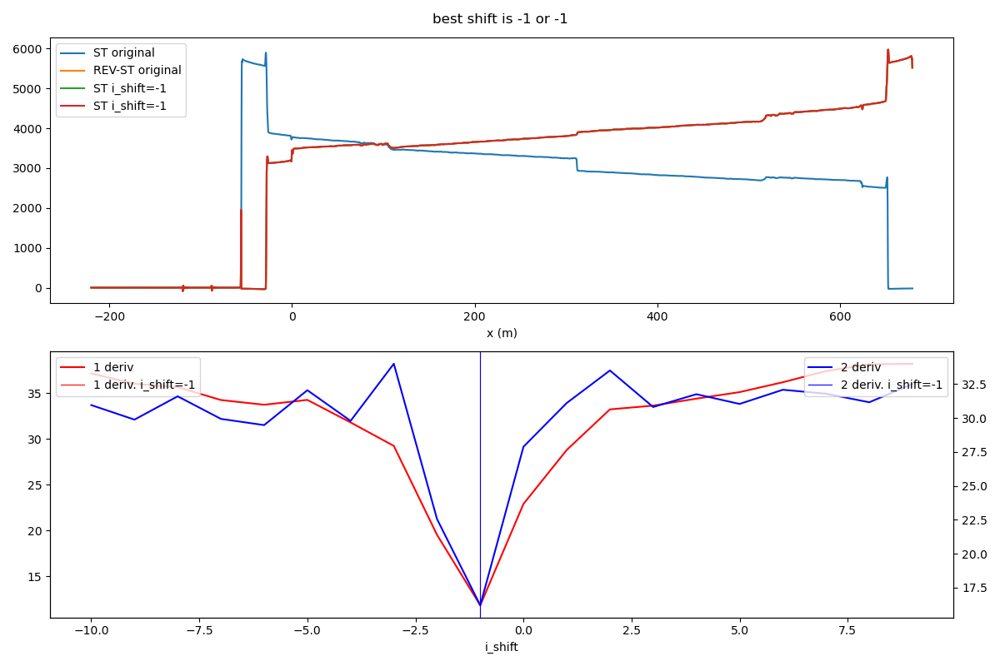

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)


<IPython.core.display.Javascript object>


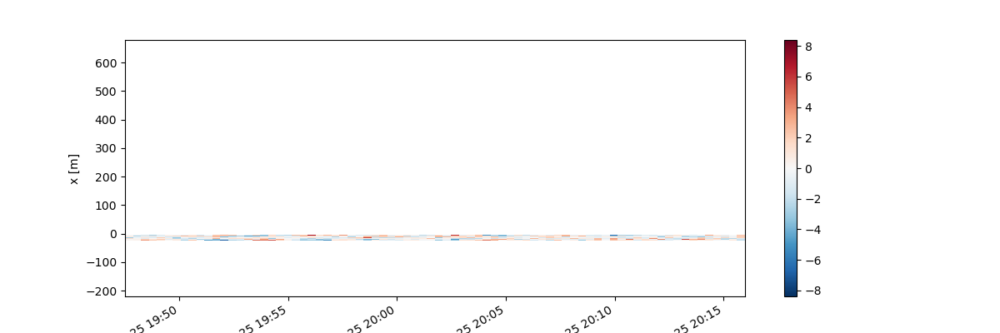

3 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3553 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


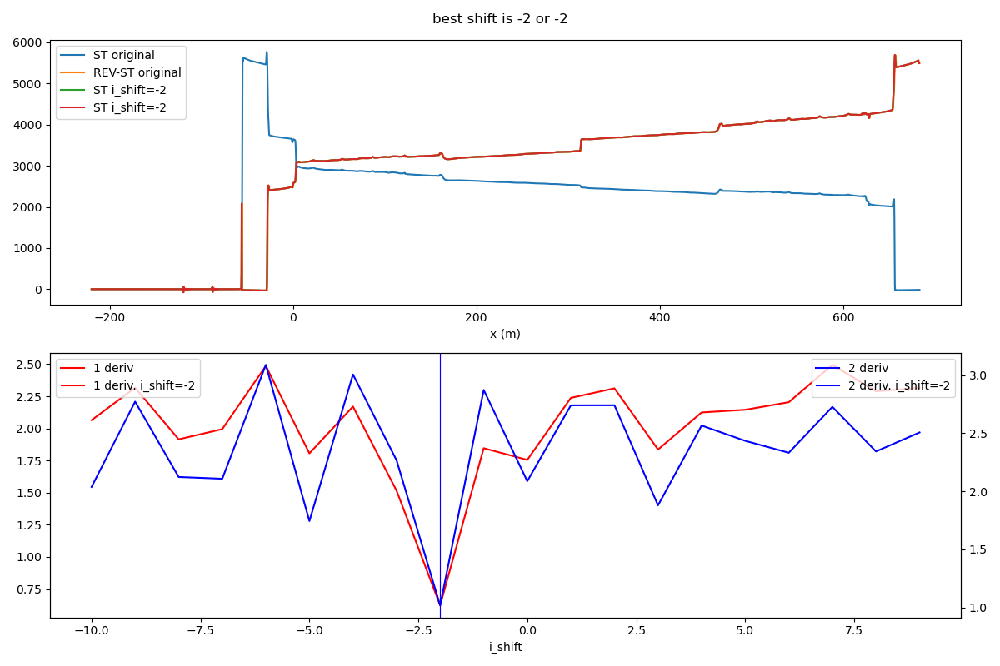

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-27.08, 312.815, None), slice(314.815, 654.71, None), True)


<IPython.core.display.Javascript object>


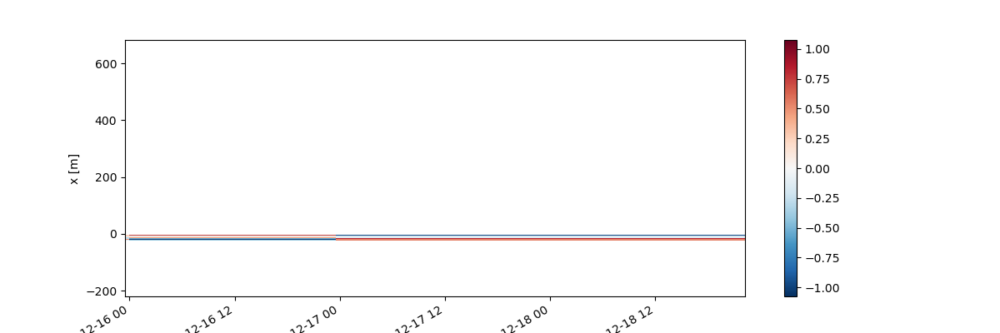

In [388]:
data_matching_sections = {}
for i in filepaths:
    ds = data_processing_matching_sections(i)
    data_matching_sections[i[13:]] = ds


<IPython.core.display.Javascript object>


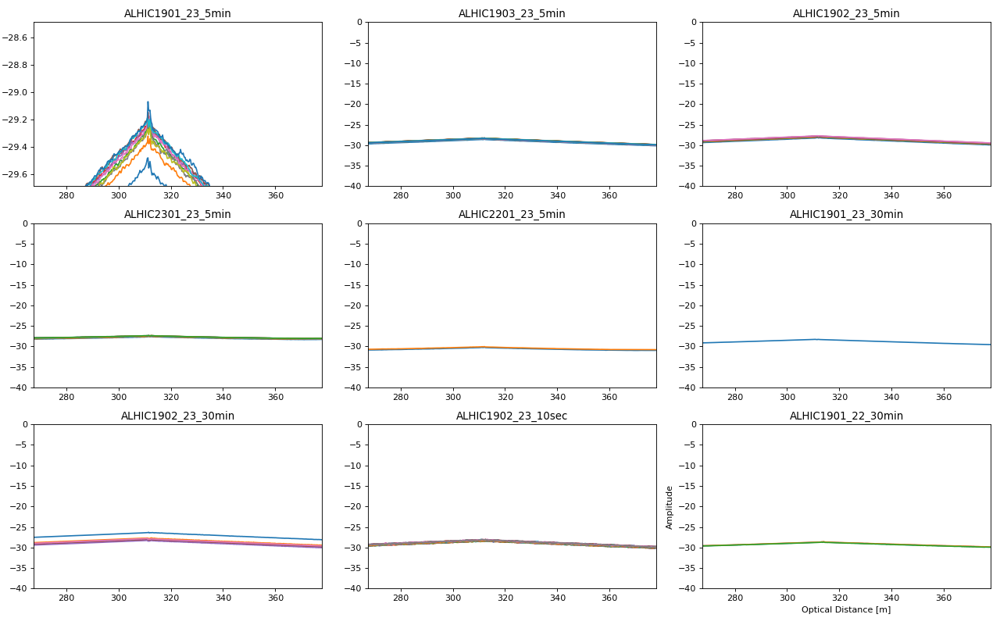

In [300]:
### How did the matching sections turn out? ###

fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data_matching_sections,ax_list):
    ax.plot(data_matching_sections[i].x, data_matching_sections[i].tmpw)
    ax.set_ylim([-40,0])
    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

<IPython.core.display.Javascript object>


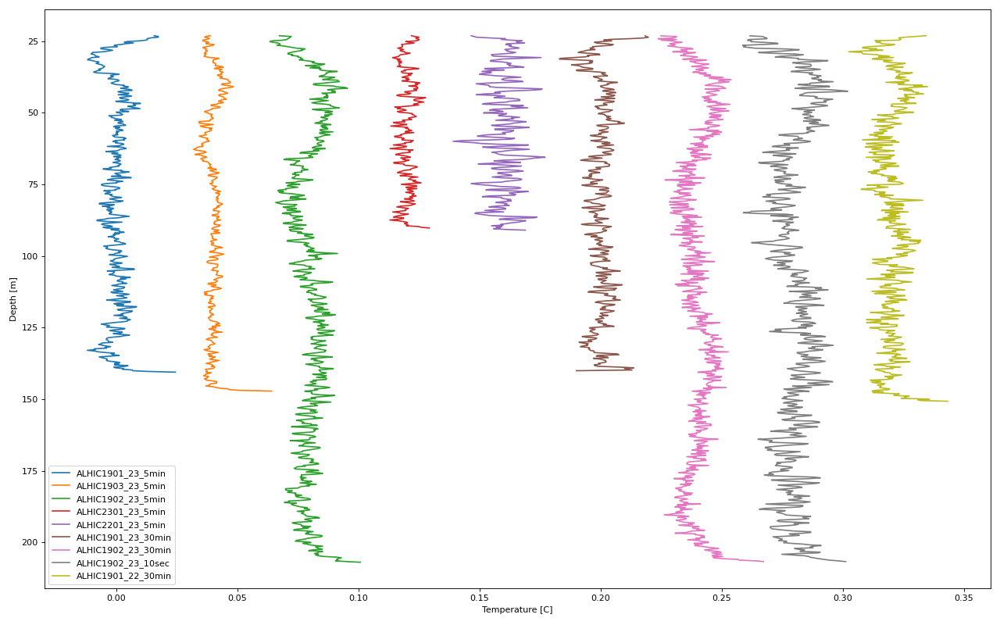

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [303]:
scale_offset = 0.04

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ax = plt.subplots(figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c) in enumerate(zip(data_matching_sections, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i)
            ax.invert_yaxis()
#             ax.plot(y,x)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i)
        ax.invert_yaxis()
#             ax.plot(y,x)


        

ax.legend()

plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [304]:
### How does this calibration compare?? ###

<IPython.core.display.Javascript object>


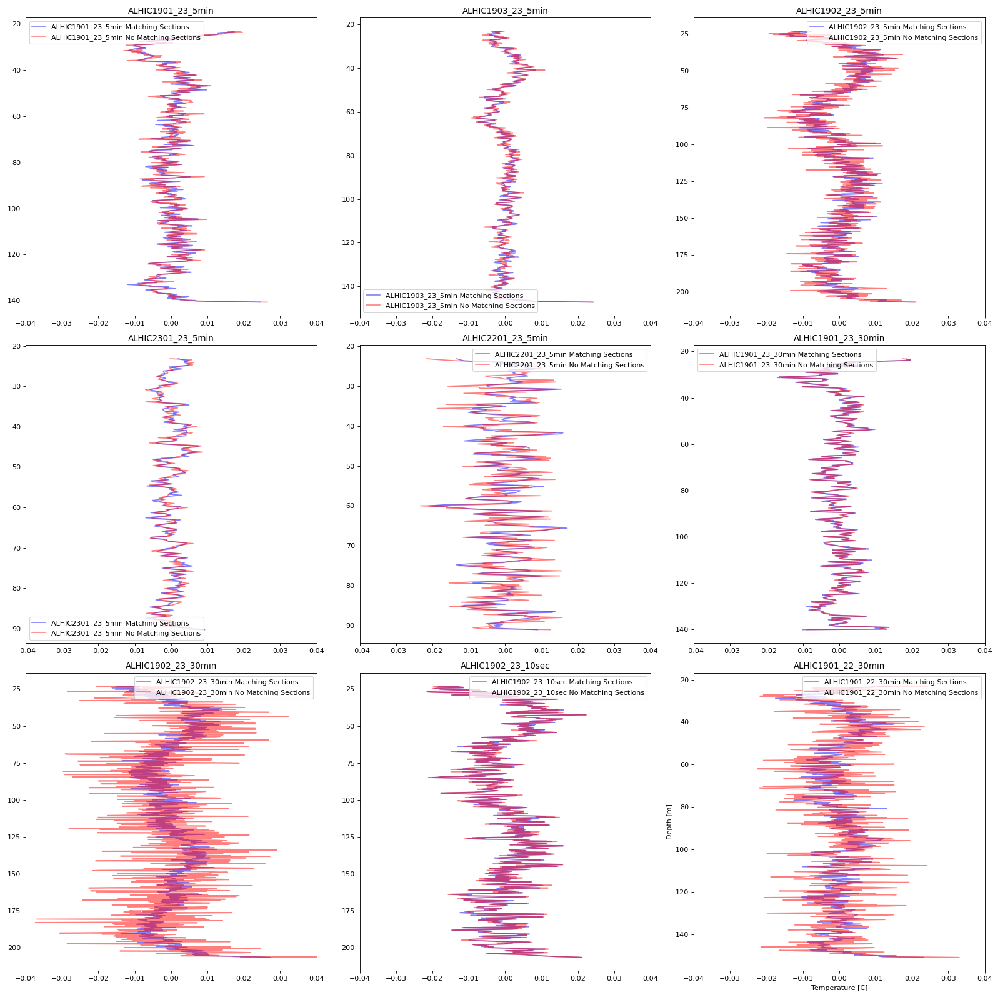

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [313]:
scale_offset = 0

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3),( ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3,figsize=[20,20])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data_matching_sections, colors, ax_list)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    y_no_match = data[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i+' Matching Sections', color='b', alpha=0.5)

        for profile in y_no_match.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i+' No Matching Sections', color='r', alpha=0.5)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_xlim([-0.04,0.04])
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i+' Matching Sections', color='b', alpha=0.5)

#             ax.plot(y,x)
        detreneded_signals = np.zeros((len(y_no_match.T), len(y_no_match)))
        for num,profile in enumerate(y_no_match.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i+' No Matching Sections', color='r', alpha=0.5)
        ax.invert_yaxis()
        ax.set_xlim([-0.04,0.04])
        ax.set_title(i)
#             ax.plot(y,x)


        
for i in ax_list:
    i.legend()

plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [322]:
### No detrending of the matching sections data and seeing what the full profile looks like ###

<IPython.core.display.Javascript object>


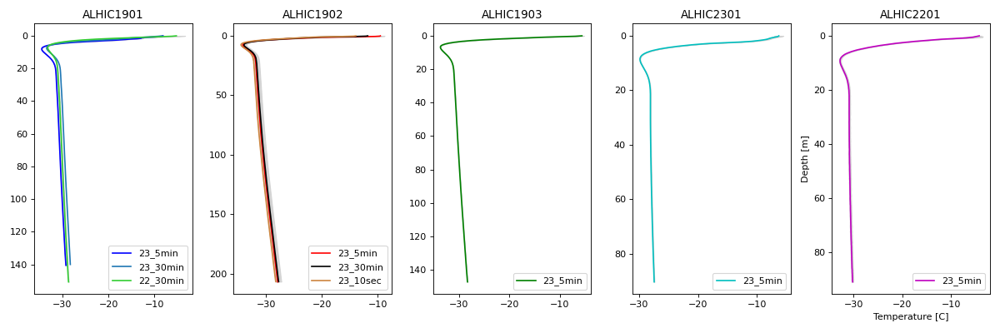

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [321]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[15,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])

    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')


#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


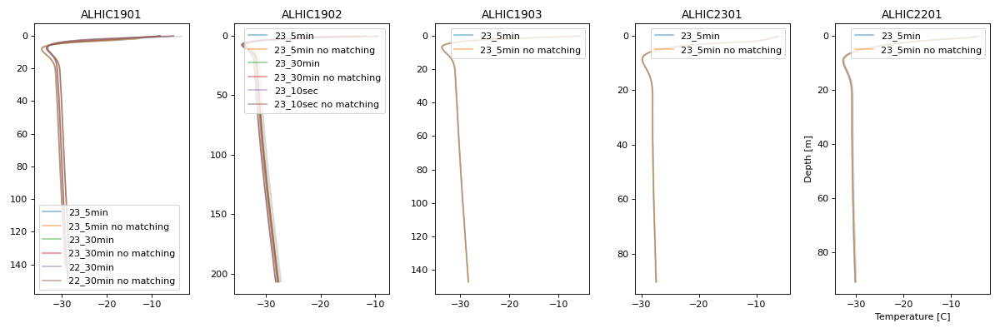

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [318]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[15,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)
for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    y_no_matching_sections = data[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    if i == 'ALHIC1901_23_30min':
        mean = y
        mean_no = y_no_matching_sections
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax1.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 

        mean_no = np.mean(y, axis=1)
        ci95_no, ci05_no = st.t.interval(alpha=0.95, df=len(data_matching_sections[i])-1, 
              loc=mean_no, 
              scale=st.sem(y_no_matching_sections, axis=1)) 

        ax1.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey', alpha=0.5)

        ax1.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
        ax1.fill_betweenx(x,ci05_no+ (off *scale_offset), ci95_no+ (off *scale_offset), color='lightgrey', alpha=0.5)
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        mean_no = np.mean(y, axis=1)
        ci95_no, ci05_no = st.t.interval(alpha=0.95, df=len(data_matching_sections[i])-1, 
              loc=mean_no, 
              scale=st.sem(y_no_matching_sections, axis=1)) 

        ax2.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey', alpha=0.5)
        ax2.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
        ax2.fill_betweenx(x,ci05_no+ (off *scale_offset), ci95_no+ (off *scale_offset), color='lightgrey', alpha=0.5)
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        mean_no = np.mean(y, axis=1)
        ci95_no, ci05_no = st.t.interval(alpha=0.95, df=len(data_matching_sections[i])-1, 
              loc=mean_no, 
              scale=st.sem(y_no_matching_sections, axis=1)) 

        ax3.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey', alpha=0.5)
        ax3.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
        ax3.fill_betweenx(x,ci05_no+ (off *scale_offset), ci95_no+ (off *scale_offset), color='lightgrey', alpha=0.5)
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        mean_no = np.mean(y, axis=1)
        ci95_no, ci05_no = st.t.interval(alpha=0.95, df=len(data_matching_sections[i])-1, 
              loc=mean_no, 
              scale=st.sem(y_no_matching_sections, axis=1)) 

        ax4.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey', alpha=0.5)
        ax4.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
        ax4.fill_betweenx(x,ci05_no+ (off *scale_offset), ci95_no+ (off *scale_offset), color='lightgrey', alpha=0.5)
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        mean_no = np.mean(y, axis=1)
        ci95_no, ci05_no = st.t.interval(alpha=0.95, df=len(data_matching_sections[i])-1, 
              loc=mean_no, 
              scale=st.sem(y_no_matching_sections, axis=1)) 

        ax5.plot(mean + (off *scale_offset),x, label=i[10:], alpha=0.5)
        ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey', alpha=0.5)
        ax5.plot(mean_no + (off *scale_offset),x, label=i[10:]+' no matching', alpha=0.5)
        ax5.fill_betweenx(x,ci05_no+ (off *scale_offset), ci95_no+ (off *scale_offset), color='lightgrey', alpha=0.5)
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [320]:
## it doesnt seem like it makes much of an overall difference? ###

In [325]:
### Can we pick the matching sections better? ###
### I think I picked the outside best, but what about the middle? ###

In [331]:
def data_processing_matching_sections_test(filepath):
    
    ds = read_silixa_files(
        directory=filepath,
        timezone_netcdf='UTC',
        file_ext='*.xml')

    suggested_shift = suggest_cable_shift_double_ended(
        ds,
        np.arange(-10, 10),
        plot_result=True,
        figsize=(12,8))

    ds_restored = shift_double_ended(ds, suggested_shift[0])
    ds = ds_restored

    sections = {
    "referenceTemperature": [slice(-23, -3)], 
    }
    ds.sections = sections
    matching_sections = matching_sections_dict_test[filepath[13:]][0]
    print(matching_sections)
#     matching_sections = [
#     (slice(74.8, 104.62), slice(518.95, 548.77), True)
#     ]
    
    st_var, resid = ds.variance_stokes(st_label='st')
    ast_var, _ = ds.variance_stokes(st_label='ast')
    rst_var, _ = ds.variance_stokes(st_label='rst')
    rast_var, _ = ds.variance_stokes(st_label='rast')

    ds.calibration_double_ended(
        st_var=st_var,
        ast_var=ast_var,
        rst_var=rst_var,
        rast_var=rast_var,
        trans_att=matching_sections_dict[filepath[13:]][1],
        matching_sections=[matching_sections],
        store_tmpw='tmpw',
        method='wls',
        solver='sparse'),

    return ds

In [332]:
## matching sections of the cable
matching_sections_dict_test = {
    ## (downgoing side) (upgoing side) and True because this has a forward and reverse part
    'ALHIC1901_22_30min': [(slice(-27.08, 312.815), slice(314.815, 654.71), True), [313.815]],
    'ALHIC1901_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]],
    'ALHIC1903_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]],
    'ALHIC1902_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]],
    'ALHIC2301_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]],
    'ALHIC2201_23_5min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]],
    'ALHIC1901_23_30min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]], 
    'ALHIC1902_23_30min': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]], 
    'ALHIC1902_23_10sec': [(slice(-26.3, 311.2), slice(313, 650.14), True), [312.1]]
}

11 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


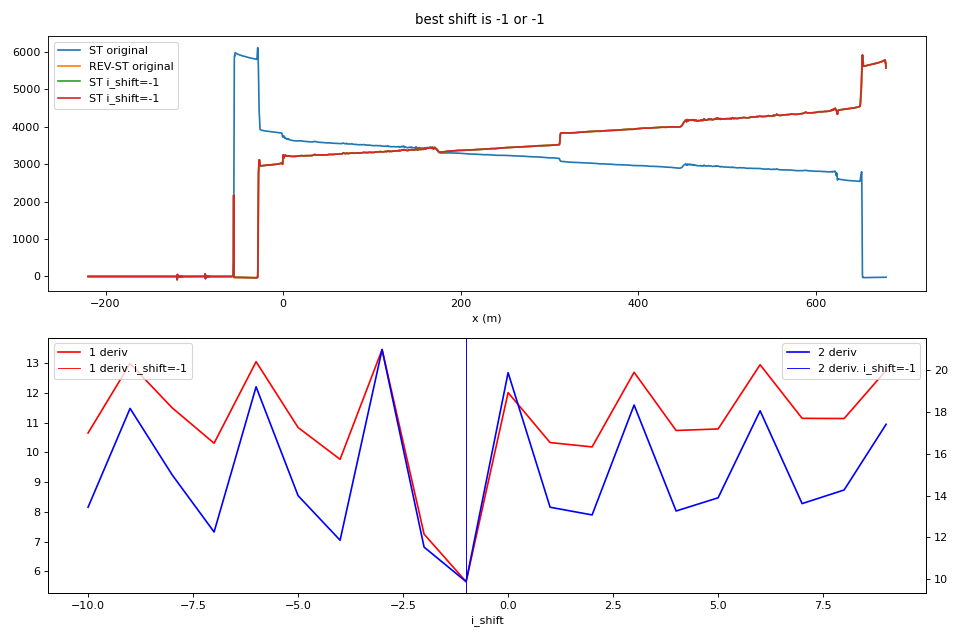

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
31 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


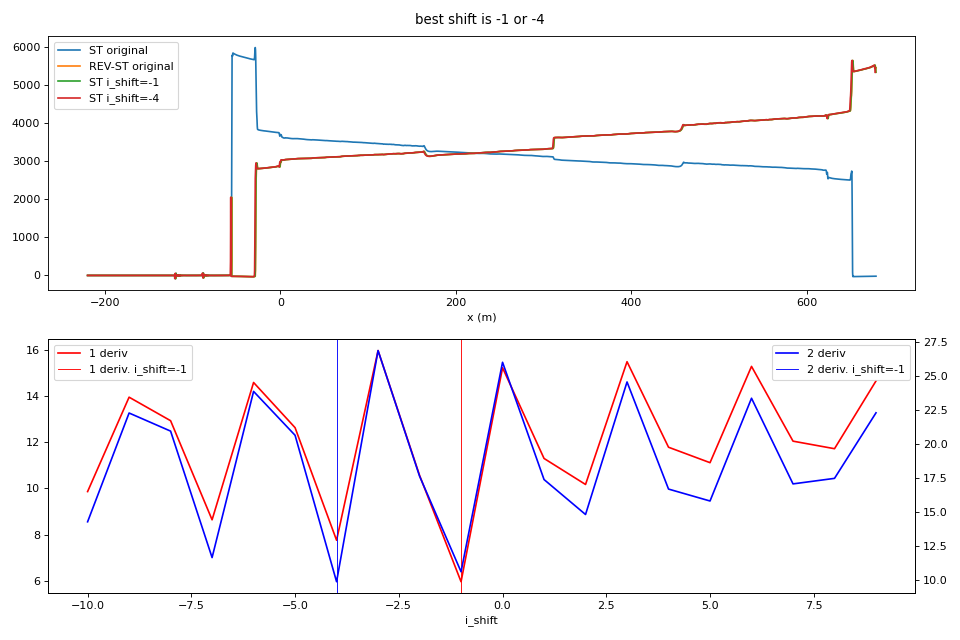

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


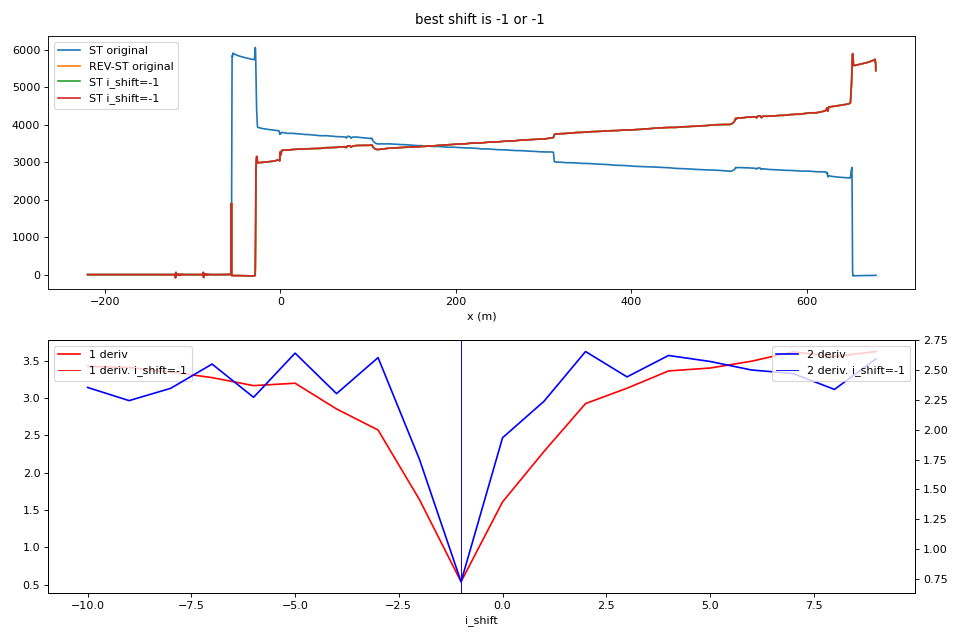

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
13 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


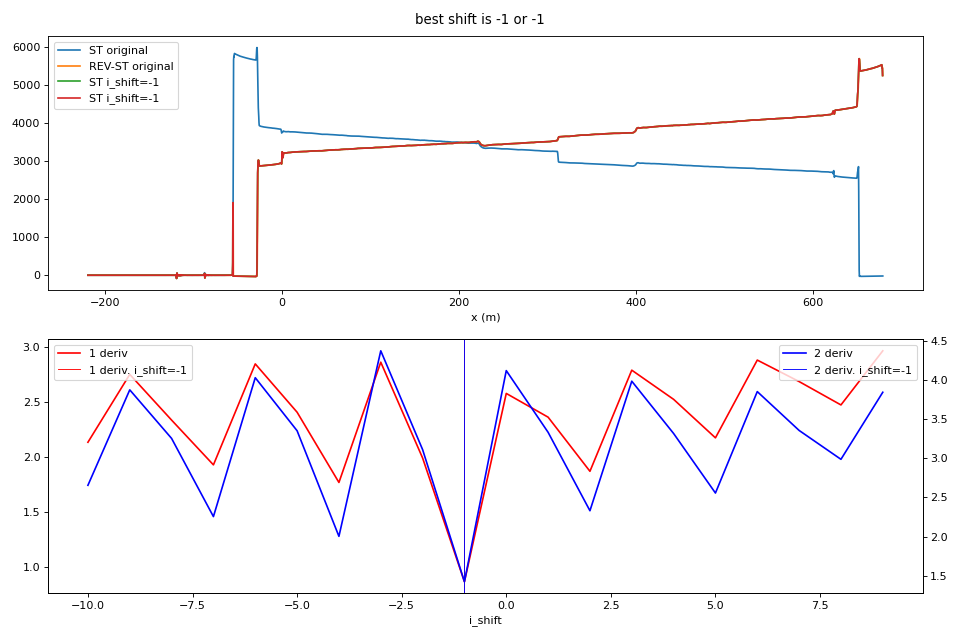

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
2 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


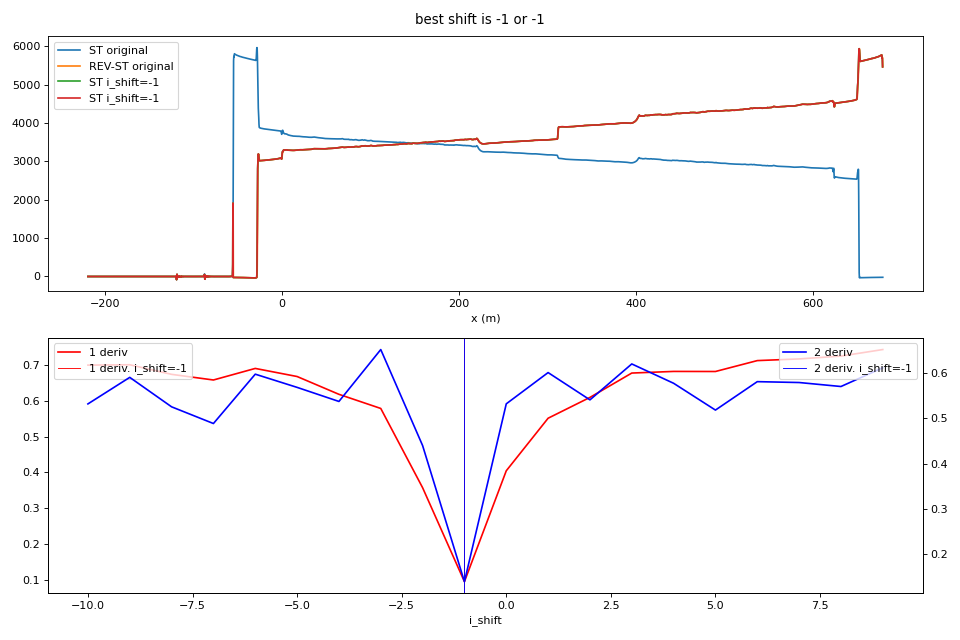

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
1 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


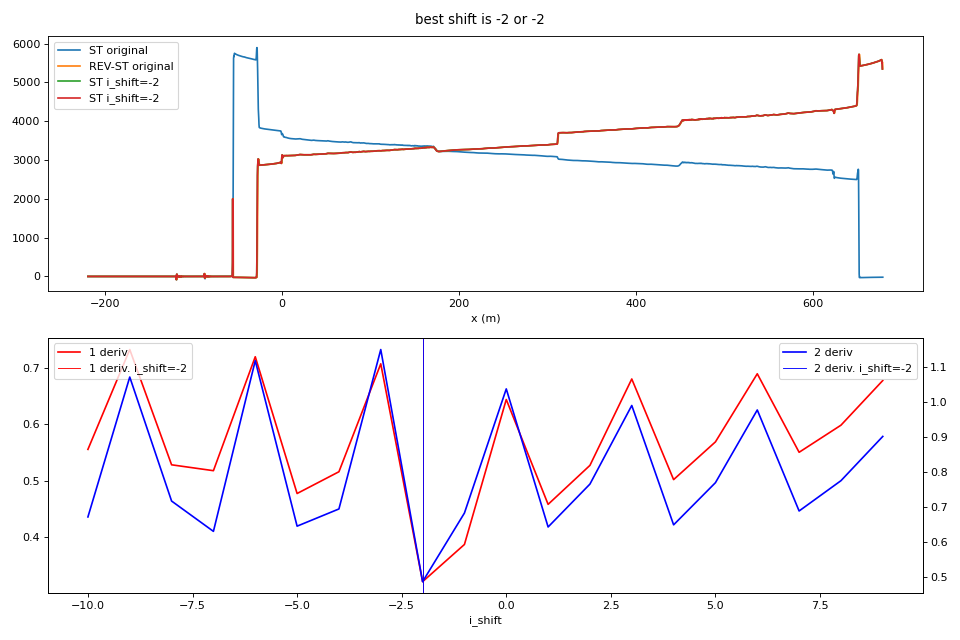

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


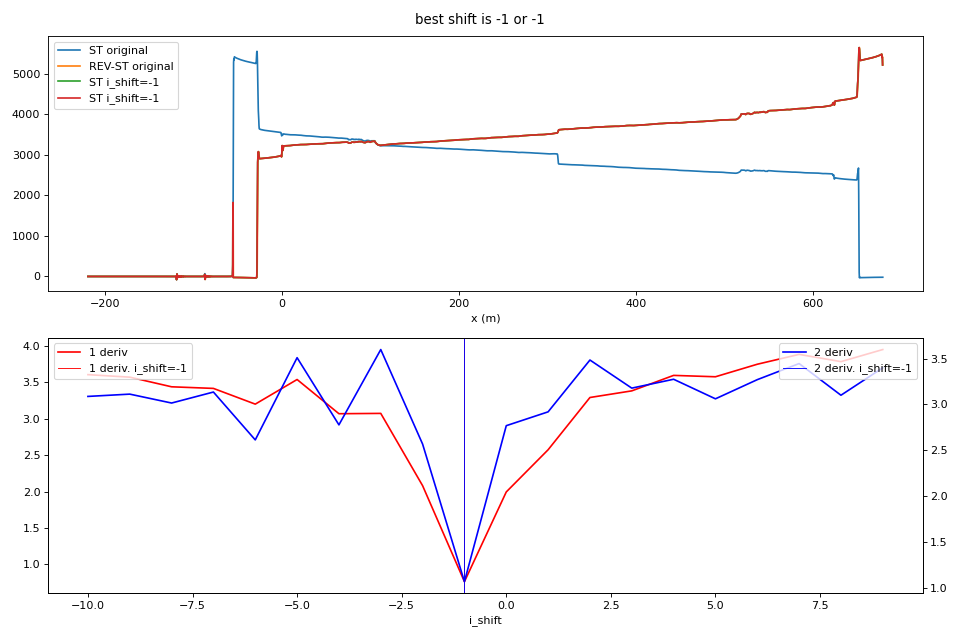

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
78 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


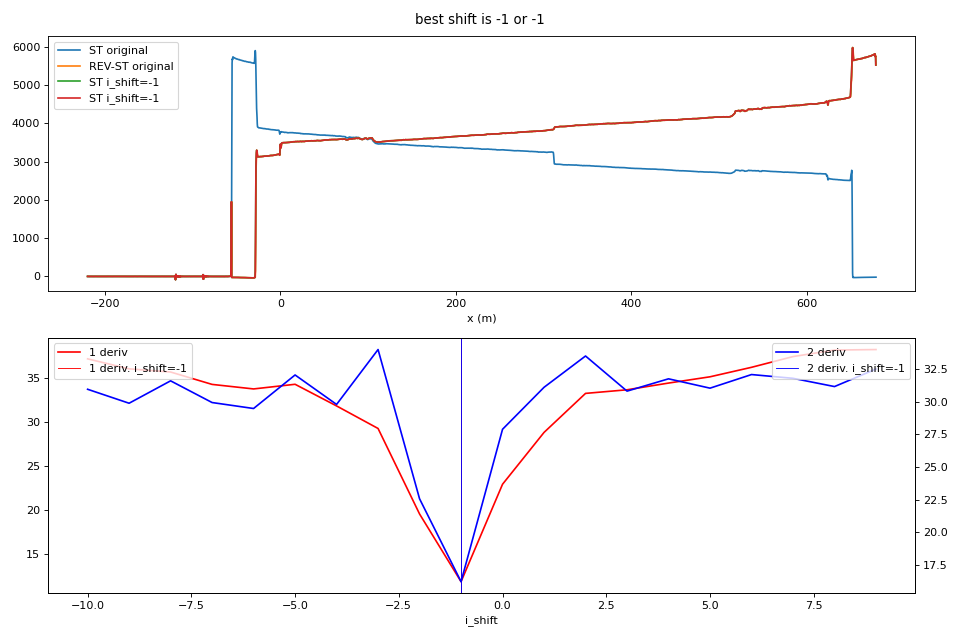

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-26.3, 311.2, None), slice(313, 650.14, None), True)
3 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3553 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


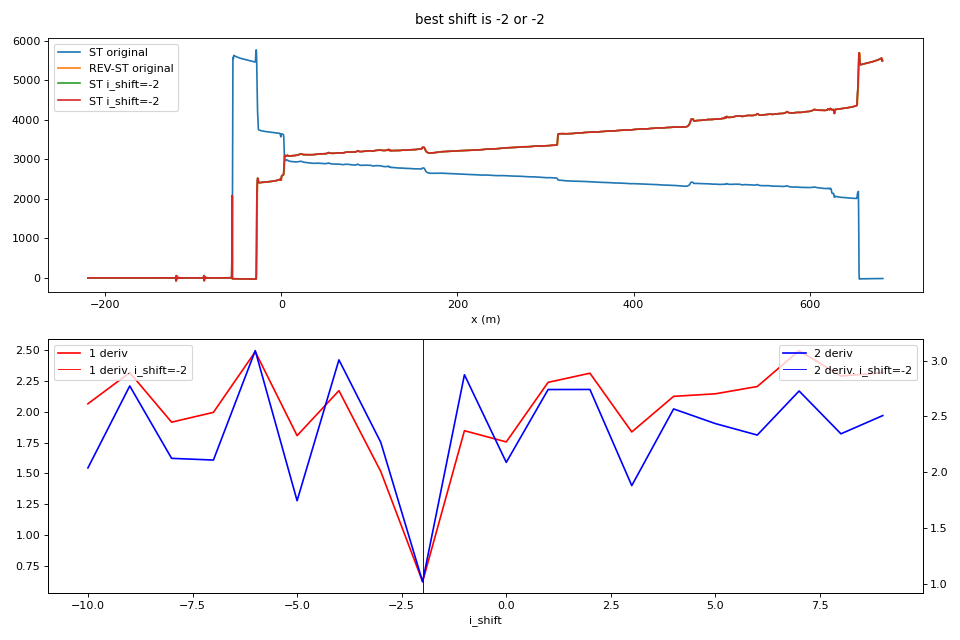

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-27.08, 312.815, None), slice(314.815, 654.71, None), True)


In [371]:
data_testing = {}
for i in filepaths:
    ds = data_processing_matching_sections_test(i)
    data_testing[i[13:]] = ds

<IPython.core.display.Javascript object>


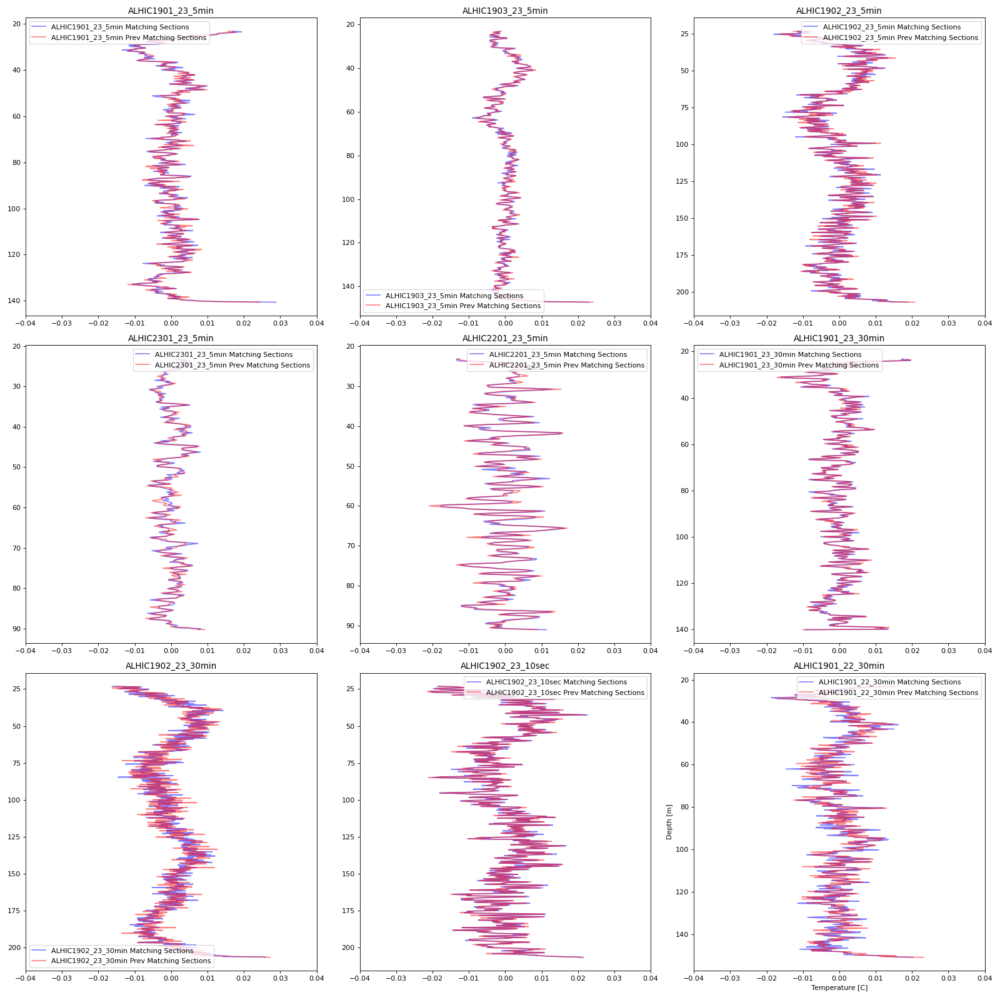

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [337]:
scale_offset = 0

pf = PolynomialFeatures(degree=4)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, ((ax1, ax2, ax3),( ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3,figsize=[20,20])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
for off, (i, c, ax) in enumerate(zip(data_matching_sections, colors, ax_list)):
    print(i)
    x = data_testing[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    X = np.asarray(x)
    X = X.reshape((len(X),1))
    y = data_testing[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    y_no_match = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    Xp = pf.fit_transform(X)
    md2 = LinearRegression()    
    if i == 'ALHIC1901_23_30min':
        for profile in y.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i+' Matching Sections', color='b', alpha=0.5)

        for profile in y_no_match.T:
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)

            md2.fit(Xp, detrend)
            trendp = md2.predict(Xp)
            ax.plot(detrend - trendp + (off * scale_offset),x, label=i+' Prev Matching Sections', color='r', alpha=0.5)
            ax.invert_yaxis()
#             ax.plot(y,x)
        ax.set_xlim([-0.04,0.04])
        ax.set_title(i)
    else:
        detreneded_signals = np.zeros((len(y.T), len(y)))
        for num,profile in enumerate(y.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i+' Matching Sections', color='b', alpha=0.5)

#             ax.plot(y,x)
        detreneded_signals = np.zeros((len(y_no_match.T), len(y_no_match)))
        for num,profile in enumerate(y_no_match.T):
            detrend = scipy.signal.detrend(profile, type='linear', overwrite_data=False)
            detreneded_signals[num] = detrend
        detrend_mean = np.mean(detreneded_signals,axis=0)
        md2.fit(Xp, detrend_mean)
        trendp = md2.predict(Xp)
        ax.plot(detrend_mean.T - trendp + (off * scale_offset),x, label=i+' Prev Matching Sections', color='r', alpha=0.5)
        ax.invert_yaxis()
        ax.set_xlim([-0.04,0.04])
        ax.set_title(i)
#             ax.plot(y,x)


        
for i in ax_list:
    i.legend()

plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

### Calculating Rayleigh number?

In [173]:
g = 9.8
k_vis = 1.48e-5
beta = 1/240
alpha = 15.33e-6
t_surf =243
t_far = 245
l = 100

Ra = ((g*beta)/(k_vis*alpha))*(t_surf-t_far)*(l**3)

In [338]:
### TODO

### 1) align temperature profiles at surface to the same temperature
### 2) Code up a vertical velocity profile (0m/s at bed and tweakable parameter (like 2m/s) at surface).
### 3) Ballpark horizontal temperature gradient based on data.

# Align the broeholes by the same surface temperature.

# Quick investigation of the raw DTS data as well. What does the raw temperature look like without going through the preprocessing steps?

In [339]:
def DTS_raw_load(filepath):
    
    ds = read_silixa_files(
        directory=filepath,
        timezone_netcdf='UTC',
        file_ext='*.xml')

    return ds

In [340]:
data_raw = {}
for i in filepaths:
    ds = DTS_raw_load(i)
    data_raw[i[13:]] = ds


11 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk
31 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk
7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk
13 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk
2 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Record

<IPython.core.display.Javascript object>


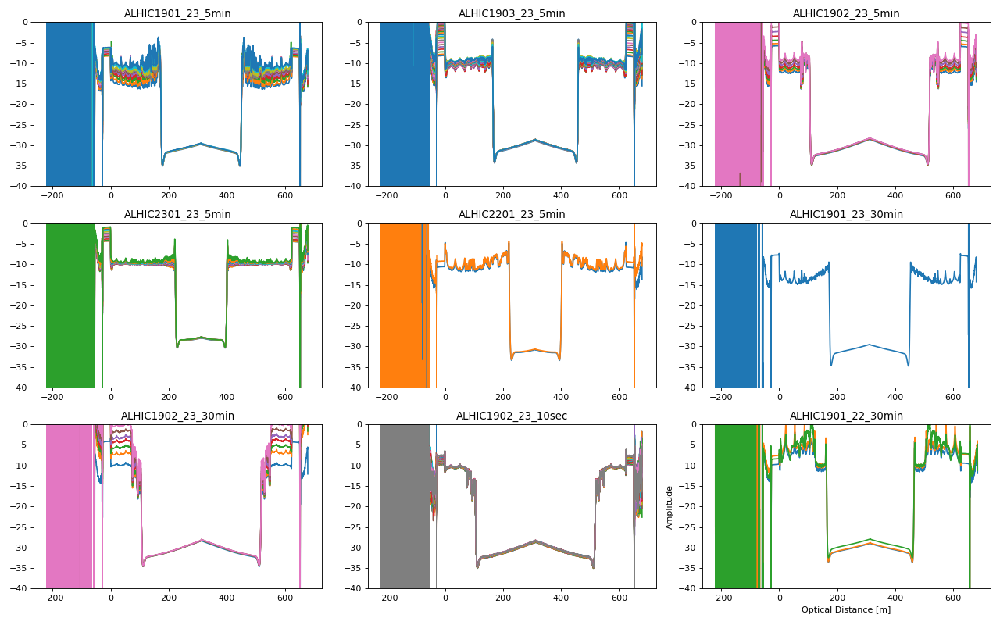

In [343]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data_raw[i].x, data_raw[i].tmp)
    ax.set_ylim([-40,0])
    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
ax1.get_shared_y_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()


<IPython.core.display.Javascript object>


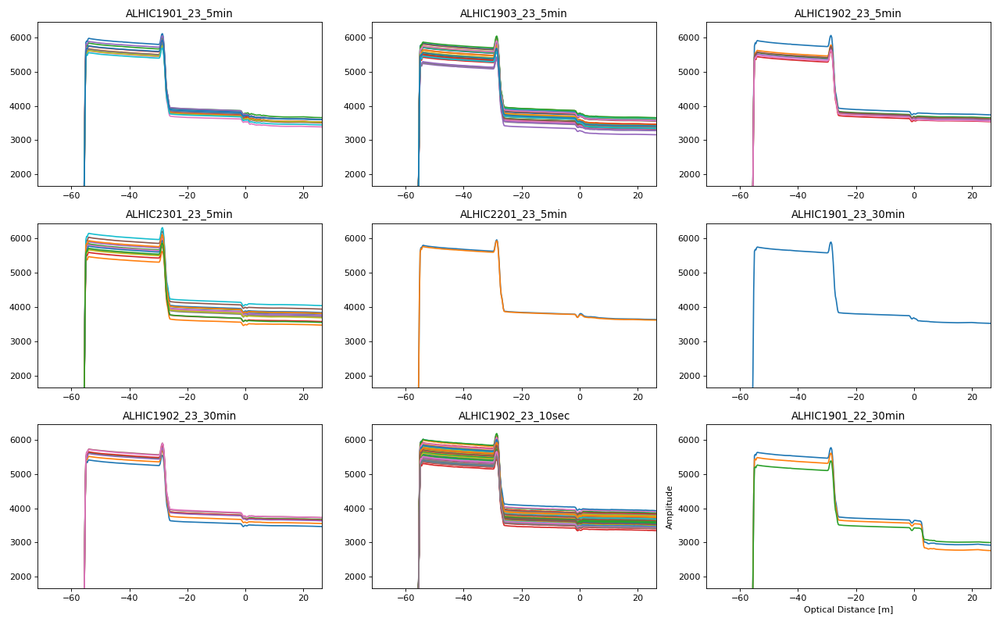

In [346]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data_raw[i].x, data_raw[i].st)

    ax.set_title(i)
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
ax1.get_shared_y_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

### compare the raw against the matching sections

<IPython.core.display.Javascript object>


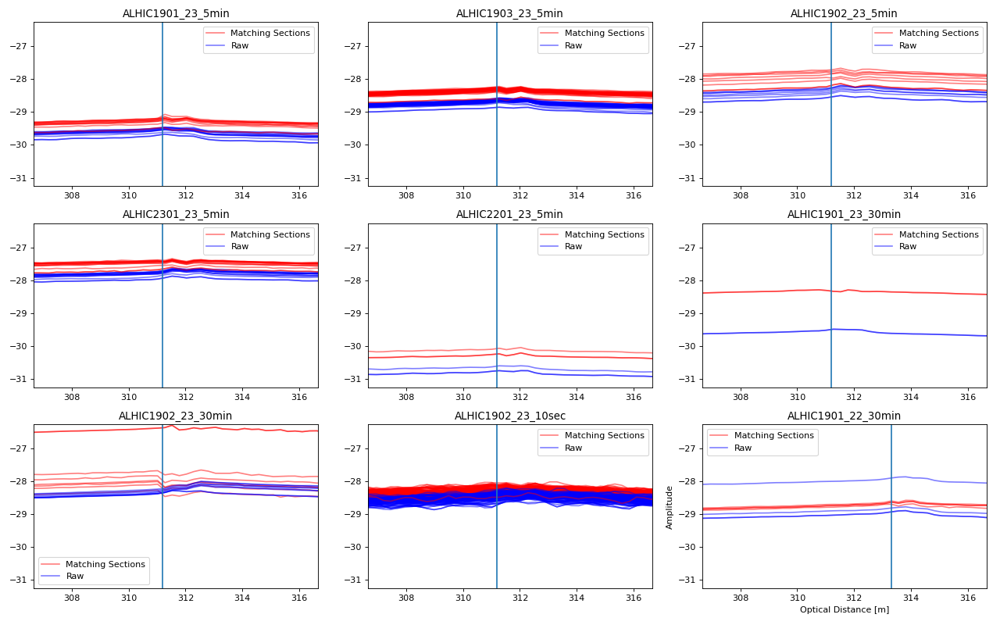

In [369]:
### How did the matching sections turn out? ###

fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data_matching_sections,ax_list):
    ax.plot(data_matching_sections[i].x, data_matching_sections[i].tmpw, color='red', alpha = 0.5)
    ax.plot(data_raw[i].x, data_raw[i].tmp, color='blue', alpha = 0.5)
    
    ax.plot(data_matching_sections[i].x, data_matching_sections[i].tmpw[:,0], color='red', alpha = 0.5, label='Matching Sections')
    ax.plot(data_raw[i].x, data_raw[i].tmp[:,0], color='blue', alpha = 0.5, label='Raw')
    
    ax.plot([matching_sections_dict[i][1][0], matching_sections_dict[i][1][0]], [-40,0])
    
    ax.set_ylim([-30,-25])
    ax.set_xlim([matching_sections_dict[i][1][0]-5, matching_sections_dict[i][1][0]+5])
    ax.set_title(i)
    ax.legend()
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
ax1.get_shared_y_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

<IPython.core.display.Javascript object>


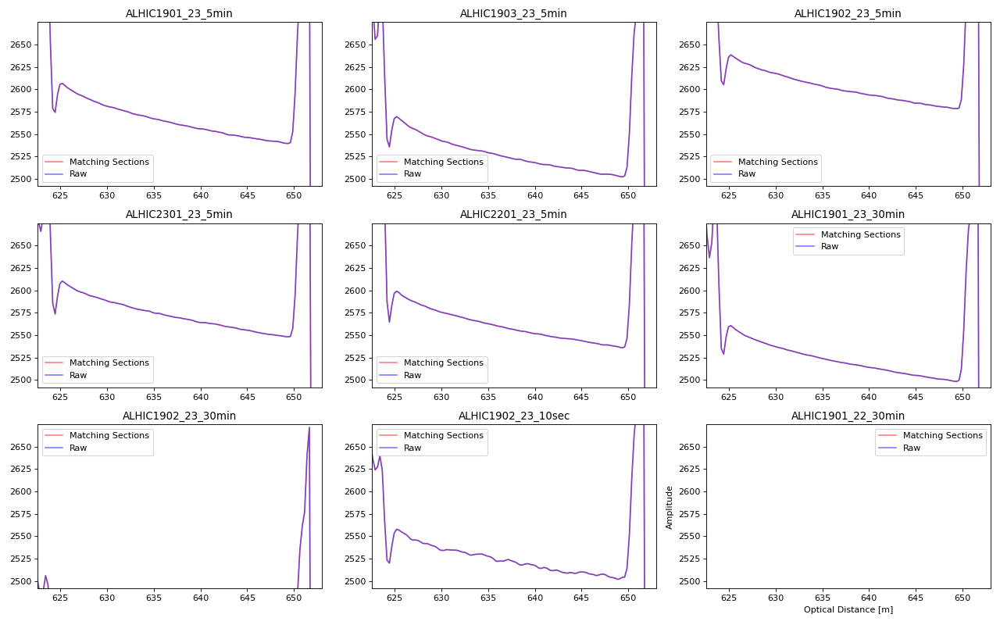

In [370]:
### How did the matching sections turn out? ###

fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data_matching_sections,ax_list):

    ax.plot(data_matching_sections[i].x, data_matching_sections[i].st[:,0], color='red', alpha = 0.5, label='Matching Sections')
    ax.plot(data_raw[i].x, data_raw[i].st[:,0], color='blue', alpha = 0.5, label='Raw')

    ax.set_title(i)
    ax.legend()
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
ax1.get_shared_y_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

# Using the internal reference as matching sections (on both sides of the splice)

In [380]:
## matching sections over just the internal reference sections
matching_sections_int_test = {
    ## (downgoing side) (upgoing side) and True because this has a forward and reverse part
    'ALHIC1901_22_30min': [(slice(-23, -3), slice(633, 653), True), [315]],
    'ALHIC1901_23_5min': [(slice(-23, -3), slice(629, 649), True), [313]],
    'ALHIC1903_23_5min': [(slice(-23, -3), slice(629, 649), True), [313]],
    'ALHIC1902_23_5min': [(slice(-23, -3), slice(629, 649), True), [313]],
    'ALHIC2301_23_5min': [(slice(-23, -3), slice(629, 649), True), [313]],
    'ALHIC2201_23_5min': [(slice(-23, -3), slice(629, 649), True), [313]],
    'ALHIC1901_23_30min': [(slice(-23, -3), slice(629, 649), True), [313]], 
    'ALHIC1902_23_30min': [(slice(-23, -3), slice(629, 649), True), [312.50]], 
    'ALHIC1902_23_10sec': [(slice(-23, -3), slice(629, 649), True), [313]]
}

In [389]:
def data_processing_int_matching(filepath):
    
    ds = read_silixa_files(
        directory=filepath,
        timezone_netcdf='UTC',
        file_ext='*.xml')

    suggested_shift = suggest_cable_shift_double_ended(
        ds,
        np.arange(-10, 10),
        plot_result=True,
        figsize=(12,8))

    ds_restored = shift_double_ended(ds, suggested_shift[0])
    ds = ds_restored

    sections = {
    "referenceTemperature": [slice(-23, -3)], 
    }
    ds.sections = sections
    matching_sections = matching_sections_int_test[filepath[13:]][0]
    print(matching_sections)
    
    st_var, resid = ds.variance_stokes(st_label='st')
    ast_var, _ = ds.variance_stokes(st_label='ast')
    rst_var, _ = ds.variance_stokes(st_label='rst')
    rast_var, _ = ds.variance_stokes(st_label='rast')

    ds.calibration_double_ended(
        st_var=st_var,
        ast_var=ast_var,
        rst_var=rst_var,
        rast_var=rast_var,
        matching_sections=[matching_sections],
        store_tmpw='tmpw',
        method='wls',
        solver='sparse'),
    
    resid.plot(figsize=(12, 4))

    return ds

11 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


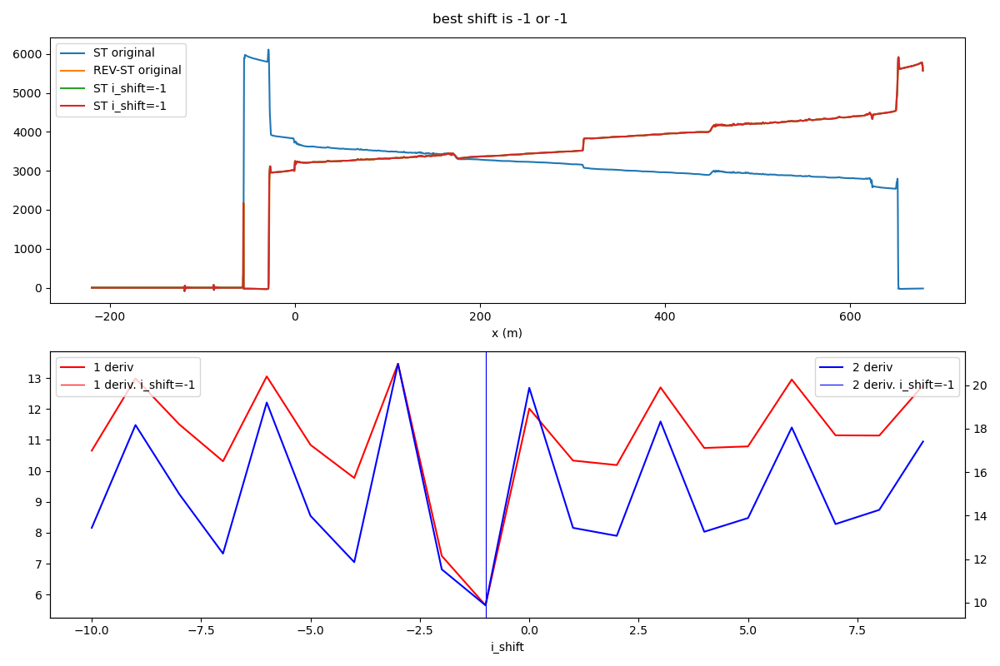

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


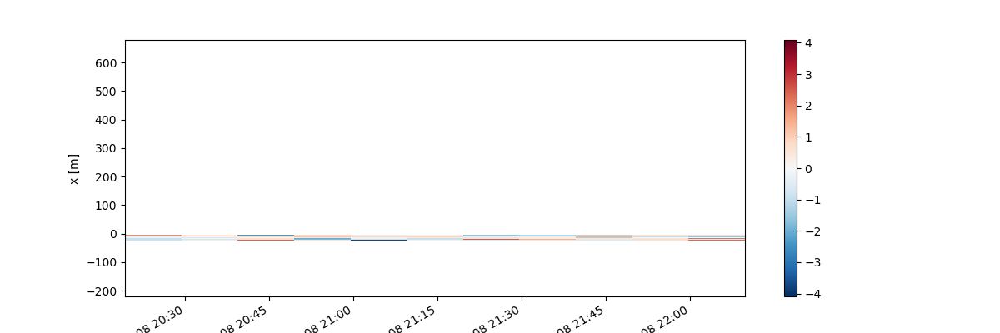

31 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


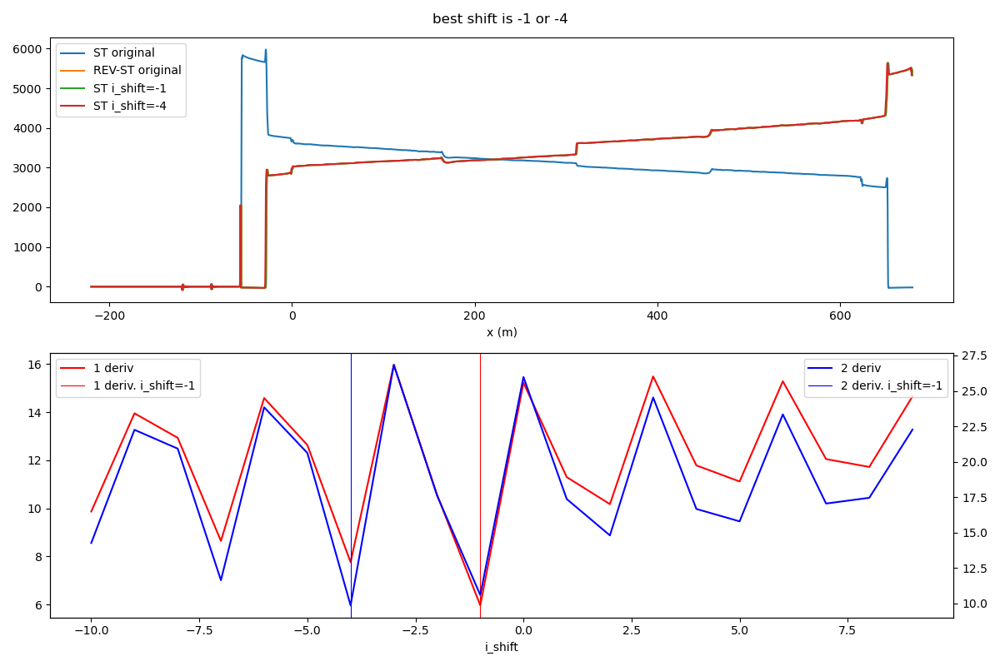

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


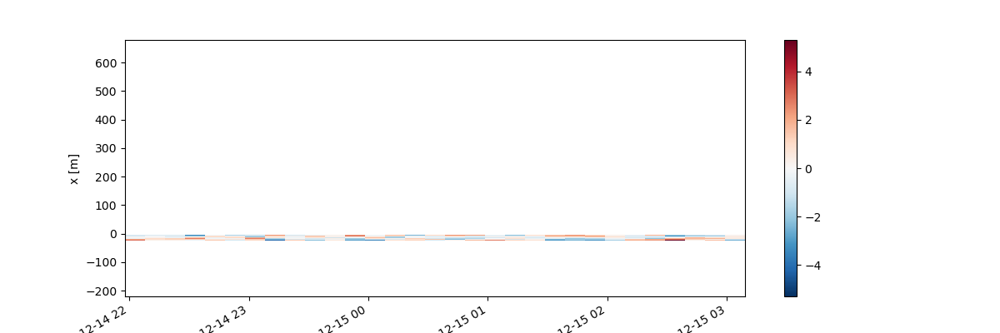

7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


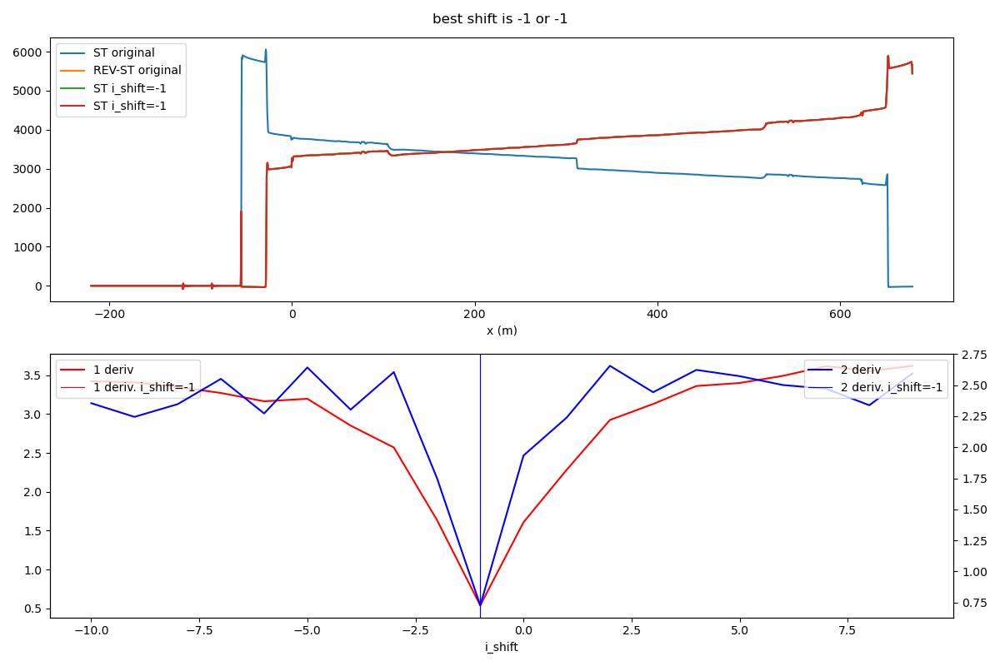

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


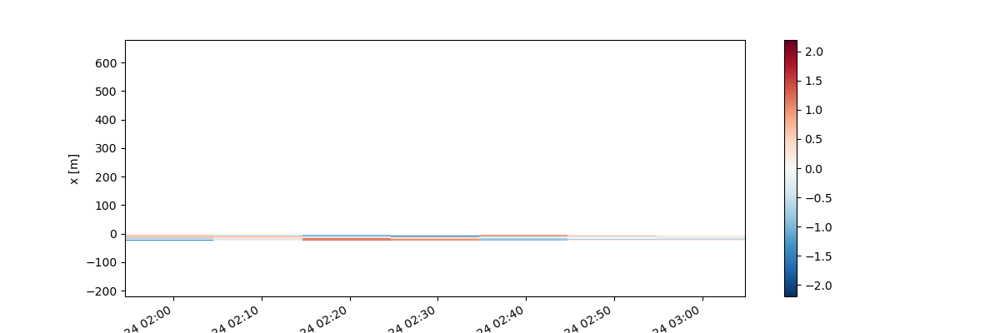

13 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


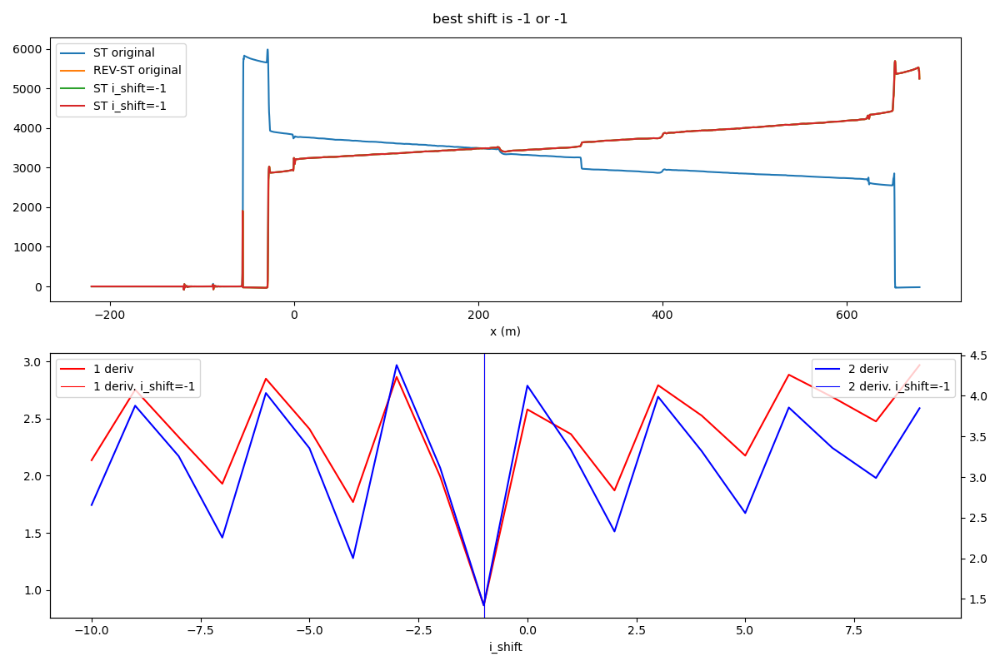

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


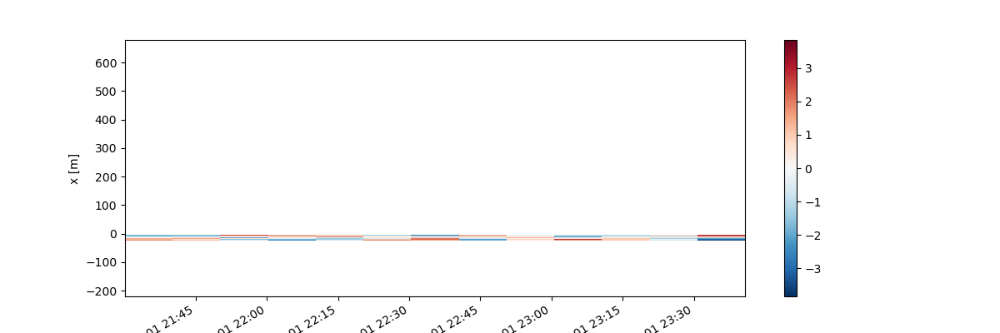

2 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


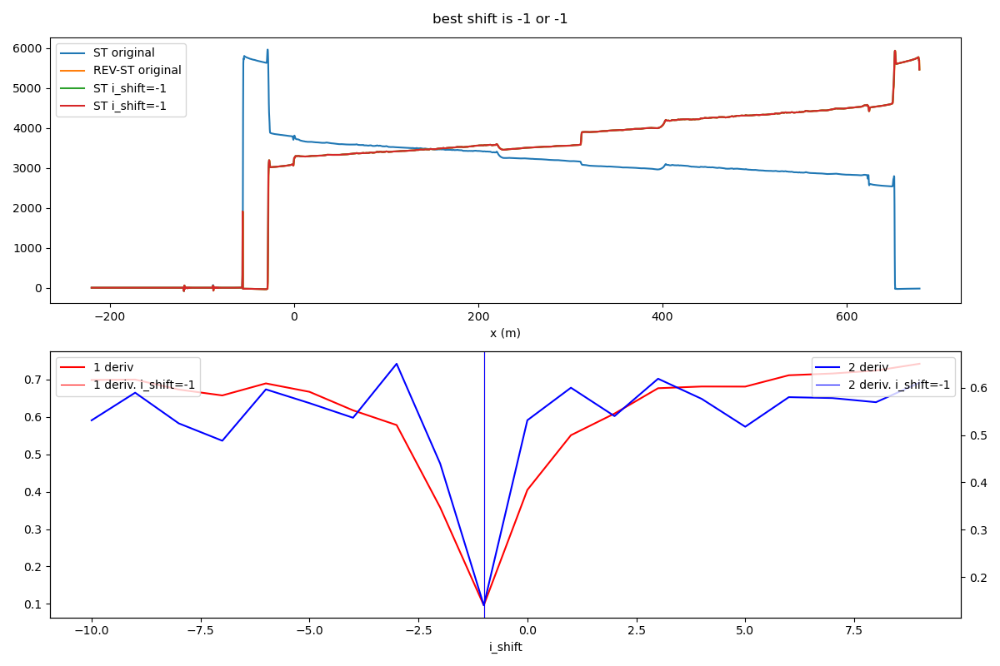

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


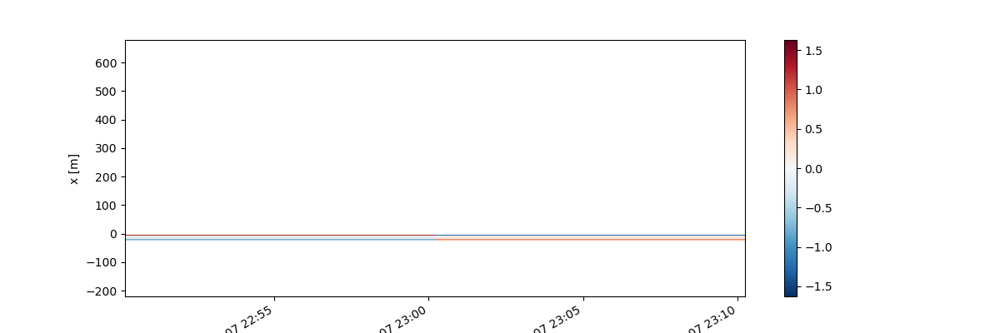

1 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


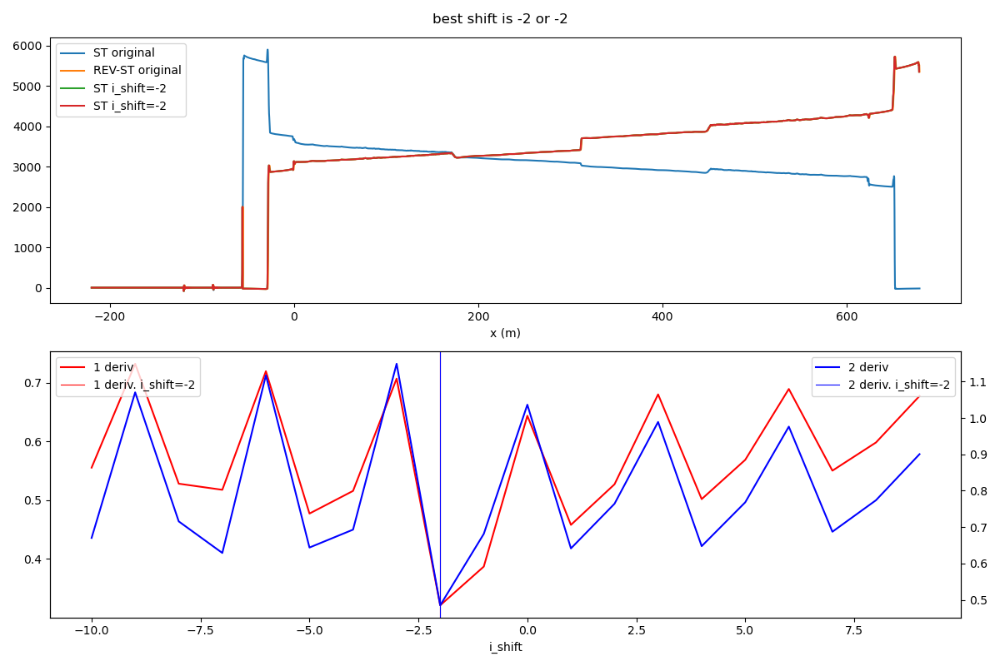

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


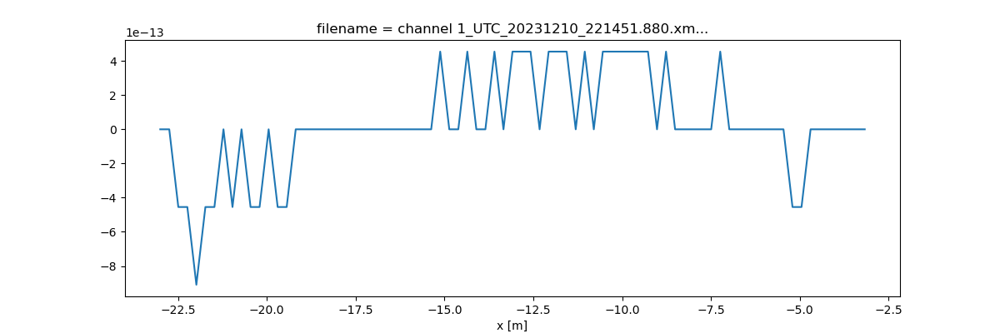

7 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


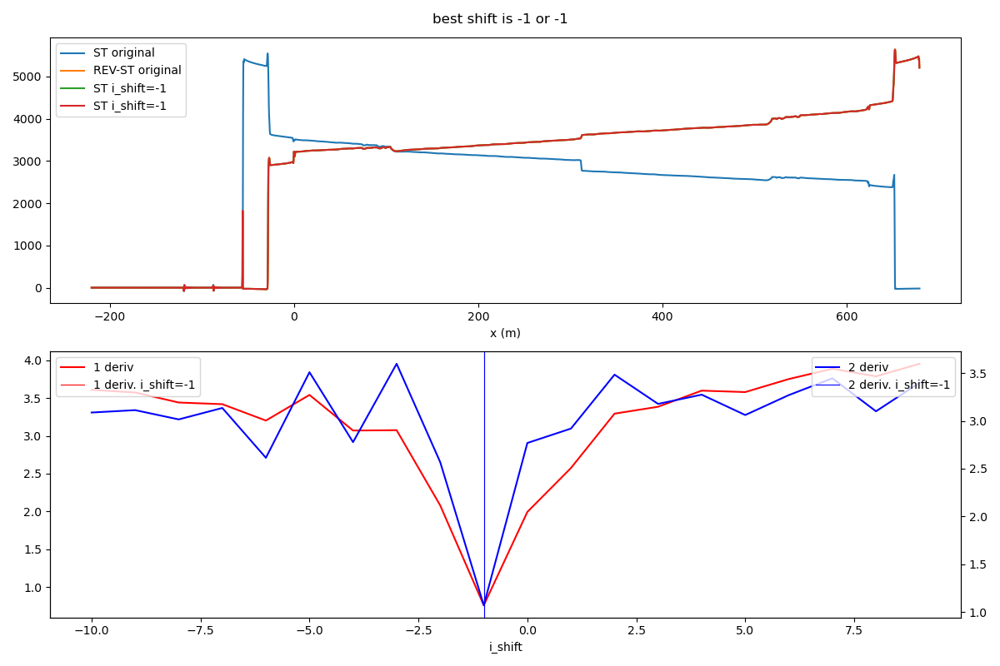

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


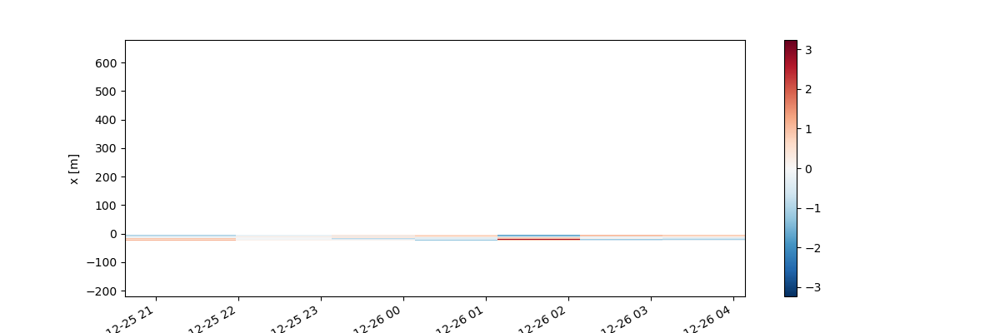

78 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3537 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


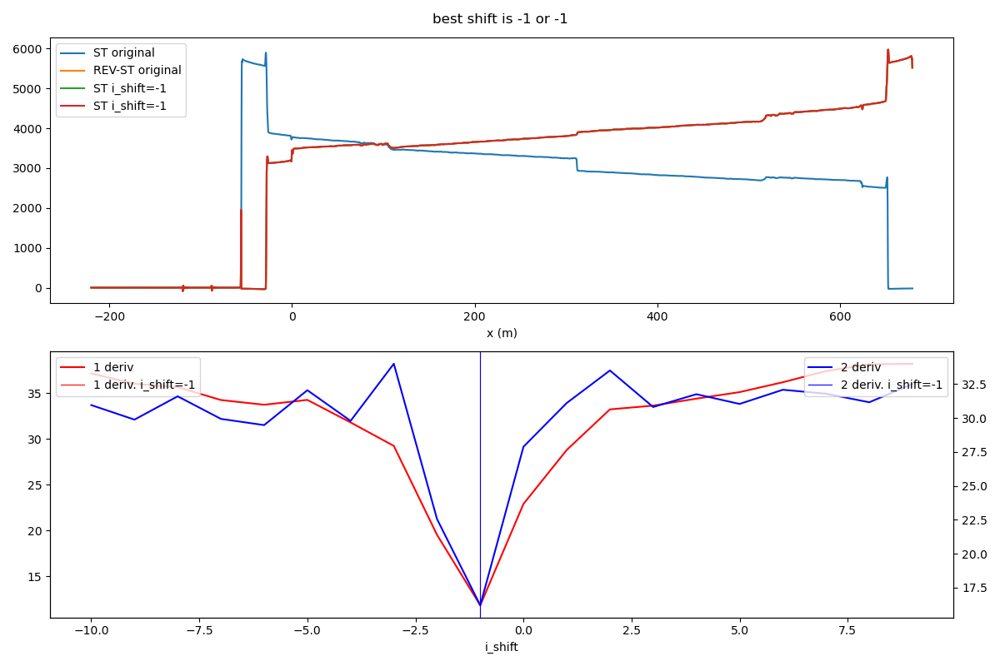

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(629, 649, None), True)


<IPython.core.display.Javascript object>


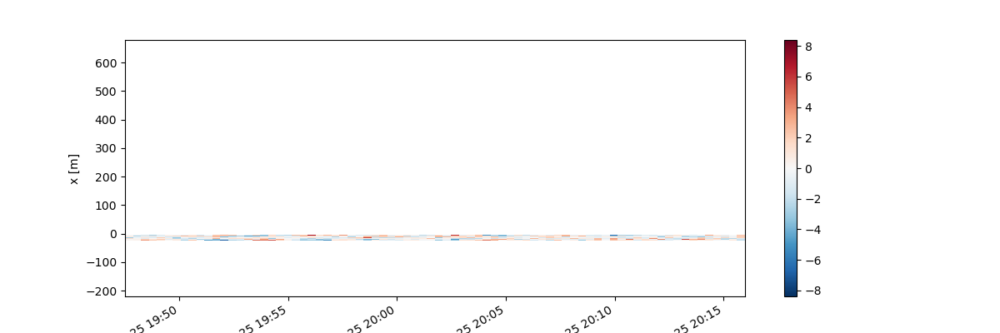

3 files were found, each representing a single timestep
6 recorded vars were found: LAF, ST, AST, REV-ST, REV-AST, TMP
Recorded at 3553 points along the cable
The measurement is double ended
Reading the data from disk


<IPython.core.display.Javascript object>


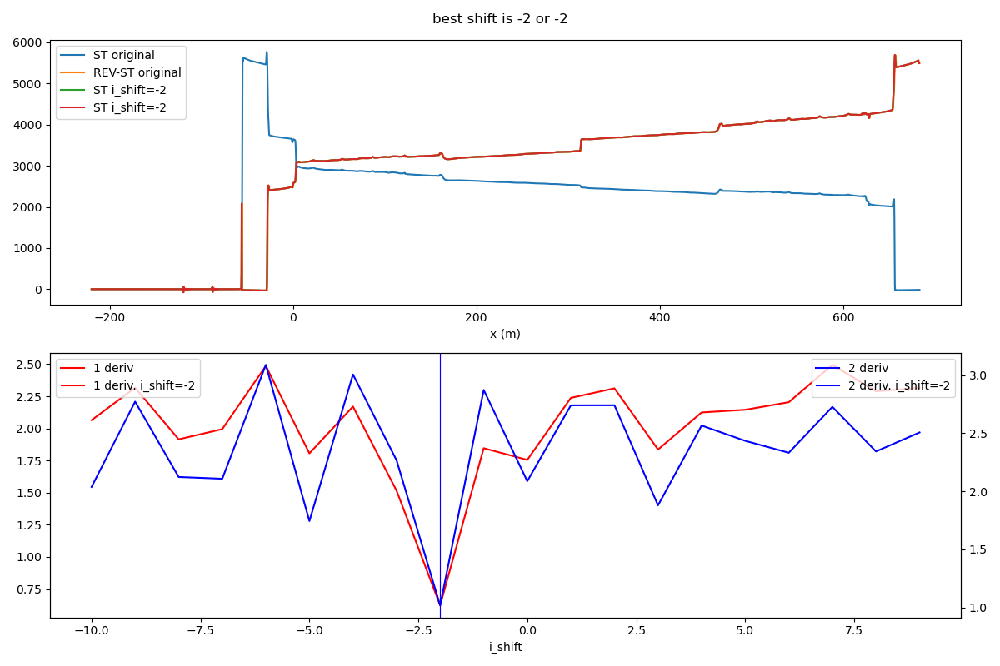

I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
I dont know what to do with the following data ['tmp']
(slice(-23, -3, None), slice(633, 653, None), True)


<IPython.core.display.Javascript object>


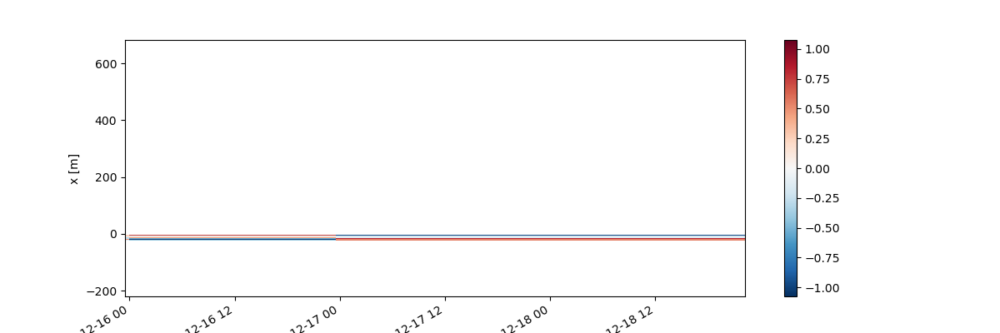

In [390]:
data_int_matching = {}
for i in filepaths:
    ds = data_processing_int_matching(i)
    data_int_matching[i[13:]] = ds


<IPython.core.display.Javascript object>


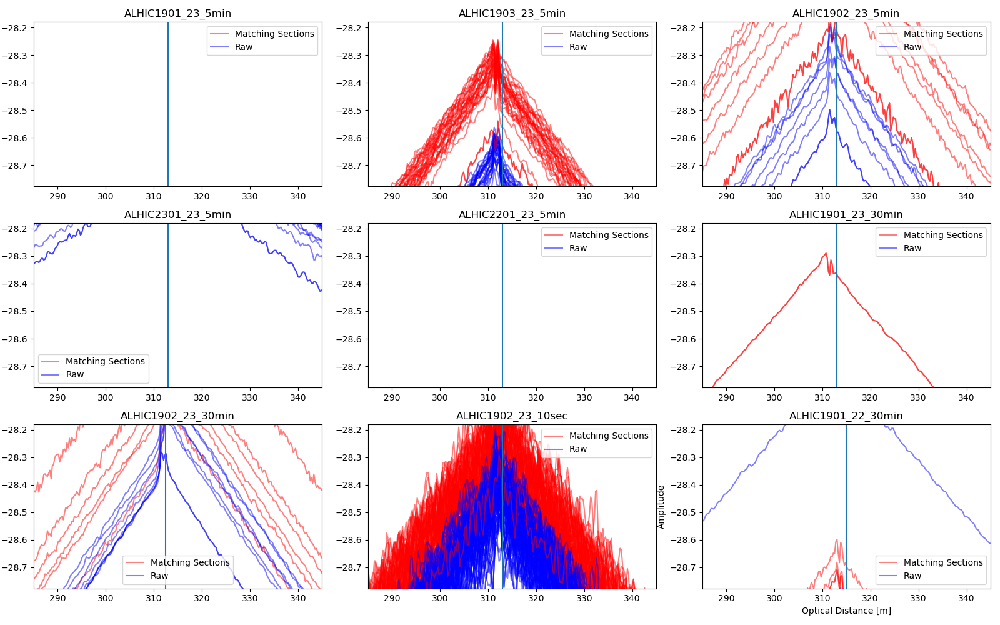

In [394]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize=[16,10])
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i,ax in zip(data,ax_list):
    ax.plot(data_int_matching[i].x, data_int_matching[i].tmpw, color='red', alpha = 0.5)
    ax.plot(data_raw[i].x, data_raw[i].tmp, color='blue', alpha = 0.5)
    
    ax.plot(data_int_matching[i].x, data_int_matching[i].tmpw[:,0], color='red', alpha = 0.5, label='Matching Sections')
    ax.plot(data_raw[i].x, data_raw[i].tmp[:,0], color='blue', alpha = 0.5, label='Raw')
    
    ax.plot([matching_sections_int_test[i][1][0], matching_sections_int_test[i][1][0]], [-40,0])
    ax.set_ylim([-40,0])
    ax.set_title(i)
    ax.legend()
plt.xlabel('Optical Distance [m]')
plt.ylabel('Amplitude')

ax1.get_shared_x_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
ax1.get_shared_y_axes().join(ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9)
plt.tight_layout()

In [722]:
iceotherm

<module 'iceotherm' from '/home/jmanos/notebooks/Antarctica_DTS_allData/iceotherm/__init__.py'>

# What is the 1D model for the temperature profile

In [445]:
#Steady state glacier solution
#Import the ice temperature model and relevant constants.
import importlib
importlib.reload(iceotherm)
from iceotherm.lib.numerical_model import ice_temperature
from iceotherm.lib.analytical_solutions import Robin_T, Rezvan_T, Meyer_T, Perol_T
from iceotherm.lib.ice_properties import conductivity, heat_capacity, rate_factor
from iceotherm.lib.constants import constants
const = constants()

In [447]:
### Initial model conditions ###
nz = 201 #number of model layers
Ts = -30 #sruface temp
H=200. #ice thickness
adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

<IPython.core.display.Javascript object>


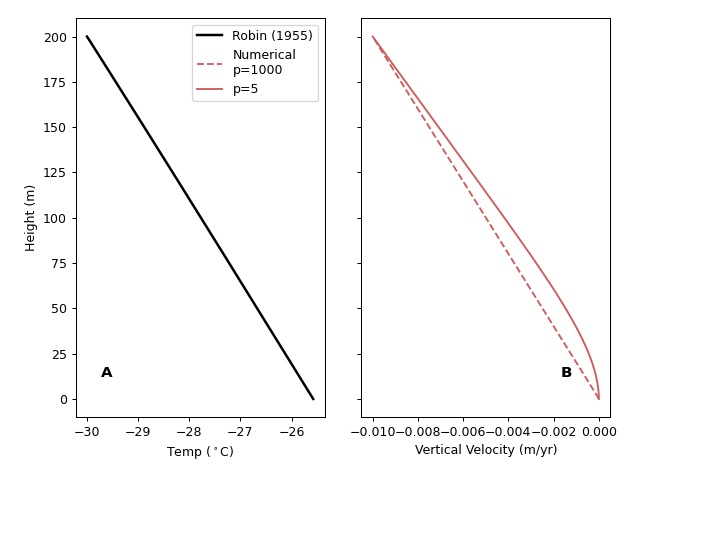

Running model to steady state
.
Running model to steady state
.


In [448]:
# Initialize the model class
m = ice_temperature(nz=nz,
                   Ts = Ts,
                   H = H,
                   adot = adot,
                   qgeo = qgeo)
m.initial_conditions()
m.source_terms()
m.stencil(dt=1.*const.spy)

# Initialize the figure
plt.figure(figsize=(6,4))
ax1 = plt.subplot(121)
ax1.set_ylabel('Height (m)')
ax1.set_xlabel('Temp ($^\circ$C)')
plt.text(.1,.1,'A',transform=ax1.transAxes,fontweight='bold',fontsize=12)
ax2 = plt.subplot(122)
ax2.tick_params(labelleft=False)
ax2.set_xlabel('Vertical Velocity (m/yr)')
plt.text(.8,.1,'B',transform=ax2.transAxes,fontweight='bold',fontsize=12)
plt.tight_layout()

# Run and plot the analytical solution
TR,Mrate = Robin_T(m)
ax1.plot(TR,m.z,'k-',lw=2,label='Robin (1955)')
# Run and plot the numerical solution in the case of a linear vertical velocity profile (p=1000)
m.numerical_to_steady_state()
ax1.plot(m.T,m.z,'--',c='indianred',label='Numerical\np=1000')
# Plot the vertical velocity profile
ax2.plot(m.v_z*const.spy,m.z,'--',c='indianred')

# As a comparison, use a more divide-like vertical velocity profile
m.p = 5.
m.initial_conditions()
m.source_terms()
m.stencil(dt=1.*const.spy)

# Run and plot the numerical solution
m.numerical_to_steady_state()
ax1.plot(m.T,m.z,'-',c='indianred',label='p=%.0f'%m.p)
ax2.plot(m.v_z*const.spy,m.z,'-',c='indianred')

# Figure output
ax1.legend()
plt.tight_layout()
plt.savefig('Robin_reproduce_analytical.png',dpi=300)

# Can we plot the numerical solution against each borehole?

### We will also re-run the solution for each thickness of the boreholes

In [492]:
### Initial model conditions ###
nz = 10 #number of model layers
Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

<IPython.core.display.Javascript object>


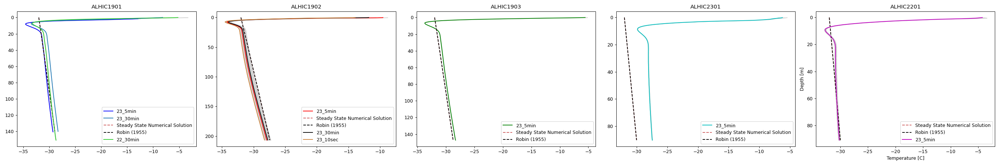

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
.
ALHIC1902_23_5min
Running model to steady state
.
ALHIC2301_23_5min
Running model to steady state
.
ALHIC2201_23_5min
Running model to steady state
.
ALHIC1901_23_30min
Running model to steady state
.
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [493]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        # Initialize the model class
        m = ice_temperature(nz=nz,
                           Ts = Ts,
                           H = H,
                           adot = adot,
                           qgeo = qgeo)
        m.initial_conditions()
        m.source_terms()
        m.stencil(dt=1.*const.spy)
        TR,Mrate = Robin_T(m)
        m.numerical_to_steady_state()
        
        ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
        ax1.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax2.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax2.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax3.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax3.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax4.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax4.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax5.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax5.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

## OK, we are going to do the same thing, but more intelligently pick the surface temperature.

In [496]:
### Initial model conditions ###
nz = 10 #number of model layers
# Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

<IPython.core.display.Javascript object>


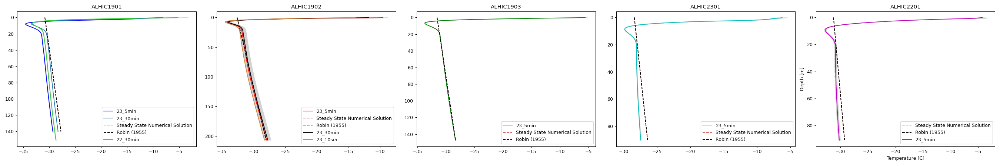

ALHIC1901_23_5min
ALHIC1903_23_5min
-31.57642164106704
Running model to steady state
.
ALHIC1902_23_5min
-32.601698162128066
Running model to steady state
.
ALHIC2301_23_5min
-28.423891308609754
Running model to steady state
.
ALHIC2201_23_5min
-31.23627005726398
Running model to steady state
.
ALHIC1901_23_30min
-30.832007951313347
Running model to steady state
.
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [505]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        print(Ts)
        # Initialize the model class
        m = ice_temperature(nz=nz,
                           Ts = Ts,
                           H = H,
                           adot = adot,
                           qgeo = qgeo)
        m.initial_conditions()
        m.source_terms()
        m.stencil(dt=1.*const.spy)
        TR,Mrate = Robin_T(m)
        m.numerical_to_steady_state()
        
        ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
        ax1.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            print(Ts)
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax2.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax2.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            print(Ts)
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax3.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax3.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            print(Ts)
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax4.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax4.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            print(Ts)
            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=1.*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()

            ax5.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax5.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# OK, so now we have a good steady state condition for a forward model given a surface temperature

In [612]:
def heat(t_surf,
        init_prof,
         tmax = 1000,
         tmin = 0,
         zmax = 100,
         dTdz = 0.02,
         nz = 39,
         nt = 99,
         alpha = 35,
         accumulation = 0,
         S = np.nan

        ):
    
    '''
    Solves the advection/diffusion equation with mixed temperature/heat flux boundary conditions
    '''
    
    if np.isnan(S).any():
        S = np.zeros((nz+1,nt+1))
        
    z0=0    
    dz = zmax/(nz+1)
    dt = (tmax-tmin)/nt
    t = np.linspace(tmin,tmax, nt+1)
    z = np.linspace(dz,zmax, nz+1)
    
    alpha = alpha * ((tmax - tmin) / (nt)) #This gets the diffusivity into the correct units given variable time steps 
    
    cfl = alpha*dt/(dz**2)
    Azz = np.diag([1+2*cfl] * (nz+1)) + np.diag([-cfl] * (nz),k=1)\
        + np.diag([-cfl] * (nz),k=-1)

    w = - accumulation * np.ones(nz)
    abc = w*dt/(2*dz)
    Az = np.diag(abc,k=1) - np.diag(abc,k=-1)
    Az[0,:] =0
    Az[-1,:]=0
    A = Azz - Az


    # Neumann boundary condition
    A[nz,nz-1] = -2*cfl
    b= np.zeros((nz+1,1))
    b[nz] =  2*cfl*dz * dTdz

    # Initial condition: gradient equal to basal gradient and equal to surface temp.
    U = np.zeros((nz+1,nt+1))
    U[:,0] = init_prof

    for k in range(nt):
        b[0] = cfl*t_surf[k]    #  Dirichlet boundary condition

        c = U[:,k] + b.flatten() + S[:,k+1]*dt # previous values + dirichlet + sources
        U[:,k+1] = np.linalg.solve(A,c)

    return U,t,z

In [719]:
### Initial model conditions ###
nz = 50 #number of model layers
# Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)
dS=0. #surface slope

### Initial model conditions ###
tmax = 2024
tmin = 1924
adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)
dTdz = 0.046
nt = 99
alpha = 35
accumulation = adot

<IPython.core.display.Javascript object>


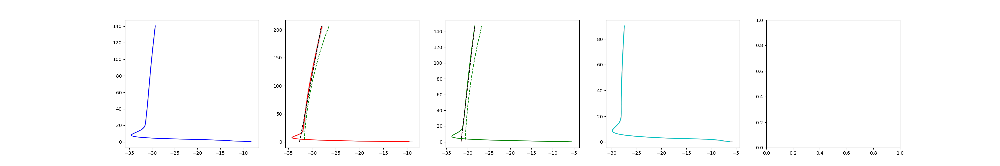

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
.
ALHIC1902_23_5min
Running model to steady state
.
ALHIC2301_23_5min
Running model to steady state
..................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

KeyboardInterrupt: 

In [720]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        print(Ts)
        # Initialize the model class
        m = ice_temperature(nz=nz,
                           Ts = Ts,
                           H = H,
                           adot = adot,
                           qgeo = qgeo,
                           dS=dS)
        m.initial_conditions()
        m.source_terms()
        m.stencil(dt=0.05*const.spy)
        TR,Mrate = Robin_T(m)
        m.numerical_to_steady_state()
        
        t_surf = np.linspace(Ts,Ts+1,nt)
        
        U,t,z = heat(t_surf,
                     m.T[::-1],
                     tmax = tmax,
                     tmin = tmin,
                     zmax = H,
                     dTdz = qgeo,
                     nz = nz-1,
                     nt = nt,
                     alpha = alpha,
                     accumulation = accumulation)
        
        ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
        ax1.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
        ax1.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                           dS=dS)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=0.05*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = np.linspace(Ts,Ts+1,nt)
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax2.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax2.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax2.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                           dS=dS)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=0.05*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = np.linspace(Ts,Ts+1,nt)
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax3.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax3.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax3.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                           dS=dS)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=0.05*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = np.linspace(Ts,Ts+1,nt)
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax4.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax4.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax4.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                           dS=dS)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=0.05*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = np.linspace(Ts,Ts+1,nt)
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)

            ax5.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax5.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            
            ax5.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# Ok great, now can we model the surface using the inverse problem of the boreholes?

In [615]:
def heat_foreword(t_surf,
         tmax = 1000,
         tmin = 0,
         zmax = 100,
         dTdz = 0.02,
         nz = 39,
         nt = 99,
         alpha = 35,
         accumulation = 0,
         S = np.nan 
        ):
    
    '''
    Solves the advection/diffusion equation with mixed temperature/heat flux boundary conditions
    '''
    
    if np.isnan(S).any():
        S = np.zeros((nz+1,nt+1))
        
    z0=0    
    dz = zmax/(nz+1)
    dt = (tmax-tmin)/nt
    t = np.linspace(tmin,tmax, nt+1)
    z = np.linspace(dz,zmax, nz+1)
    
    alpha = alpha * ((tmax - tmin) / (nt))
    
    cfl = alpha*dt/(dz**2)
    Azz = np.diag([1+2*cfl] * (nz+1)) + np.diag([-cfl] * (nz),k=1)\
        + np.diag([-cfl] * (nz),k=-1)

    w = - accumulation * np.ones(nz)
    abc = w*dt/(2*dz)
    Az = np.diag(abc,k=1) - np.diag(abc,k=-1)
    Az[0,:] =0
    Az[-1,:]=0
    A = Azz - Az


    # Neumann boundary condition
    A[nz,nz-1] = -2*cfl
    b= np.zeros((nz+1,1))
    b[nz] =  2*cfl*dz * dTdz

    # Initial condition: gradient equal to basal gradient and equal to surface temp.
    U = np.zeros((nz+1,nt+1))
    U[:,0] = t_surf[0] + z*dTdz

    for k in range(nt):
        b[0] = cfl*t_surf[k]    #  Dirichlet boundary condition

        c = U[:,k] + b.flatten() + S[:,k+1]*dt # previous values + dirichlet + sources
        U[:,k+1] = np.linalg.solve(A,c)

    return U,t,z

### First we have to do the inverse problem

In [576]:
from scipy.signal import detrend

In [716]:
### Initial model conditions ###
nz = 50 #number of layers in the ice column
# Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

### Initial model conditions ###

tmax = 2024
tmin = 1924
adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)
dTdz = 0.046
nt = 99
alpha = 35
accumulation = adot
tol = 1e-2

In [713]:


t_surf = np.eye(nt)

A = np.zeros((nt+1,nz+1))

for i in range(nt): #this was for i in range(nt)
    this_t_surf = t_surf[i,:]
#     if i == 20: this_t_surf = 10*this_t_surf
    U,t,z = heat_foreword(this_t_surf,
         tmax = tmax,
         tmin = tmin,
         zmax = H,
         dTdz = qgeo,
         nz = nz,
         nt = nt,
         alpha = alpha,
         accumulation = adot)
    now = U[:,-1]
    A[i,:] = now
A = A.T
#     print(z.shape)
#     heat_plot(t, t_surf, 0, 1000, z, U)

(99, 100)


<IPython.core.display.Javascript object>


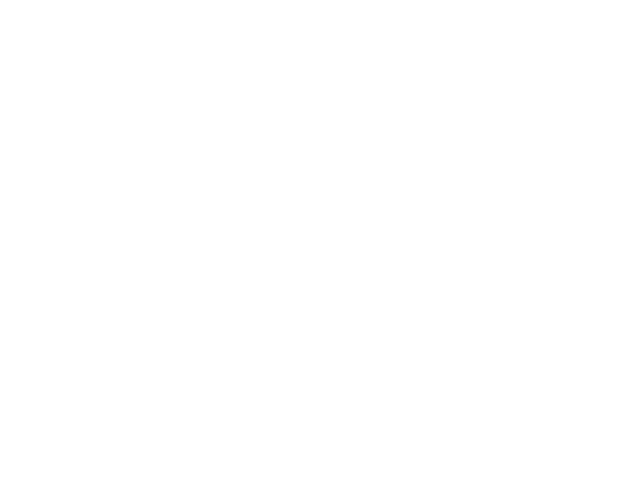

<IPython.core.display.Javascript object>


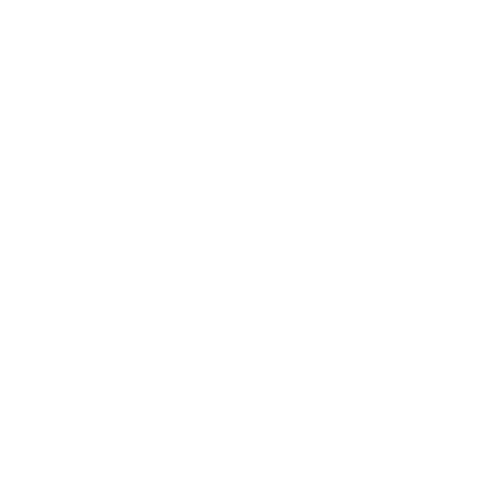

[1.21877062e+00 5.87236603e-01 2.44743488e-01 9.16958930e-02
 3.28781905e-02 1.09845042e-02 3.34680595e-03 9.15695987e-04
 2.22884288e-04 4.80845851e-05 9.19517099e-06 1.56176248e-06
 2.36273757e-07 3.19412458e-08 3.87135579e-09 4.22077801e-10
 4.15330228e-11 3.70105150e-12 2.99231301e-13 9.28420725e-14
 2.27772951e-14 1.66097401e-14 1.00020637e-14 8.56163404e-15
 6.75497755e-15 6.14264025e-15 5.65759407e-15 5.39748727e-15
 5.25844334e-15 4.74171554e-15 4.68445410e-15 4.37965214e-15
 4.29993382e-15 4.23357130e-15 4.06851216e-15 4.01945154e-15
 3.87334572e-15 3.71437498e-15 3.64965335e-15 3.47690599e-15
 3.35663177e-15 3.32196852e-15 2.99741440e-15 2.90194915e-15
 2.81065824e-15 2.72323056e-15 2.65308237e-15 2.56533673e-15
 2.46485743e-15 2.43412505e-15 2.30744005e-15 2.25397598e-15
 2.07096485e-15 1.95489831e-15 1.84116813e-15 1.74561929e-15
 1.70840600e-15 1.62631627e-15 1.48811841e-15 1.47970453e-15
 1.43599277e-15 1.34738781e-15 1.30165786e-15 1.24364553e-15
 1.18898381e-15 1.180691

<IPython.core.display.Javascript object>


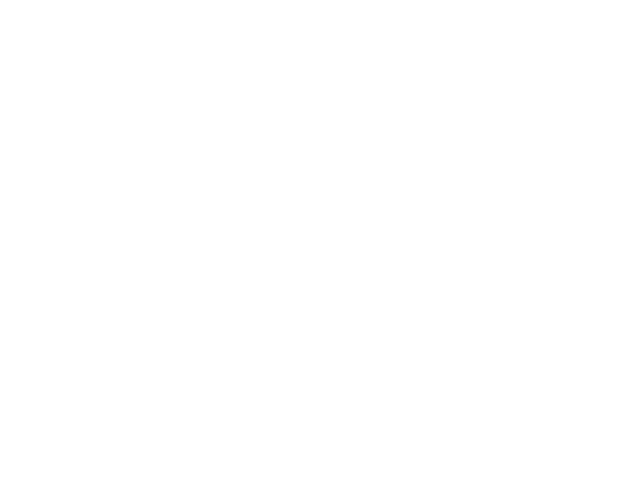

Text(0.5, 0, 'Year')

In [714]:
G_matrix = detrend(A,axis=0)
print(G_matrix.shape)

fig, ax = plt.subplots()
ax.imshow(G_matrix, aspect = 'auto', vmin=-.01, vmax=.01)
plt.show()

G_copy = G_matrix


#Singular value decomposition
u, s, v_T = np.linalg.svd(G_copy, full_matrices=True)


#Plotting the singular values
fig,ax = plt.subplots(figsize=[5,5])
plt.scatter(np.arange(0,len(s)),s)
ax.set_xlabel('Index')
ax.set_ylabel('Singular Value')
ax.set_yscale('log')
#ax.set_xlim([0,10])
print(s)
#fig.savefig('singular_values.eps')
plt.show()

p = 4 #Applying the thresholding
u_p = u[:,:p]
s_p = np.diag(s[:p])
vh_p = v_T.T[:,:p]

print('U_p =\n', u_p)
print('S_p =\n',s_p)
print('V_p =\n',vh_p)

#Now finding the generalized G matrix

g_gen = u_p @ s_p @ vh_p.T
print('G = \n', g_gen)

#And the inverse Gen G matrix

u_p_transpose = u_p.T
s_p_inv = np.linalg.inv(s_p)

g_inv = vh_p @ s_p_inv @ u_p_transpose

print('G^-g = \n', g_inv)

#model estimates
#m_est = g_inv @ anomaly.values
m_est = g_inv @ mean.values[::6]

# m_est = g_inv[:,:-1] @ mean_tot.sel(x=slice(start_of_borehole,bottom_trend)).values

fig,ax = plt.subplots()
ax.plot(t,m_est)
ax.set_ylabel('Temperature Anomaly (K)')
ax.set_xlabel('Year')

In [ ]:
m_est.shape

<IPython.core.display.Javascript object>


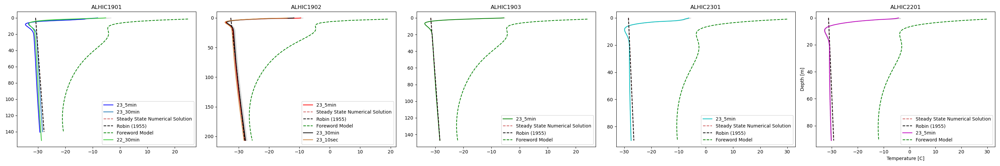

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
.
ALHIC1902_23_5min
Running model to steady state
.
ALHIC2301_23_5min
Running model to steady state
.
ALHIC2201_23_5min
Running model to steady state
.
ALHIC1901_23_30min
-30.832007951313347
Running model to steady state
.
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [715]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        print(Ts)
        # Initialize the model class
        m = ice_temperature(nz=nz,
                           Ts = Ts,
                           H = H,
                           adot = adot,
                           qgeo = qgeo,
                            tol=tol)
        m.initial_conditions()
        m.source_terms()
        m.stencil(dt=.01*const.spy)
        TR,Mrate = Robin_T(m)
        m.numerical_to_steady_state()
        
        t_surf = m_est
        
        U,t,z = heat(t_surf,
                     m.T[::-1],
                     tmax = tmax,
                     tmin = tmin,
                     zmax = H,
                     dTdz = qgeo,
                     nz = nz-1,
                     nt = nt,
                     alpha = alpha,
                     accumulation = accumulation)
        
        ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
        ax1.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
        ax1.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                               tol=tol)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=.01*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = m_est
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax2.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax2.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax2.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                               tol=tol)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=.01*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = m_est
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax3.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax3.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax3.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                               tol=tol)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=.01*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = m_est
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)


            ax4.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax4.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')
            ax4.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Initialize the model class
            m = ice_temperature(nz=nz,
                               Ts = Ts,
                               H = H,
                               adot = adot,
                               qgeo = qgeo,
                               tol=tol)
            m.initial_conditions()
            m.source_terms()
            m.stencil(dt=.01*const.spy)
            TR,Mrate = Robin_T(m)
            m.numerical_to_steady_state()
            
            t_surf = m_est
        
            U,t,z = heat(t_surf,
                         m.T[::-1],
                         tmax = tmax,
                         tmin = tmin,
                         zmax = H,
                         dTdz = qgeo,
                         nz = nz-1,
                         nt = nt,
                         alpha = alpha,
                         accumulation = accumulation)

            ax5.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
            ax5.plot(TR[::-1],m.z,'--',c='black',label='Robin (1955)')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            
            ax5.plot(U[:,-1],z,'--',c='green',label='Foreword Model')
            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# Can we actually do this inversion better? Why is ours so different?

In [626]:
import math

In [665]:
### Initial model conditions ###
nz = 10 #number of layers in the ice column
# Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

### Initial model conditions ###

tmax = 2024
tmin = 1924
adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)
dTdz = 0.046
nt = 399
alpha = 35
accumulation = adot

p =  6 #Applying the thresholding

t = np.linspace(0,(tmax - tmin),nt+1)
k_diff = 1.09e-6 * 3.154e+7 * ((tmax - tmin) / (nt)) ## * 3.154e7

In [666]:
## Ok we will try to plot the complimentary error function diffusion stuff individually for each depth.

<IPython.core.display.Javascript object>


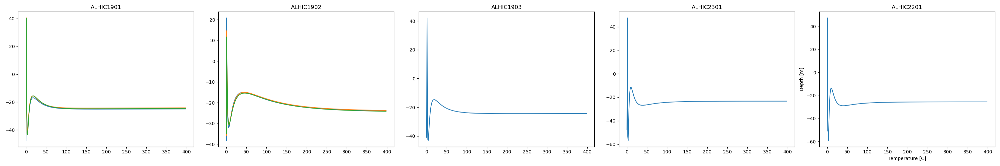

ALHIC1901_23_5min
ALHIC1903_23_5min
ALHIC1902_23_5min
ALHIC2301_23_5min
ALHIC2201_23_5min
ALHIC1901_23_30min
ALHIC1902_23_30min
ALHIC1902_23_10sec
ALHIC1901_22_30min


In [668]:
scale_offset = 0

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
    z =x
    if i == 'ALHIC1901_23_30min':
    
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax1.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)
        
        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)
        

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]
        
        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
        
        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax1.plot(m_est[2:] + m_est[0])
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax1.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)
        
        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)
        

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]
        
        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
        
        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax1.plot(m_est[2:] + m_est[0])

    elif i[0:9] == 'ALHIC1902':

        x = x.values #ice thickness

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

        #ax2.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax2.plot(m_est[2:] + m_est[0])
            
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':

        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax3.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)


        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]


        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose


        mean = np.mean(y, axis=1)

        m_est = g_inv @ mean.values

        ax3.plot(m_est[2:] + m_est[0])
        #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':

        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))


        #ax4.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax4.plot(m_est[2:] + m_est[0])
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':

            
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.22
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))


        #ax5.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
                    #model estimates

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax5.plot(m_est[2:] + m_est[0])
        #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):

    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# Ok. Doing the same thing as above but disregarding the top 20 ish meters.

In [678]:
### Initial model conditions ###
nz = 10 #number of layers in the ice column
# Ts = -32 #sruface temp

adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

### Initial model conditions ###

tmax = 2024
tmin = 1924
adot=-0.01 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)
dTdz = 0.046
nt = 99
alpha = 35
accumulation = adot

p =  5 #Applying the thresholding

t = np.linspace(0,(tmax - tmin),nt+1)
k_diff = 1.09e-6 * 3.154e+7 * ((tmax - tmin) / (nt)) ## * 3.154e7

<IPython.core.display.Javascript object>


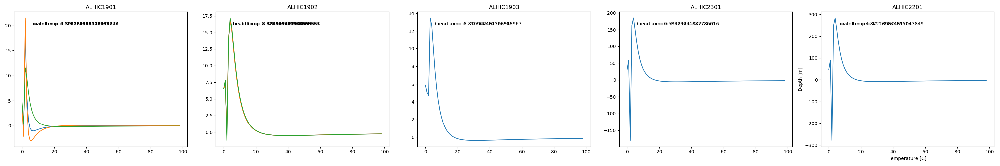

ALHIC1901_23_5min
mean temp = -24.26178611044827
heat flux = -9.704714444178762
ALHIC1903_23_5min
mean temp = -22.027401206985967
heat flux = -8.810960482795746
ALHIC1902_23_5min
mean temp = -22.058437448100364
heat flux = -8.823374979238265
ALHIC2301_23_5min
mean temp = 1.453241372735016
heat flux = 0.5812965448778061
ALHIC2201_23_5min
mean temp = 12.180674617043849
heat flux = 4.87226984485504
ALHIC1901_23_30min
mean temp = -23.750199703753758
heat flux = -9.500079881492901
ALHIC1902_23_30min
mean temp = -21.925266373660627
heat flux = -8.77010654946403
ALHIC1902_23_10sec
mean temp = -22.306200937348233
heat flux = -8.922480374939038
ALHIC1901_22_30min
mean temp = -23.230203508618672
heat flux = -9.292081403447533


In [679]:

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).tmpw
    z =x
    if i == 'ALHIC1901_23_30min':
    
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax1.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)
        
        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)
        

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]
        
        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
        
        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax1.plot(m_est[2:])
        ax1.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax1.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax1.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)
        
        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)
        

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]
        
        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
        
        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax1.plot(m_est[2:])
        
        ax1.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax1.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))
    elif i[0:9] == 'ALHIC1902':

        x = x.values #ice thickness

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))


        #ax2.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax2.plot(m_est[2:])
        ax2.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax2.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':

        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))
        #ax3.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)


        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]


        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose


        mean = np.mean(y, axis=1)

        m_est = g_inv @ mean.values

        ax3.plot(m_est[2:])
        
        ax3.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax3.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))

    elif i[0:9] == 'ALHIC2301':

        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))


        #ax4.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)

        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax4.plot(m_est[2:])
        ax4.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax4.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))
    elif i[0:9] == 'ALHIC2201':

            
        x = x.values

        A_jk = np.zeros(shape = (len(z), len(t)-1))
        A_jk_beltrami = np.zeros(shape = (len(z), len(t)+1))
        A_jk_beltrami[:,0], A_jk_beltrami[:,1] = 1, 1/2.5
        for k in range(len(t) - 1):
            for j in range(len(z)):
                #print(t[k])
                #A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k])))) - (math.erfc(z[j] / (2*np.sqrt(k_diff * t[k+1]))))
                A_jk[j,k] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))

                # This A_jk is evaluated following Beltrami 
                A_jk_beltrami[j,k+2] = (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k])))) - (math.erfc(z[j] / (2*np.sqrt((k_diff**2) * t[k+1]))))


        #ax5.imshow(detrend(A_jk_beltrami, axis=0), aspect ='auto', vmin = -1e-2, vmax =1e-2)

        u, s, v_T = np.linalg.svd(A_jk_beltrami, full_matrices=True)


        u_p = u[:,:p]
        s_p = np.diag(s[:p])
        vh_p = v_T.T[:,:p]

        #Now finding the generalized G matrix

        g_gen = u_p @ s_p @ vh_p.T
        # print('G = \n', g_gen)

        #And the inverse Gen G matrix

        u_p_transpose = u_p.T
        s_p_inv = np.linalg.inv(s_p)

        g_inv = vh_p @ s_p_inv @ u_p_transpose
                    #model estimates

        mean = np.mean(y, axis=1)
        m_est = g_inv @ mean.values

        ax5.plot(m_est[2:])
        ax5.annotate('mean temp = '+str(m_est[0]),(0.1,.9),xycoords='axes fraction')
        ax5.annotate('heat flux = '+str(m_est[1]),(0.1,.9),xycoords='axes fraction')
        print('mean temp = '+str(m_est[0]))
        print('heat flux = '+str(m_est[1]))
boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):

    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# OK, here we will model the evolution of borehole temperature with variable surface temperature.

In [747]:
import numpy as np
import matplotlib.pyplot as plt
# %matplotlib widget

# If the icetemperature library is not in your PYTHONPATH, you will not be able to load those functions
# Check and update here if necessary
import sys
cs_dir = '/home/jmanos/notebooks/iceotherm/'
if cs_dir not in sys.path:
    sys.path.append(cs_dir)

# Import the ice temperature model and relevant constants
from iceotherm.lib.numerical_model import ice_temperature
from iceotherm.lib.ice_properties import conductivity, heat_capacity
from iceotherm.lib.constants import constants
const = constants()

# Interpolator for density profile
from scipy.interpolate import interp1d

In [745]:
byrd_data = np.genfromtxt("temp_data/byrd_temps.csv", delimiter=",", usemask=False)
annual = byrd_data[1:,1]
annual_cal = annual - 4 #Temperature adjustment for the Allan Hills
year = byrd_data[1:,0]

<IPython.core.display.Javascript object>


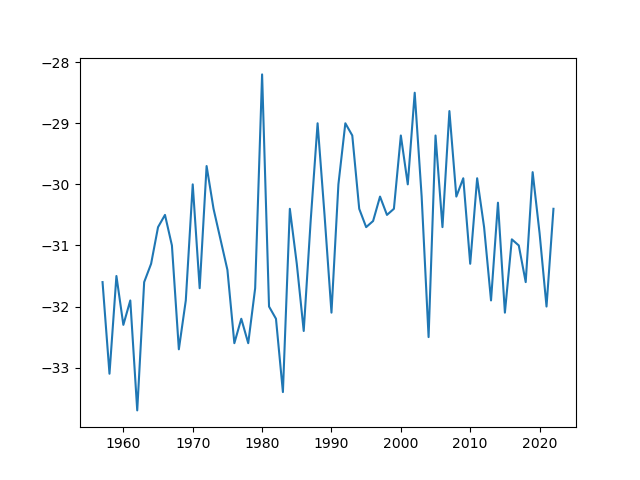

In [746]:
fig, ax = plt.subplots()
ax.plot(year,annual_cal)
plt.show()

In [784]:
### Initial model conditions ###
nz = 20 #number of layers in the ice column
# Ts = -32 #sruface temp
H=200
### Initial model conditions ###

tmax = year[-1]
tmin = year[0]
adot=-0.022 #Accumulation rate (m/yr)
qgeo=0.046 #Geothermal Flux (W/m2)

nt = len(year)

accumulation = adot

k_diff = 1.09e-6 * 3.154e+7 * ((tmax - tmin) / (nt)) ## * 3.154e7

step = .25

<IPython.core.display.Javascript object>


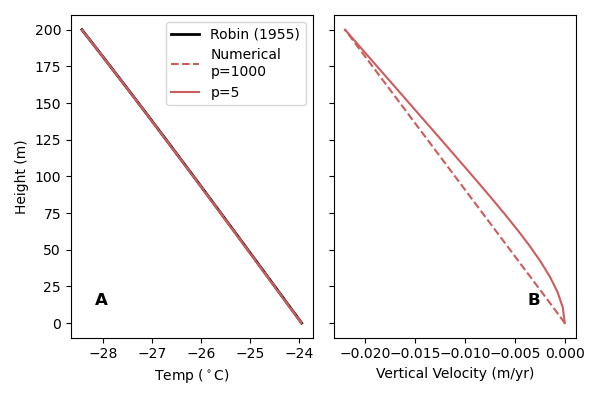

Running model to steady state
.
Running model to steady state
.


In [785]:
### First, lets iniate a model to steady state given glacier geometry ###

# Initialize the model class
m = ice_temperature(nz=nz,
                   Ts = Ts,
                   H = H,
                   adot = adot,
                   qgeo = qgeo)
m.initial_conditions()
m.source_terms()
m.stencil(dt=step*const.spy)

# Initialize the figure
plt.figure(figsize=(6,4))
ax1 = plt.subplot(121)
ax1.set_ylabel('Height (m)')
ax1.set_xlabel('Temp ($^\circ$C)')
plt.text(.1,.1,'A',transform=ax1.transAxes,fontweight='bold',fontsize=12)
ax2 = plt.subplot(122)
ax2.tick_params(labelleft=False)
ax2.set_xlabel('Vertical Velocity (m/yr)')
plt.text(.8,.1,'B',transform=ax2.transAxes,fontweight='bold',fontsize=12)
plt.tight_layout()

# Run and plot the analytical solution
TR,Mrate = Robin_T(m)
ax1.plot(TR,m.z,'k-',lw=2,label='Robin (1955)')
# Run and plot the numerical solution in the case of a linear vertical velocity profile (p=1000)
m.numerical_to_steady_state()
ax1.plot(m.T,m.z,'--',c='indianred',label='Numerical\np=1000')
# Plot the vertical velocity profile
ax2.plot(m.v_z*const.spy,m.z,'--',c='indianred')

# As a comparison, use a more divide-like vertical velocity profile
m.p = 5.
m.initial_conditions()
m.source_terms()
m.stencil(dt=step*const.spy)

# Run and plot the numerical solution
m.numerical_to_steady_state()
ax1.plot(m.T,m.z,'-',c='indianred',label='p=%.0f'%m.p)
ax2.plot(m.v_z*const.spy,m.z,'-',c='indianred')

# Figure output
ax1.legend()
plt.tight_layout()
# plt.savefig('Robin_reproduce_analytical.png',dpi=300)

In [786]:
# Instantiate the model class
m = ice_temperature(
    Ts=annual_cal[0],
    adot=adot,
    H=H,
    qgeo=qgeo,
    p=1000.,
    dS=0)


# upsample the time data and temperature data #
year_new = np.linspace(year[0], year[-1], num=10001)
temp_new = np.interp(year_new, year, annual_cal)

# Set the time step to 5 years and subsample the paleoclimate data to match
m.ts = year_new*const.spy
m.adot_s = np.asarray([adot]*len(year_new))/const.spy
m.Ts_s = temp_new

# Set velocity terms
m.Udef=0.
m.Uslide=0.5/const.spy

# Longitudinal advection forcing

m.dTs = 0
m.dH = 0.1
m.da = 0.
m.flags.append('long_advection')

# Thermal conductivity should be temperature and density dependent; set here
m.flags.append('temp-dependent')
m.initial_conditions()


# Initialize the model to steady state
m.source_terms()
m.stencil()
m.numerical_to_steady_state()

# Run the model
m.flags.append('save_all')
m.numerical_transient()

Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1957 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1970 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1976 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1989 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1996 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2002 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2009 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2015 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2022 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; 

<IPython.core.display.Javascript object>


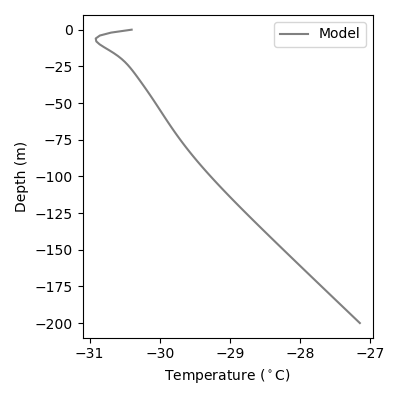

In [787]:
# Plot the model output against the measured temperature profile
plt.figure(figsize=(4,4))

plt.plot(m.T,m.z-m.H,c='grey',label='Model')
plt.ylabel('Depth (m)')
plt.xlabel('Temperature ($^\circ$C)')
plt.legend()
plt.tight_layout()

# Great, can we now get this roughly working for all borehole geometries?

<IPython.core.display.Javascript object>


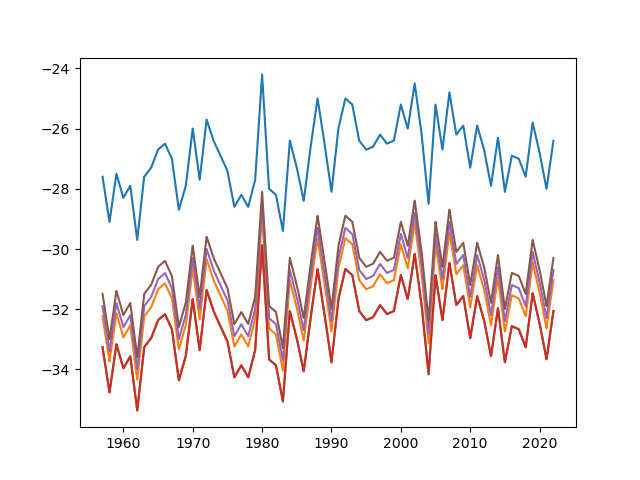

<IPython.core.display.Javascript object>


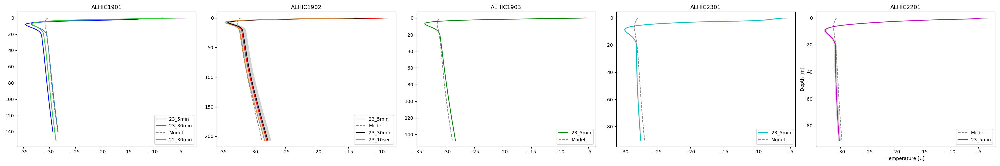

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1957 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1970 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1976 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1989 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1996 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2002 ; dt = 0.006499999999999989 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2009 ; dt = 0.006499999999999989 ; melt rate 

In [828]:
scale_offset = 0

# Load the surface temp data at Byrd Station #
byrd_data = np.genfromtxt("temp_data/byrd_temps.csv", delimiter=",", usemask=False)
annual = byrd_data[1:,1]
year = byrd_data[1:,0]

fig,ax = plt.subplots()

ax.plot(year, annual)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0





for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        
        
        # We need to calibrate the temperature for the mean surface #
        calibration = np.mean(annual) - Ts
        annual_cal = annual - calibration
        
        # Instantiate the model class
        m = ice_temperature(
            Ts=annual_cal[0],
            adot=adot,
            H=H,
            qgeo=qgeo,
            p=1000.,
            dS=10)


        # upsample the time data and temperature data #
        year_new = np.linspace(year[0], year[-1], num=10001)
        temp_new = np.interp(year_new, year, annual_cal)
        
        ax.plot(year_new, temp_new)
        # Set the time step to 5 years and subsample the paleoclimate data to match
        m.ts = year_new*const.spy
        m.adot_s = np.asarray([adot]*len(year_new))/const.spy
        m.Ts_s = temp_new

        # Set velocity terms
        m.Udef=0.
        m.Uslide=0.2/const.spy

        # Longitudinal advection forcing

        m.dTs = 0
        m.dH = 0.3
        m.da = 0.
        m.flags.append('long_advection')

        # Thermal conductivity should be temperature and density dependent; set here
        m.flags.append('temp-dependent')
        m.initial_conditions()


        # Initialize the model to steady state
        m.source_terms()
        m.stencil()
        m.numerical_to_steady_state()

        # Run the model
        m.flags.append('save_all')
        m.numerical_transient()
        ax1.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=annual_cal[0],
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=10001)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()

            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax2.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=annual_cal[0],
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=15)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=10001)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.1
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()

            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax3.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration
            ax.plot(year_new, temp_new)
            # Instantiate the model class
            m = ice_temperature(
                Ts=annual_cal[0],
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=10001)
            temp_new = np.interp(year_new, year, annual_cal)

            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()

            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax4.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=annual_cal[0],
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=10001)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()

            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax5.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

In [829]:
year_new

array([1957.    , 1957.0065, 1957.013 , ..., 2021.987 , 2021.9935,
       2022.    ])

# OK cool, what happens if we add the seasonal resolution of data as well? 

<IPython.core.display.Javascript object>


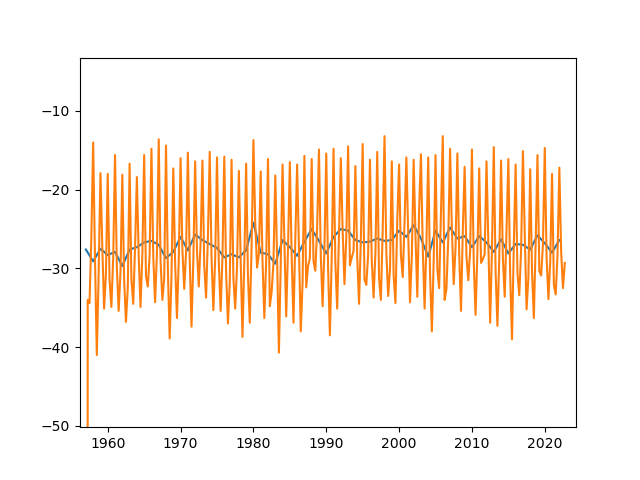

In [820]:
# Load the surface temp data at Byrd Station #
byrd_data = np.genfromtxt("temp_data/byrd_temps.csv", delimiter=",", usemask=False)
annual = byrd_data[1:,1]
year = byrd_data[1:,0]

seasonal = byrd_data[1:,2:]
seasonal = np.reshape(byrd_data[1:,2:], seasonal.shape[0]*seasonal.shape[1])

times_seasonal = np.linspace(year[0],year[-1]+.75, len(seasonal))

fig,ax = plt.subplots()

ax.plot(year, annual)
ax.plot(times_seasonal,seasonal)

<IPython.core.display.Javascript object>


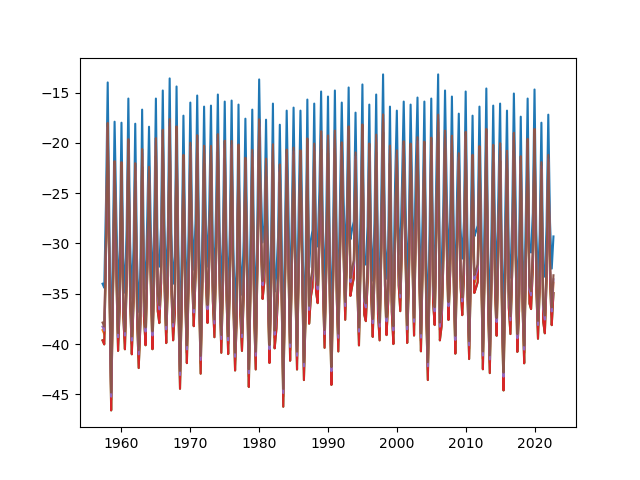

<IPython.core.display.Javascript object>


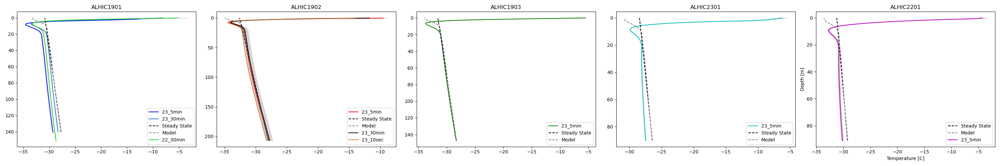

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1957 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1970 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1976 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1990 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1996 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.006550000000000012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2009 ; dt = 0.006550000000000012 ; melt rate 

In [841]:
scale_offset = 0

# Load the surface temp data at Byrd Station #
byrd_data = np.genfromtxt("temp_data/byrd_temps.csv", delimiter=",", usemask=False)
annual = byrd_data[1:,1]
year = byrd_data[1:,0]

seasonal = byrd_data[1:,2:]
seasonal = np.reshape(byrd_data[1:,2:], seasonal.shape[0]*seasonal.shape[1])



year = np.linspace(year[0],year[-1]+.75, len(seasonal))
annual = seasonal

# skip the first reading
annual = annual[1:]
year = year[1:]

fig,ax = plt.subplots()

ax.plot(year, annual)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0

num_steps = 10001



for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        
        
        # We need to calibrate the temperature for the mean surface #
        calibration = np.mean(annual) - Ts
        annual_cal = annual - calibration
        
        # Instantiate the model class
        m = ice_temperature(
            Ts=Ts,
            adot=adot,
            H=H,
            qgeo=qgeo,
            p=1000.,
            dS=10)


        # upsample the time data and temperature data #
        year_new = np.linspace(year[0], year[-1], num=num_steps)
        temp_new = np.interp(year_new, year, annual_cal)
        
        ax.plot(year_new, temp_new)
        # Set the time step to 5 years and subsample the paleoclimate data to match
        m.ts = year_new*const.spy
        m.adot_s = np.asarray([adot]*len(year_new))/const.spy
        m.Ts_s = temp_new

        # Set velocity terms
        m.Udef=0.
        m.Uslide=0.2/const.spy

        # Longitudinal advection forcing

        m.dTs = 0
        m.dH = 0.3
        m.da = 0.
        m.flags.append('long_advection')

        # Thermal conductivity should be temperature and density dependent; set here
        m.flags.append('temp-dependent')
        m.initial_conditions()


        # Initialize the model to steady state
        m.source_terms()
        m.stencil()
        m.numerical_to_steady_state()
        ax1.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
        # Run the model
        m.flags.append('save_all')
        m.numerical_transient()
        ax1.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
        
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=num_steps)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax2.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax2.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=15)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=num_steps)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.1
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax3.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax3.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration
            ax.plot(year_new, temp_new)
            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=num_steps)
            temp_new = np.interp(year_new, year, annual_cal)

            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax4.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax4.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # We need to calibrate the temperature for the mean surface #
            calibration = np.mean(annual) - Ts
            annual_cal = annual - calibration

            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0)


            # upsample the time data and temperature data #
            year_new = np.linspace(year[0], year[-1], num=num_steps)
            temp_new = np.interp(year_new, year, annual_cal)
            ax.plot(year_new, temp_new)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year_new*const.spy
            m.adot_s = np.asarray([adot]*len(year_new))/const.spy
            m.Ts_s = temp_new

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax5.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            m.flags.append('save_all')
            m.numerical_transient()
            ax5.plot(m.T,(m.z-m.H)*-1,c='grey',label='Model', ls='--')

            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

# Can we make a Greens Function now using iceotherm?

In [842]:
## First we need to introduce a delta function in each year ##

In [905]:
num_steps = 1000 #number of steps in the model for time
t_steps = 100 #number of years (if this equal to the difference in tmax and tmin)


In [906]:
step_func_len = int(num_steps / t_steps) #please make this a whole number
for i in range(t_steps):
    start = i*step_func_len
    end = (i*step_func_len) + step_func_len
    arr_temps[i,start:end] = 1

<IPython.core.display.Javascript object>


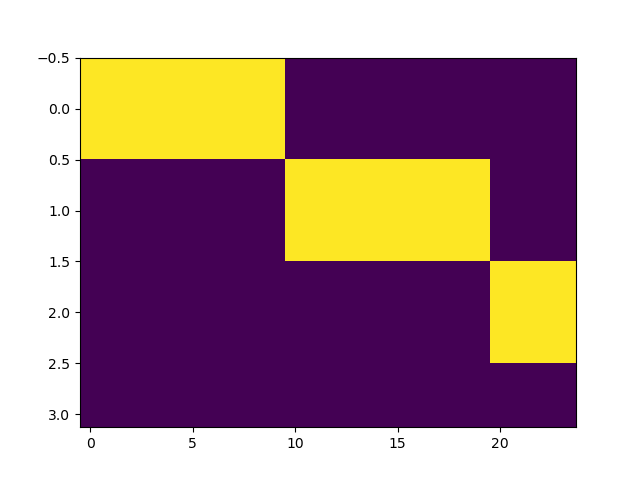

In [907]:
fig,ax = plt.subplots()
ax.imshow(arr_temps, aspect='auto')

<IPython.core.display.Javascript object>


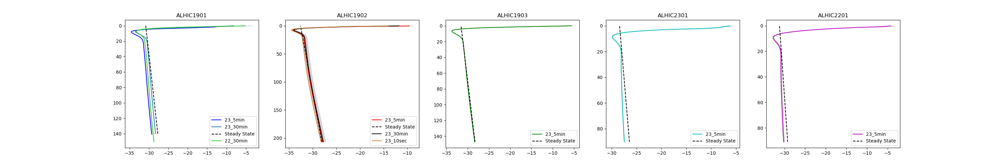

<IPython.core.display.Javascript object>


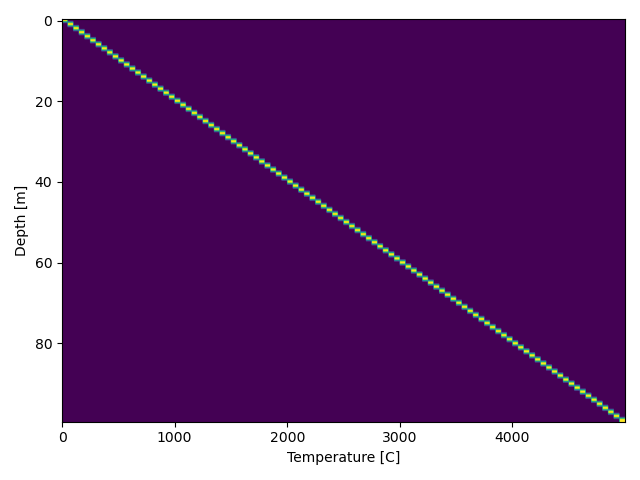

ALHIC1901_23_5min
ALHIC1903_23_5min
Running model to steady state
..
No velocity arrays set, setting to constant value.
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0021720876800685016
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
ALHIC2201_23_5min
Running model to steady state
..
No velocity arrays set, setting to constant value.
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ;

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1963 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1983 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2003 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 2023 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1923 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0013869171781676003
t = 1943 ; dt = 0.020004000800160012 ; melt rate = 0.0 ; melt cu

In [947]:
scale_offset = 0

tmin, tmax = 1923, 2023
t_steps = 100 #years
num_steps = 5000
nz=21

year = np.linspace(tmin,tmax, num_steps)

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
ax_list = (ax1, ax2, ax3, ax4, ax5)

counter2 = 0
counter3 = 0
counter4 = 0
counter5 = 0



temp_input = np.zeros((t_steps,num_steps))

step_func_len = int(num_steps / t_steps) #please make this a whole number
for i in range(t_steps):
    start = i*step_func_len
    end = (i*step_func_len) + step_func_len
    temp_input[i,start:end] = 1

fig,ax = plt.subplots()
ax.imshow(temp_input, aspect='auto')


for off, (i, c) in enumerate(zip(data, colors)):
    print(i)
    x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]
    
    y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw

    if i == 'ALHIC1901_23_30min':
        mean = y
        ax1.plot(mean + (off *scale_offset),x, label=i[10:])
        
        #Model run
        
        H=x.values[-1] #ice thickness
        
        #pick the surface temperature by the linear trend
        m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
        Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
        Ts = Ts_all[0].values
        
        
        # Instantiate the model class
        m = ice_temperature(
            Ts=Ts,
            adot=adot,
            H=H,
            qgeo=qgeo,
            p=1000.,
            dS=10,
            nz=nz)


        # Set the time step to 5 years and subsample the paleoclimate data to match
        m.ts = year*const.spy
        m.adot_s = np.asarray([adot]*len(year))/const.spy


        # Set velocity terms
        m.Udef=0.
        m.Uslide=0.2/const.spy

        # Longitudinal advection forcing

        m.dTs = 0
        m.dH = 0.3
        m.da = 0.
        m.flags.append('long_advection')

        # Thermal conductivity should be temperature and density dependent; set here
        m.flags.append('temp-dependent')
        m.initial_conditions()


        # Initialize the model to steady state

        m.source_terms()
        m.stencil()
        m.numerical_to_steady_state()
        ax1.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')

        AH1901_arr = np.zeros((nz, len(year)))
        
        for k, surface_temp in enumerate(temp_input):
    
            # Run the model

            m.Ts_s = surface_temp+Ts
            m.flags.append('save_all')
            m.numerical_transient()
            AH1901_arr[:,k] = m.T
        
    elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        
        
        ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
#         H=x[-1] #ice thickness
#         # Initialize the model class
#         m = ice_temperature(nz=nz,
#                            Ts = Ts,
#                            H = H,
#                            adot = adot,
#                            qgeo = qgeo)
#         m.initial_conditions()
#         m.source_terms()
#         m.stencil(dt=1.*const.spy)
#         TR,Mrate = Robin_T(m)
#         m.numerical_to_steady_state()
        
#         ax1.plot(m.T[::-1],m.z,'--',c='indianred',label='Steady State Numerical Solution')
#         ax1.plot(TR[::-1],m.z,'--',c='white',label='Steady State Numerical Solution')
        
#             ax.plot(y,x)

    elif i[0:9] == 'ALHIC1902':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter2 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values



            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0,
                nz=nz)


            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year*const.spy
            m.adot_s = np.asarray([adot]*len(year))/const.spy

            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax2.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            AH1902_arr = np.zeros((nz, len(year)))
        
            for k, surface_temp in enumerate(temp_input):

                # Run the model

                m.Ts_s = surface_temp+Ts
                m.flags.append('save_all')
                m.numerical_transient()
                AH1902_arr[:,k] = m.T
            counter2 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC1903':
        
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        if counter3 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values



            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=15,
                nz=nz)


            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year*const.spy
            m.adot_s = np.asarray([adot]*len(year))/const.spy


            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.1
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax3.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            AH1903_arr = np.zeros((nz, len(year)))
        
            for k, surface_temp in enumerate(temp_input):

                # Run the model

                m.Ts_s = surface_temp+Ts
                m.flags.append('save_all')
                m.numerical_transient()
                AH1903_arr[:,k] = m.T
            counter3+=1
            #             ax.plot(y,x)

    elif i[0:9] == 'ALHIC2301':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 


        ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
        ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
        
        if counter4 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values

            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0,
                nz=nz)




            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year*const.spy
            m.adot_s = np.asarray([adot]*len(year))/const.spy


            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax4.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            
            AH2301_arr = np.zeros((nz, len(year)))
        
            for k, surface_temp in enumerate(temp_input):

                # Run the model

                m.Ts_s = surface_temp+Ts
                m.flags.append('save_all')
                m.numerical_transient()
                AH2301_arr[:,k] = m.T
            counter4 += 1
#             ax.plot(y,x)
    elif i[0:9] == 'ALHIC2201':
        mean = np.mean(y, axis=1)
        ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
              loc=mean, 
              scale=st.sem(y, axis=1)) 
        if counter5 == 0:
            H=x.values[-1] #ice thickness
            
            #pick the surface temperature by the linear trend
            m,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(m)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            Ts = Ts_all[0].values
            
            ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')


            # Instantiate the model class
            m = ice_temperature(
                Ts=Ts,
                adot=adot,
                H=H,
                qgeo=qgeo,
                p=1000.,
                dS=0,
                nz=nz)



            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year*const.spy
            m.adot_s = np.asarray([adot]*len(year))/const.spy


            # Set velocity terms
            m.Udef=0.
            m.Uslide=0.2/const.spy

            # Longitudinal advection forcing

            m.dTs = 0
            m.dH = 0.4
            m.da = 0.
            m.flags.append('long_advection')

            # Thermal conductivity should be temperature and density dependent; set here
            m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            m.source_terms()
            m.stencil()
            m.numerical_to_steady_state()
            ax5.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
            # Run the model
            AH2201_arr = np.zeros((nz, len(year)))
        
            for k, surface_temp in enumerate(temp_input):

                # Run the model

                m.Ts_s = surface_temp+Ts
                m.flags.append('save_all')
                m.numerical_transient()
                AH2201_arr[:,k] = m.T


            counter5 += 1
            #             ax.plot(y,x)

boreholes_name = [
    'ALHIC1901',
    'ALHIC1902',
    'ALHIC1903',
    'ALHIC2301',
    'ALHIC2201',
]
for k, title in zip(ax_list, boreholes_name):
    k.legend()
    k.invert_yaxis()
    k.set_title(title)
plt.ylabel('Depth [m]')
plt.xlabel('Temperature [C]')
plt.tight_layout()

<IPython.core.display.Javascript object>


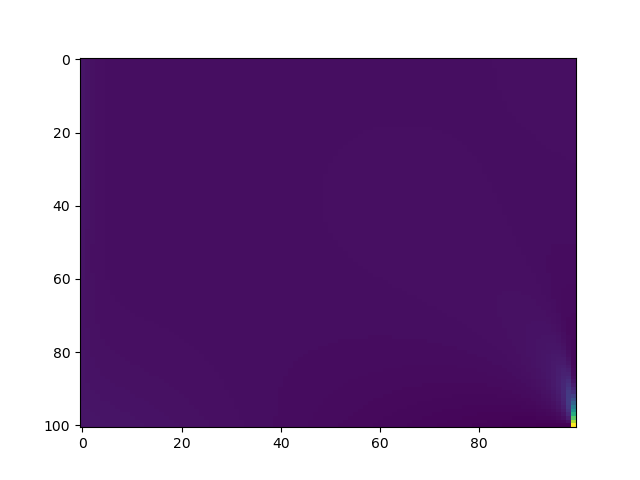

In [918]:


fig, ax = plt.subplots()
ax.imshow(detrend(AH1901_arr[:,:100]), aspect='auto')

<IPython.core.display.Javascript object>


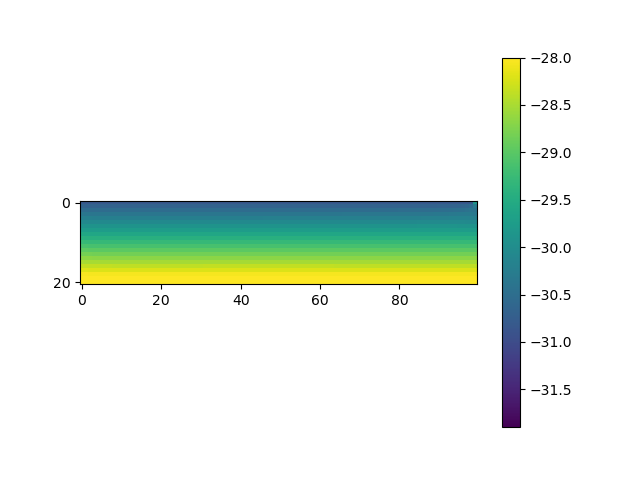

In [975]:
fig, ax = plt.subplots()

im = ax.imshow(AH1901_arr[:,:100][::-1], vmin=-28,vmax=-29)

fig.colorbar(im, ax=ax, orientation='vertical')

In [949]:
borehole_greens = {
    'AH1901': AH1901_arr[:,:100][::-1],
    'AH1902': AH1902_arr[:,:100][::-1],
    'AH1903': AH1903_arr[:,:100][::-1],
    'AH2201': AH2201_arr[:,:100][::-1],
    'AH2301': AH2301_arr[:,:100][::-1],
}

In [951]:
for i in borehole_greens:
    print(borehole_greens[i])

[[-30.83200795 -30.83200795 -30.83200795 ... -30.83200795 -30.83200795
  -29.83200795]
 [-30.67413261 -30.67478029 -30.67518374 ... -30.60024569 -30.52907394
  -30.27488077]
 [-30.51689869 -30.51818693 -30.51898984 ... -30.42760946 -30.39256308
  -30.41079563]
 ...
 [-28.03318018 -28.04101604 -28.04604594 ... -28.05500777 -28.05497453
  -28.0549415 ]
 [-27.8761898  -27.88409455 -27.88917156 ... -27.89821211 -27.8981794
  -27.89814694]
 [-27.71851601 -27.72644375 -27.7315365  ... -27.74060331 -27.74057079
  -27.74053852]]
[[-32.60169816 -32.60169816 -32.60169816 ... -32.60169816 -32.60169816
  -31.60169816]
 [-32.37144615 -32.37417237 -32.37640869 ... -32.29786761 -32.24683056
  -32.14417551]
 [-32.14261573 -32.14803814 -32.15248455 ... -32.10771474 -32.10829473
  -32.13688565]
 ...
 [-28.57600257 -28.61032513 -28.63794135 ... -28.75412353 -28.75411953
  -28.75411576]
 [-28.3513528  -28.38600516 -28.41387658 ... -28.53111256 -28.53110959
  -28.53110684]
 [-28.12543257 -28.16019517 -28.1

# Ok now that we have the greens functions, can we do the inversions?

<IPython.core.display.Javascript object>


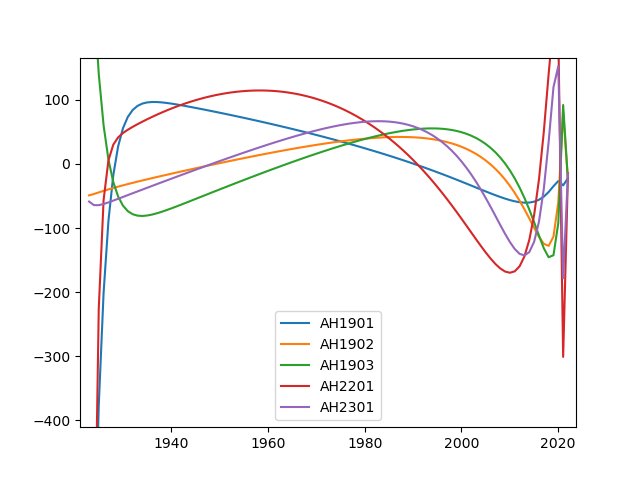

In [960]:
fig, ax =plt.subplots()

for i in borehole_greens:
    if i == 'AH1901':
        j = 'ALHIC1901_23_5min'
        y = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).x
        H = x.values[-1]
    elif i == 'AH1902':
        j = 'ALHIC1902_23_5min'
        y = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).x
        H = x.values[-1]
    elif i == 'AH1903':
        j = 'ALHIC1903_23_5min'
        y = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).x
        H = x.values[-1]
    
    elif i == 'AH2201':
        j = 'ALHIC2201_23_5min'
        y = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).x
        H = x.values[-1]
    
    elif i == 'AH2301':
        j = 'ALHIC2301_23_5min'
        y = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(borehole_geometries[j][0],borehole_geometries[j][1])).x
        H = x.values[-1]
        
    greens = borehole_greens[i]

    u, s, v_T = np.linalg.svd(detrend(greens, axis=1), full_matrices=True)


    u_p = u[:,:p]
    s_p = np.diag(s[:p])
    vh_p = v_T.T[:,:p]

    #Now finding the generalized G matrix

    g_gen = u_p @ s_p @ vh_p.T
    # print('G = \n', g_gen)

    #And the inverse Gen G matrix

    u_p_transpose = u_p.T
    s_p_inv = np.linalg.inv(s_p)

    g_inv = vh_p @ s_p_inv @ u_p_transpose
                #model estimates
    
    mean = np.mean(y, axis=1)
    mean_resamp = scipy.signal.resample(mean,greens.shape[0])
    m_est = g_inv @ mean_resamp
    
    ax.plot(year[::50],m_est, label=i)
    plt.legend()

<IPython.core.display.Javascript object>


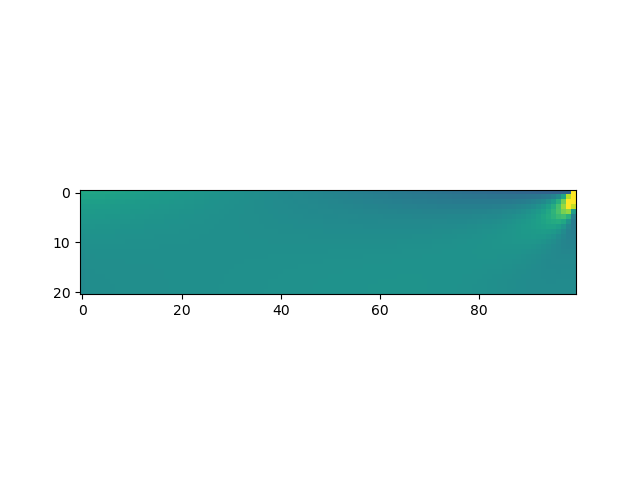

In [966]:
fig, ax = plt.subplots()
ax.imshow(detrend(greens, axis=1),vmin=-.1,vmax=.1)


In [998]:
AH1901_arr.shape

(21, 5000)

In [977]:
### Can we do this a better way? Maybe create a function? ###

In [1244]:


def greens_generator(tmin=1923,
                     tmax=2023,
                     t_steps=100,
                     num_steps=5000,
                     nz=21,
                     tol=1e-2,
                     include_mechanics=False,
                     step_function_input=False,
                     start_at_zero=False):
    
    year = np.linspace(tmin,tmax, num_steps)

    colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'peru', 'limegreen']
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize=[30,5])
    ax_list = (ax1, ax2, ax3, ax4, ax5)

    counter2 = 0
    counter3 = 0
    counter4 = 0
    counter5 = 0


    adot=-0.01 #Accumulation rate (m/yr)

    
    step_func_len = num_steps / t_steps #please make this a whole number

    if step_function_input == True:
        temp_input = np.zeros((t_steps,num_steps))
        if step_func_len != int(step_func_len):
            raise Exception('num_steps divided by t_steps needs to be an integer!')
    
        for i in range(t_steps):
            start = i*step_func_len
            end = (i*step_func_len) + step_func_len
            temp_input[i,start:end] = 1
            
    if step_function_input == False:
        temp_input = np.eye(num_steps)
    
    times = np.linspace(tmin, tmax, num_steps)
    depths = {}
    
    fig,ax = plt.subplots()
    ax.imshow(temp_input, aspect='auto')


    for off, (i, c) in enumerate(zip(data, colors)):
        print(i)
        x = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x - borehole_geometries[i][0]

        y = data_matching_sections[i].sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).tmpw
        
        if i == 'ALHIC1901_23_30min':
            mean = y
            ax1.plot(mean + (off *scale_offset),x, label=i[10:])

            #Model run

            H=x.values[-1] #ice thickness
            depths['ALHIC1901'] = np.linspace(0,H, nz)
            
            #pick the surface temperature by the linear trend
            slope,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
            Ts_all  = np.mean(slope)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
            qgeo = np.mean(slope)*2

            
            
            if start_at_zero == False:
                Ts = Ts_all[0].values
                
                print('Geothermal flux (slope) = '+str(qgeo))
                print('intercept = '+str(b))
                print('Ts = ' + str(Ts))
                
                # Instantiate the model class
                m = ice_temperature(
                    Ts=Ts,
                    adot=adot,
                    H=H,
                    qgeo=qgeo,
                    p=1000.,
                    dS=10,
                    nz=nz,
                    tol=tol)
            if start_at_zero == True:
                Ts = 0.
                # Instantiate the model class
                m = ice_temperature(
                    Ts=Ts,
                    adot = 0.,
                    H=H,
                    p=1000.,
                    nz=nz,
                    tol=tol)
            # Set the time step to 5 years and subsample the paleoclimate data to match
            m.ts = year*const.spy
            m.adot_s = np.asarray([adot]*len(year))/const.spy

            if include_mechanics == True:
                # Set velocity terms
                m.Udef=0.
                m.Uslide=0.2/const.spy

                # Longitudinal advection forcing

                m.dTs = 0
                m.dH = 0.3
                m.da = 0.
                m.flags.append('long_advection')

                # Thermal conductivity should be temperature and density dependent; set here
                m.flags.append('temp-dependent')
            m.initial_conditions()


            # Initialize the model to steady state
            
            m.source_terms()
            m.stencil()

            m.numerical_to_steady_state()
            
            if np.isnan(m.T).any():
                raise Exception('NaN introduced during steady state. Check nz and timesteps.')

            ax1.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')

            AH1901_arr = np.zeros((nz, len(temp_input)))

            for k, surface_temp in enumerate(temp_input):

                # Run the model
                m.Ts_s = surface_temp+Ts
                m.flags.append('save_all')
                m.numerical_transient()
                AH1901_arr[:,k] = m.T
                if np.isnan(m.T).any():
                    raise Exception('NaN introduced during forward model. Check nz and timesteps.')
        elif i[0:9] == 'ALHIC1901' and i != 'ALHIC1901_23_30min':
            mean = np.mean(y, axis=1)
            ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
                  loc=mean, 
                  scale=st.sem(y, axis=1)) 


            ax1.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax1.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')


        elif i[0:9] == 'ALHIC1902':
            mean = np.mean(y, axis=1)
            ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
                  loc=mean, 
                  scale=st.sem(y, axis=1)) 


            ax2.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax2.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            if counter2 == 0:
                H=x.values[-1] #ice thickness
                depths['ALHIC1902'] = np.linspace(0,H, nz)
                #pick the surface temperature by the linear trend
                slope,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
                Ts_all  = np.mean(slope)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
                qgeo = np.mean(slope)*2


                if start_at_zero == False:
                    
                    Ts = Ts_all[0].values
                    

                    print('Geothermal flux (slope) = '+str(qgeo))
                    print('intercept = '+str(b))
                    print('Ts = ' + str(Ts))
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=adot,
                        H=H,
                        qgeo=qgeo,
                        p=1000.,
                        dS=0,
                        nz=nz,
                        tol=tol)

                if start_at_zero == True:
                    
                    Ts = 0.
                     # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=adot,
                        H=H,
                        qgeo=qgeo,
                        p=1000.,
                        dS=0,
                        nz=nz,
                        tol=tol)

                # Set the time step to 5 years and subsample the paleoclimate data to match
                m.ts = year*const.spy
                m.adot_s = np.asarray([adot]*len(year))/const.spy
                if include_mechanics == True:
                    
                    # Set velocity terms
                    m.Udef=0.
                    m.Uslide=0.2/const.spy

                    # Longitudinal advection forcing

                    m.dTs = 0
                    m.dH = 0.4
                    m.da = 0.
                    m.flags.append('long_advection')

                    # Thermal conductivity should be temperature and density dependent; set here
                    m.flags.append('temp-dependent')
                m.initial_conditions()


                # Initialize the model to steady state
                m.source_terms()
                m.stencil()

                m.numerical_to_steady_state()
                
                if np.isnan(m.T).any():
                    raise Exception('NaN introduced during steady state. Check nz and timesteps.')

                ax2.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
                # Run the model
                AH1902_arr = np.zeros((nz, len(temp_input)))

                for k, surface_temp in enumerate(temp_input):

                    # Run the model

                    m.Ts_s = surface_temp+Ts
                    m.flags.append('save_all')
                    m.numerical_transient()
                    AH1902_arr[:,k] = m.T
                    
                    if np.isnan(m.T).any():
                        raise Exception('NaN introduced during forward model. Check nz and timesteps.')
                counter2 += 1
    #             ax.plot(y,x)
        elif i[0:9] == 'ALHIC1903':

            mean = np.mean(y, axis=1)
            ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
                  loc=mean, 
                  scale=st.sem(y, axis=1)) 


            ax3.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax3.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            if counter3 == 0:
                H=x.values[-1] #ice thickness
                depths['ALHIC1903'] = np.linspace(0,H, nz)
                #pick the surface temperature by the linear trend
                slope,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, 
                                     y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 
                                     1)
                Ts_all  = np.mean(slope)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
                qgeo = np.mean(slope)*2

                if start_at_zero == False:
                    
                    Ts = Ts_all[0].values
                    

                    print('Geothermal flux (slope) = '+str(qgeo))
                    print('intercept = '+str(b))
                    print('Ts = ' + str(Ts))
                    
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=adot,
                        H=H,
                        qgeo=qgeo,
                        p=1000.,
                        dS=15,
                        nz=nz,
                        tol=tol)
                
                if start_at_zero == True:
                    
                    Ts = 0.
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=0.,
                        H=H,
                        qgeo=0.,
                        p=1000.,
                        dS=0.,
                        nz=nz,
                        tol=tol)
                # Set the time step to 5 years and subsample the paleoclimate data to match
                m.ts = year*const.spy
                m.adot_s = np.asarray([adot]*len(year))/const.spy

                if include_mechanics == True:

                    # Set velocity terms
                    m.Udef=0.
                    m.Uslide=0.2/const.spy

                    # Longitudinal advection forcing

                    m.dTs = 0
                    m.dH = 0.1
                    m.da = 0.
                    m.flags.append('long_advection')

                    # Thermal conductivity should be temperature and density dependent; set here
                    m.flags.append('temp-dependent')
                m.initial_conditions()


                # Initialize the model to steady state
                m.source_terms()
                m.stencil()
                

                m.numerical_to_steady_state()
                
                if np.isnan(m.T).any():
                    raise Exception('NaN introduced during steady state. Check nz and timesteps.')

                ax3.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
                # Run the model
                AH1903_arr = np.zeros((nz, len(temp_input)))

                for k, surface_temp in enumerate(temp_input):

                    # Run the model

                    m.Ts_s = surface_temp+Ts
                    m.flags.append('save_all')
                    m.numerical_transient()
                    AH1903_arr[:,k] = m.T
                    
                    if np.isnan(m.T).any():
                        raise Exception('NaN introduced during forward model. Check nz and timesteps.')
                        
                counter3+=1
                #             ax.plot(y,x)

        elif i[0:9] == 'ALHIC2301':
            mean = np.mean(y, axis=1)
            ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
                  loc=mean, 
                  scale=st.sem(y, axis=1)) 


            ax4.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
            ax4.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')

            if counter4 == 0:
                H=x.values[-1] #ice thickness
                depths['ALHIC2301'] = np.linspace(0,H, nz)
                #pick the surface temperature by the linear trend
                slope,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
                Ts_all  = np.mean(slope)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
                qgeo = np.mean(slope)*2

                
                
                if start_at_zero == False:
                    Ts = Ts_all[0].values 
                    
                    print('Geothermal flux (slope) = '+str(qgeo))
                    print('intercept = '+str(b))
                    print('Ts = ' + str(Ts))
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=adot,
                        H=H,
                        qgeo=qgeo,
                        p=1000.,
                        dS=0,
                        nz=nz,
                        tol=tol)
                if start_at_zero == True:
                    
                    Ts = 0.
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=0.,
                        H=H,
                        qgeo=0.,
                        p=1000.,
                        dS=0.,
                        nz=nz,
                        tol=tol)

                # Set the time step to 5 years and subsample the paleoclimate data to match
                m.ts = year*const.spy
                m.adot_s = np.asarray([adot]*len(year))/const.spy
                
                if include_mechanics == True:

                    # Set velocity terms
                    m.Udef=0.
                    m.Uslide=0.2/const.spy

                    # Longitudinal advection forcing

                    m.dTs = 0
                    m.dH = 0.
                    m.da = 0.
                    m.flags.append('long_advection')

                    # Thermal conductivity should be temperature and density dependent; set here
                    m.flags.append('temp-dependent')
                m.initial_conditions()


                # Initialize the model to steady state
                m.source_terms()
                m.stencil()

                m.numerical_to_steady_state()
                
                if np.isnan(m.T).any():
                    raise Exception('NaN introduced during steady state. Check nz and timesteps.')

                ax4.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')

                AH2301_arr = np.zeros((nz, len(temp_input)))

                for k, surface_temp in enumerate(temp_input):

                    # Run the model

                    m.Ts_s = surface_temp+Ts
                    m.flags.append('save_all')
                    m.numerical_transient()
                    AH2301_arr[:,k] = m.T
                    
                    if np.isnan(m.T).any():
                        raise Exception('NaN introduced during forward model. Check nz and timesteps.')
                        
                counter4 += 1
    #             ax.plot(y,x)
        elif i[0:9] == 'ALHIC2201':
            mean = np.mean(y, axis=1)
            ci95, ci05 = st.t.interval(alpha=0.95, df=len(data[i])-1, 
                  loc=mean, 
                  scale=st.sem(y, axis=1)) 
            if counter5 == 0:
                H=x.values[-1] #ice thickness
                depths['ALHIC2201'] = np.linspace(0,H, nz)
                #pick the surface temperature by the linear trend
                slope,b = np.polyfit(y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])).x, y.sel(x=slice(below_seasonal[i][0],borehole_geometries[i][1])), 1)
                Ts_all  = np.mean(slope)*y.sel(x=slice(borehole_geometries[i][0],borehole_geometries[i][1])).x + np.mean(b)
                qgeo = np.mean(slope)*2

                ax5.plot(mean + (off *scale_offset),x, label=i[10:], color=c)
                ax5.fill_betweenx(x,ci05+ (off *scale_offset), ci95+ (off *scale_offset), color='lightgrey')
            
                if start_at_zero == False:
                    Ts = Ts_all[0].values
                    

                    print('Geothermal flux (slope) = '+str(qgeo))
                    print('intercept = '+str(b))
                    print('Ts = ' + str(Ts))
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=adot,
                        H=H,
                        qgeo=qgeo,
                        p=1000.,
                        dS=0,
                        nz=nz,
                        tol=tol)
                if start_at_zero == True:
                    Ts = 0.
                    # Instantiate the model class
                    m = ice_temperature(
                        Ts=Ts,
                        adot=0.,
                        H=H,
                        qgeo=0.,
                        p=1000.,
                        dS=0.,
                        nz=nz,
                        tol=tol)

                # Set the time step to 5 years and subsample the paleoclimate data to match
                m.ts = year*const.spy
                m.adot_s = np.asarray([adot]*len(year))/const.spy

                if include_mechanics == True:
                    
                    # Set velocity terms
                    m.Udef=0.
                    m.Uslide=0.2/const.spy

                    # Longitudinal advection forcing

                    m.dTs = 0
                    m.dH = 0.4
                    m.da = 0.
                    m.flags.append('long_advection')

                    # Thermal conductivity should be temperature and density dependent; set here
                    m.flags.append('temp-dependent')
                m.initial_conditions()


                # Initialize the model to steady state
                m.source_terms()
                m.stencil()

                m.numerical_to_steady_state()

                if np.isnan(m.T).any():
                    raise Exception('NaN introduced during steady state. Check nz and timesteps.')

                ax5.plot(m.T,(m.z-m.H)*-1,c='black',label='Steady State', ls='--')
                # Run the model
                AH2201_arr = np.zeros((nz, len(temp_input)))

                for k, surface_temp in enumerate(temp_input):

                    # Run the model

                    m.Ts_s = surface_temp+Ts
                    m.flags.append('save_all')
                    m.numerical_transient()
                    AH2201_arr[:,k] = m.T
                    if np.isnan(m.T).any():
                        raise Exception('NaN introduced during forward model. Check nz and timesteps.')
                        
                counter5 += 1
                #             ax.plot(y,x)
                
    borehole_greens = {
        'ALHIC1901': AH1901_arr[::-1],
        'ALHIC1902': AH1902_arr[::-1],
        'ALHIC1903': AH1903_arr[::-1],
        'ALHIC2201': AH2201_arr[::-1],
        'ALHIC2301': AH2301_arr[::-1],
    }
    
    return borehole_greens, times, depths

<IPython.core.display.Javascript object>


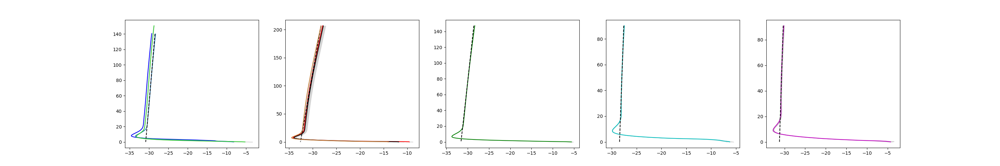

<IPython.core.display.Javascript object>


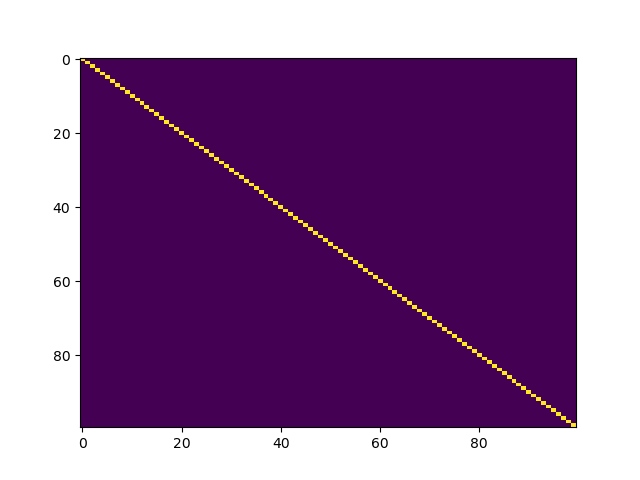

ALHIC1901_23_5min
ALHIC1903_23_5min
Geothermal flux (slope) = 0.04269653732850636
intercept = [-35.34820337 -35.16763783 -35.10019921 -35.08561658 -35.07617243
 -35.03679502 -35.07566819 -34.9863639  -35.01386795 -35.02230236
 -35.05790322 -35.02130084 -35.02115661 -35.02592724 -35.05417314
 -35.02610395 -35.09240335 -35.1496222  -35.0836736  -35.10177815
 -35.1094757  -35.08661265 -35.03126235 -35.06156434 -35.10864462
 -35.02642501 -35.08666902 -35.06809532 -35.01439743 -35.05246293
 -35.10397927]
Ts = -31.57642164106704
Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0

t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

Geothermal flux (slope) = 0.04353796879952172
intercept = [-35.20156792 -35.00114213 -34.93164377 -34.82164195 -34.72544609
 -34.69536846 -34.69828813]
Ts = -32.601698162128066
Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0

t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

Geothermal flux (slope) = 0.01951233711204274
intercept = [-30.75978032 -30.76328907 -30.6469264  -30.57603784 -30.58712414
 -30.5488441  -30.53214169 -30.57941419 -30.49824817 -30.56315858
 -30.45415433 -30.47166777 -30.53111639]
Ts = -28.423891308609754
Running model to steady state
.
No velocity arrays set, setting to constant value.
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; 

t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 2023 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b =  0.0
t = 1923 ; dt = 1.0101010101010093 ; melt rate = 0.0 ; melt cum =  0.0 ; q_b

In [1245]:
tmin=1923
tmax=2023
t_steps = tmax - tmin
num_steps = 100
nz=11

borehole_greens,times, depths = greens_generator(tmin=tmin,
                                                 tmax=tmax,
                                                 t_steps=t_steps,
                                                 num_steps=num_steps,
                                                 nz=nz,
                                                 include_mechanics=False,
                                                 step_function_input=False,
                                                 start_at_zero=False)

<IPython.core.display.Javascript object>


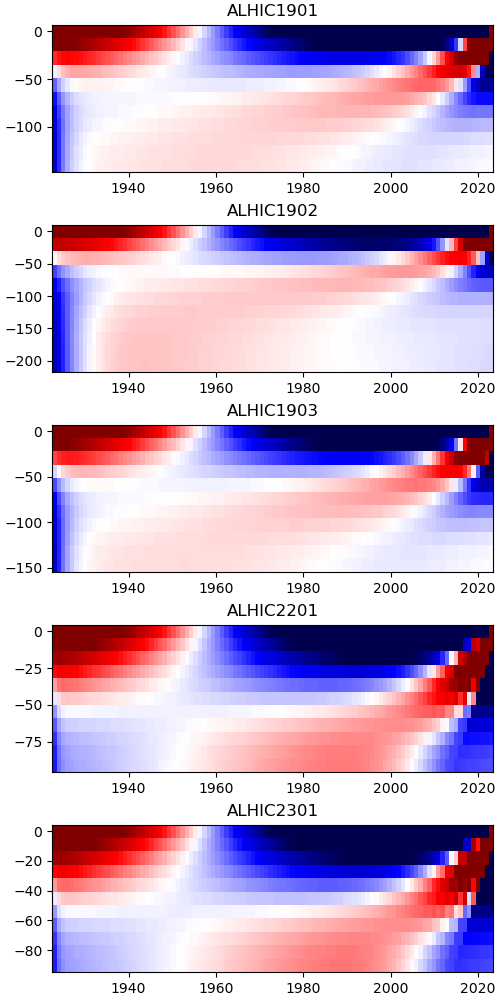

In [1246]:
fig, (ax1, ax2, ax3,ax4 ,ax5) = plt.subplots(5,1, figsize=[5,10], constrained_layout=True)
axlist = (ax1, ax2, ax3,ax4 ,ax5)
for i,ax in zip(borehole_greens, axlist):
    greens = borehole_greens[i]
    times =times
    z = depths[i]

    mesh = ax.pcolormesh(times,z*-1,detrend(greens, axis=1),vmin=-.01,vmax=.01, cmap='seismic')
    #mesh = ax.pcolormesh(times,z*-1,greens, cmap='seismic')
    ax.set_title(i)
    
#fig.colorbar(mesh, ax=[ax1, ax2, ax3, ax4, ax5])


<IPython.core.display.Javascript object>


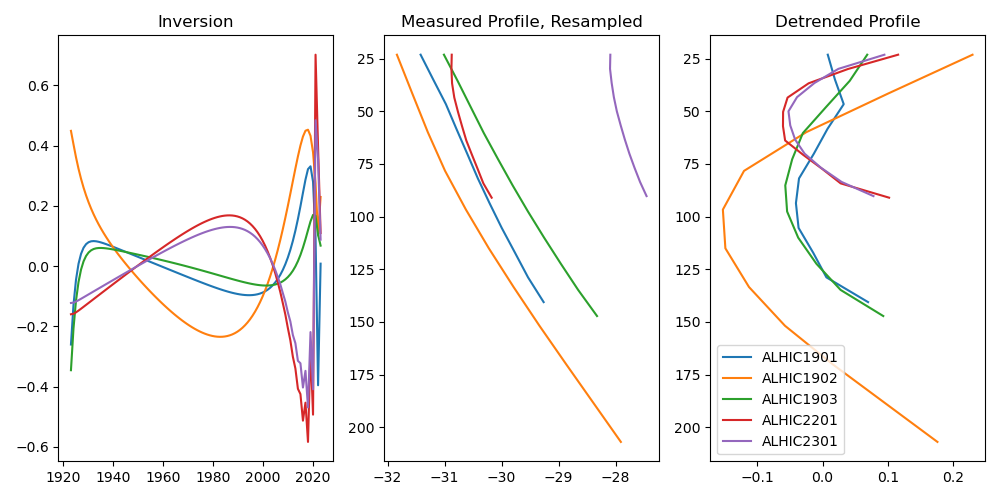

In [1247]:
fig, (ax1, ax2, ax3) =plt.subplots(1,3, figsize=[10,5])
p=4
add= 0
for i in borehole_greens:
    if i == 'ALHIC1901':
        j = 'ALHIC1901_23_5min'
        y = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).x
        H = x.values[-1]
    elif i == 'ALHIC1902':
        j = 'ALHIC1902_23_5min'
        y = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).x
        H = x.values[-1]
    elif i == 'ALHIC1903':
        j = 'ALHIC1903_23_5min'
        y = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).x
        H = x.values[-1]
    
    elif i == 'ALHIC2201':
        j = 'ALHIC2201_23_5min'
        y = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).x
        H = x.values[-1]
    
    elif i == 'ALHIC2301':
        j = 'ALHIC2301_23_5min'
        y = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).tmpw
        x = data_matching_sections[j].sel(x=slice(below_seasonal[j][0]+add,borehole_geometries[j][1])).x
        H = x.values[-1]
        
    greens = borehole_greens[i]

    u, s, v_T = np.linalg.svd(detrend(greens), full_matrices=True)


    u_p = u[:,:p]
    s_p = np.diag(s[:p])
    vh_p = v_T.T[:,:p]

    #Now finding the generalized G matrix

    g_gen = u_p @ s_p @ vh_p.T
    # print('G = \n', g_gen)

    #And the inverse Gen G matrix

    u_p_transpose = u_p.T
    s_p_inv = np.linalg.inv(s_p)

    g_inv = vh_p @ s_p_inv @ u_p_transpose
                #model estimates
    
    top = borehole_geometries[j][0]

    mean = np.mean(y, axis=1)
    
    #Resample by 
    #mean_resamp = scipy.signal.resample(mean,greens.shape[0],window=10)
    f = scipy.interpolate.interp1d(x, mean)
    resamp_x = np.linspace(x.values[0], H, nz)
    y_resamp = f(resamp_x)
    detrended = detrend(y_resamp)
    m_est = g_inv @ detrended
    
    ax1.plot(times, m_est, label=i)
    ax2.plot(y_resamp, resamp_x - top,label=i)
    ax3.plot(detrended, resamp_x-top, label=i)
    
    ax1.set_title('Inversion')
    ax2.set_title('Measured Profile, Resampled')
    ax3.set_title('Detrended Profile')
    ax3.invert_yaxis()
    ax2.invert_yaxis()
    
    plt.tight_layout()
    plt.legend()

scipy.interpolate.interpolate.interp1d